In [1]:
import numpy as np
import pandas as pd
import os
import torch
import matplotlib.pyplot as plt
import torch.nn.functional as F
import torch.nn as nn
import torchvision
from torchvision import transforms
from PIL import Image
import gzip
%matplotlib inline

In [2]:
# 加载数据
def load_data(data_file):
    files = ['train-labels-idx1-ubyte.gz', 'train-images-idx3-ubyte.gz', 't10k-labels-idx1-ubyte.gz', 't10k-images-idx3-ubyte.gz']
    paths = []
    for fileName in files:
        paths.append(os.path.join(data_file, fileName))
        
    # 读取每个文件夹的数据    
    with gzip.open(paths[0], 'rb') as train_labels_path:   # rb 以2进制格式打开
        train_labels = np.frombuffer(train_labels_path.read(), np.uint8, offset=8)
      
    with gzip.open(paths[1], 'rb') as train_images_path:
        train_images = np.frombuffer(train_images_path.read(), np.uint8, offset=16).reshape(len(train_labels), 784)
       
    with gzip.open(paths[2], 'rb') as test_labels_path:
        test_labels = np.frombuffer(test_labels_path.read(), np.uint8, offset=8)
        
    with gzip.open(paths[3], 'rb') as test_images_path:
        test_images = np.frombuffer(test_images_path.read(), np.uint8, offset=16).reshape(len(test_labels), 784)
        
    return train_labels,train_images,test_labels,test_images
 
train_labels,train_images,test_labels,test_images = load_data('C:\\Users\\Fan\\JupyterFile\\data\\MNIST\\raw\\')
print(train_labels.shape)
print(train_images.shape)
print(test_labels.shape)
print(test_images.shape)

# 创建加载器
class ImageDataset(torch.utils.data.Dataset):
    def __init__(self, images, labels, transform=None):
        self.images = images
        self.labels = labels
        self.transform = transform
        
    def __len__(self):
        return len(self.images)
        
    def __getitem__(self, idx):
        image = self.images[idx].reshape(28,28)
        if self.transform:
            image = self.transform(image)
        label = self.labels[idx]
        #label = 1 if self.labels[idx] >=5 else 0
        return image,label
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

batch_size = 100

train_dataset = ImageDataset(images = train_images, labels = train_labels, transform = transform)
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_dataset = ImageDataset(images = test_images, labels = test_labels, transform = transform)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=True)

(60000,)
(60000, 784)
(10000,)
(10000, 784)


In [3]:
def show_image(tensor):
    tensor=torch.clamp(tensor,0,1)
    tensor = tensor.detach().squeeze().numpy()
    plt.imshow(tensor)
    plt.axis('off')  # 关闭坐标轴
    plt.show()
def show_images_all(imgs):
    n = imgs.size(0)  # 获取图片数量
    rows = int(np.sqrt(n))  # 确定方形图中行数和列数
    cols = n // rows
    
    # 创建一个新的图像
    fig, axs = plt.subplots(rows, cols, figsize=(8, 8))
    axs = axs.flatten()
    
    for i in range(n):
        img = imgs[i].detach().numpy()
        axs[i].imshow(img, cmap='gray')
        axs[i].axis('off')  # 关闭坐标轴
    
    plt.tight_layout()
    plt.show()

In [4]:
# 模型定义
# 初始化权重函数
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:   # 没有则返回-1，有则返回0
        nn.init.normal_(m.weight.data, 0.0, 0.02)    # 使用正态分布初始化权重数据，均值0，标准差0.02
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)    # 使用正态分布初始化权重数据，均值1，标准差0.02
        nn.init.constant_(m.bias.data, 0)     # 使用常数初始化偏置项数据
        
# 生成器
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(100,256)
        self.fc2 = nn.Linear(256,512)
        self.fc3 = nn.Linear(512,1024)
        self.fc4 = nn.Linear(1024,784)
        self.drop = nn.Dropout2d(p=0.3)

    def forward(self, x):
        x = nn.functional.leaky_relu(self.fc1(x))
        x = nn.functional.leaky_relu(self.fc2(x))
        x = nn.functional.leaky_relu(self.fc3(x))
        x = self.fc4(x)
        x = torch.tanh(x)
        
        return x.view(-1,28,28)

# 判别器
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.fc1 = nn.Linear(784,1024)
        self.fc2 = nn.Linear(1024,512)
        self.fc3 = nn.Linear(512,256)
        self.fc4 = nn.Linear(256,1)
        self.drop = nn.Dropout2d(p=0.3)

    def forward(self, x):
        x = x.view(-1, 28 * 28)
        x = nn.functional.leaky_relu(self.fc1(x))
        x = self.drop(x)
        x = nn.functional.leaky_relu(self.fc2(x))
        x = self.drop(x)
        x = nn.functional.leaky_relu(self.fc3(x))
        x = self.drop(x)
        x = torch.sigmoid(self.fc4(x))
        
        return x


E:\anaconda3\lib\site-packages\torchvision\transforms\functional.py:149: UserWarning: The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\torch\csrc\utils\tensor_numpy.cpp:205.)
  img = torch.from_numpy(pic.transpose((2, 0, 1))).contiguous()
E:\anaconda3\lib\site-packages\torch\nn\functional.py:1331: UserWarning: dropout2d: Received a 2-D input to dropout2d, which is deprecated and will result in an error in a future release. To retain the behavior and silence this warning, please use dropout instead. Note that dropout2d exists to provide channel-wise dropout on inputs with 2 spatial dimensions, a channel dimension, and a

[Epoch 1/25] [Batch 0/938] [D loss: 0.6794125437736511] [G loss: 0.6945096254348755]


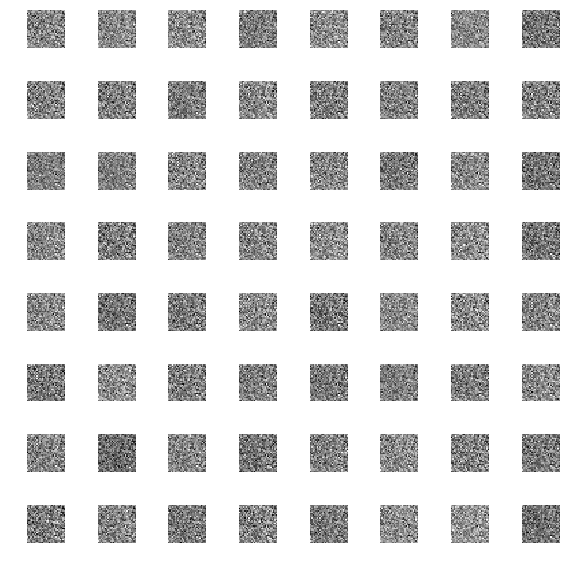

[Epoch 1/25] [Batch 100/938] [D loss: 0.13365702331066132] [G loss: 1.8930574655532837]


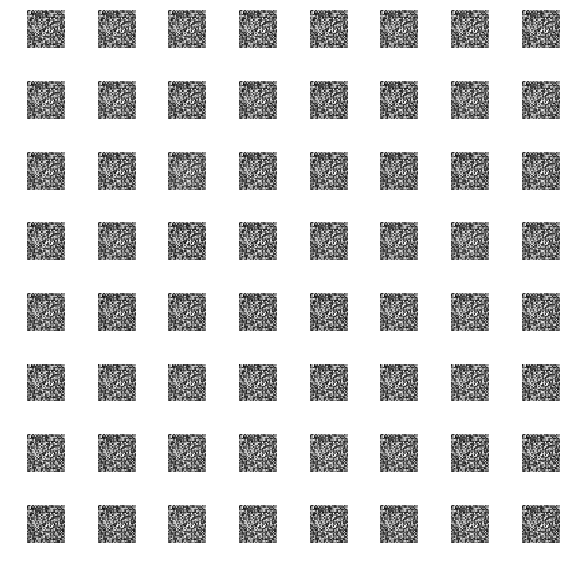

[Epoch 1/25] [Batch 200/938] [D loss: 0.20316772162914276] [G loss: 4.393474578857422]


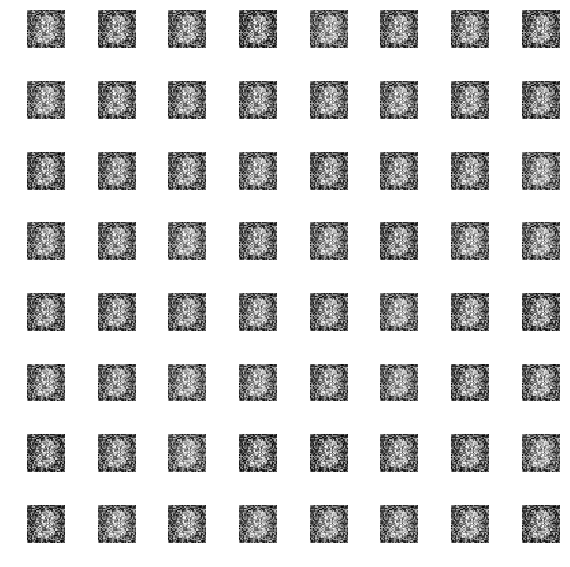

[Epoch 1/25] [Batch 300/938] [D loss: 0.6979580521583557] [G loss: 1.488901972770691]


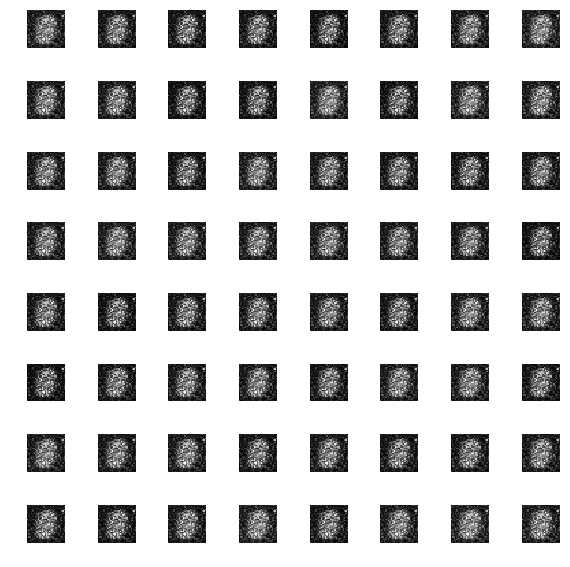

[Epoch 1/25] [Batch 400/938] [D loss: 1.4903738498687744] [G loss: 1.0069825649261475]


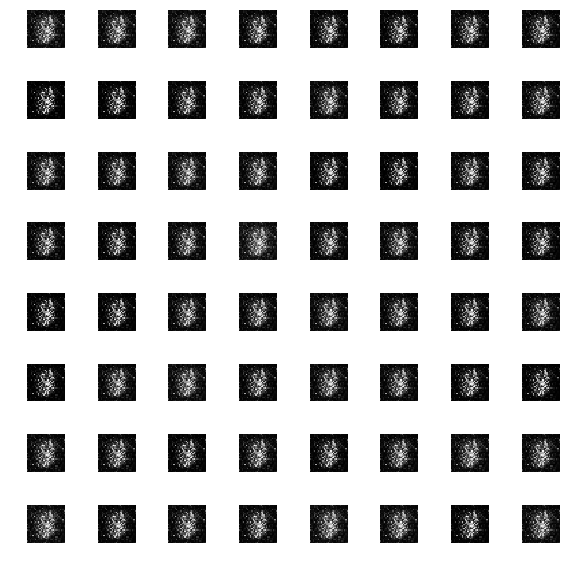

[Epoch 1/25] [Batch 500/938] [D loss: 0.07194065302610397] [G loss: 4.003721714019775]


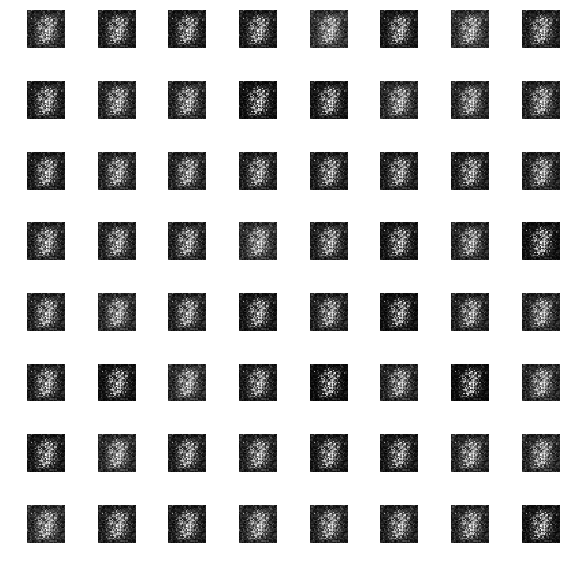

[Epoch 1/25] [Batch 600/938] [D loss: 0.1786355972290039] [G loss: 2.680828332901001]


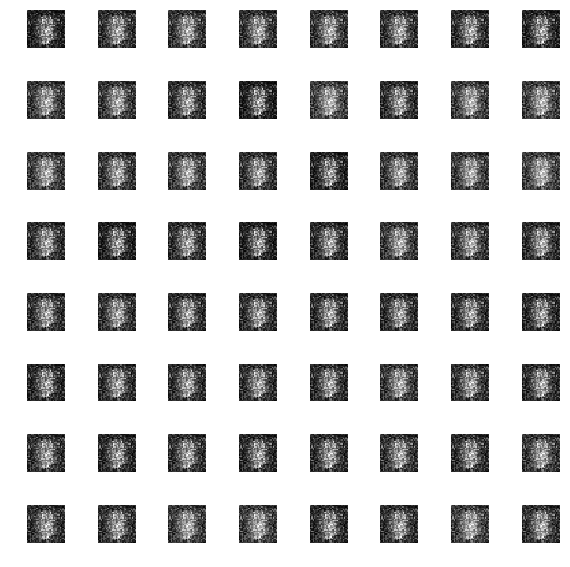

[Epoch 1/25] [Batch 700/938] [D loss: 0.0698939859867096] [G loss: 3.75252628326416]


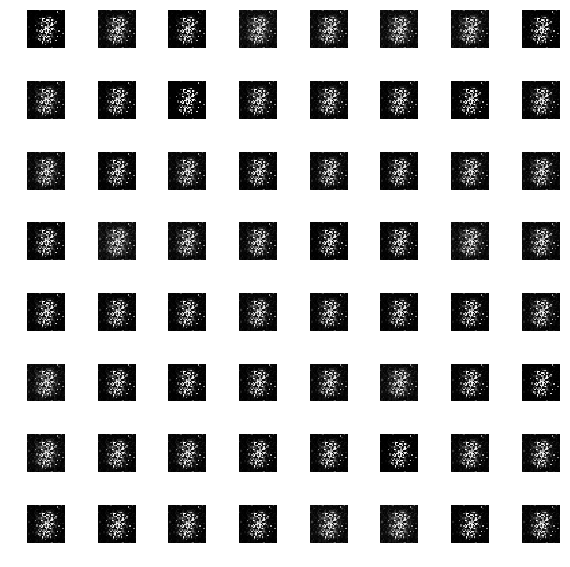

[Epoch 1/25] [Batch 800/938] [D loss: 0.15341781079769135] [G loss: 3.916114091873169]


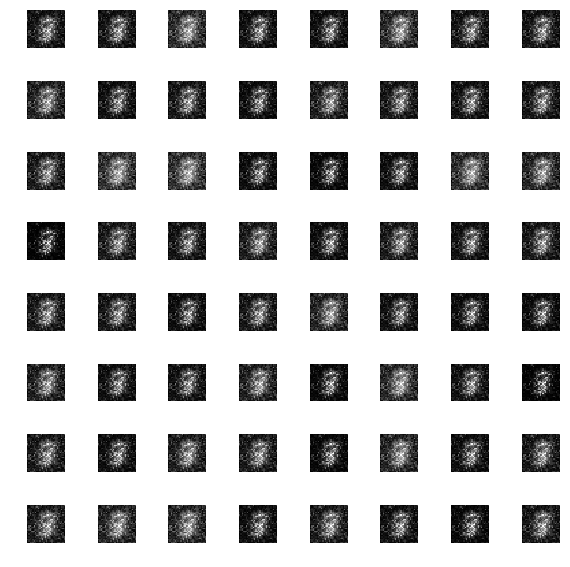

[Epoch 1/25] [Batch 900/938] [D loss: 0.013390669599175453] [G loss: 4.567545413970947]


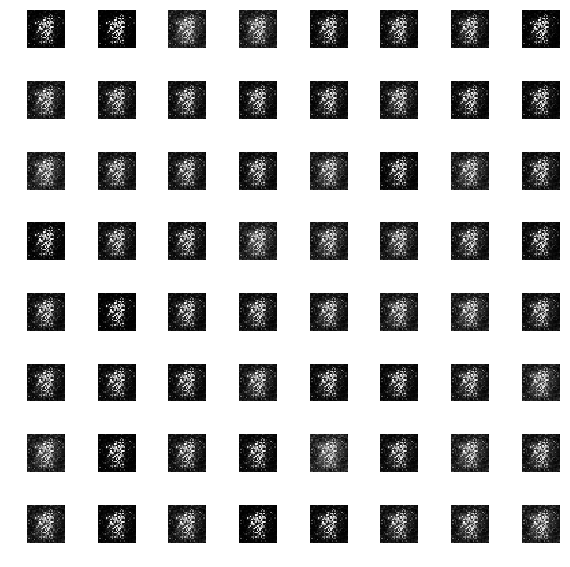

[Epoch 2/25] [Batch 0/938] [D loss: 0.09628057479858398] [G loss: 3.4005978107452393]


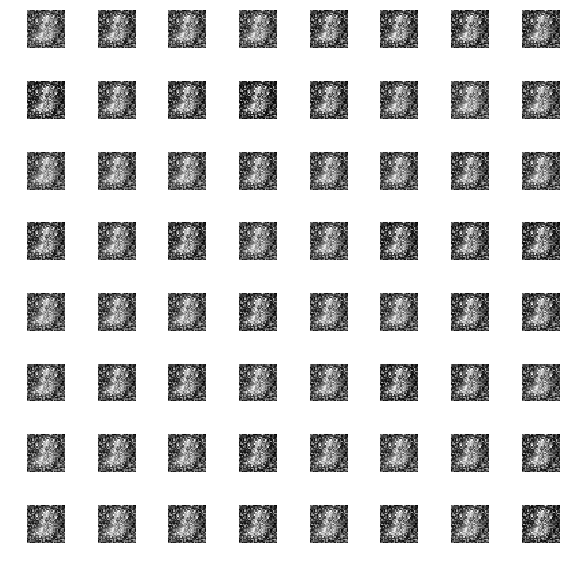

[Epoch 2/25] [Batch 100/938] [D loss: 0.19038255512714386] [G loss: 3.1974377632141113]


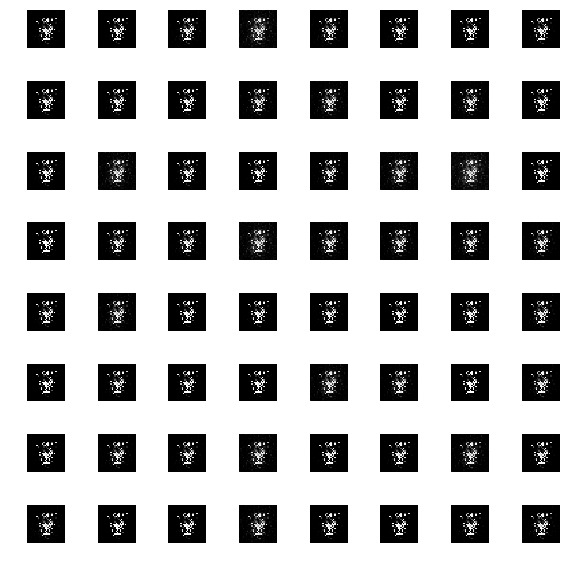

[Epoch 2/25] [Batch 200/938] [D loss: 0.06201830506324768] [G loss: 4.570321083068848]


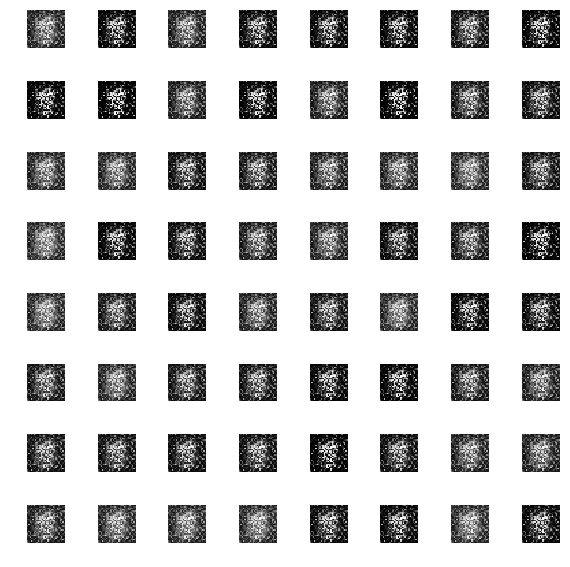

[Epoch 2/25] [Batch 300/938] [D loss: 0.0730307325720787] [G loss: 4.160248279571533]


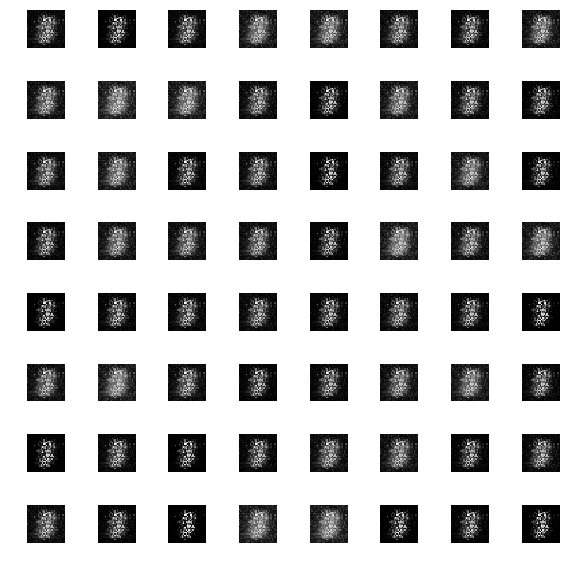

[Epoch 2/25] [Batch 400/938] [D loss: 0.08610377460718155] [G loss: 4.418045520782471]


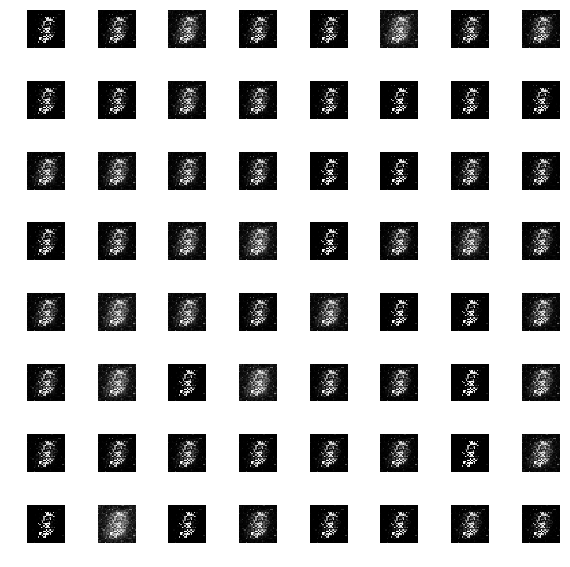

[Epoch 2/25] [Batch 500/938] [D loss: 0.06253209710121155] [G loss: 6.149211883544922]


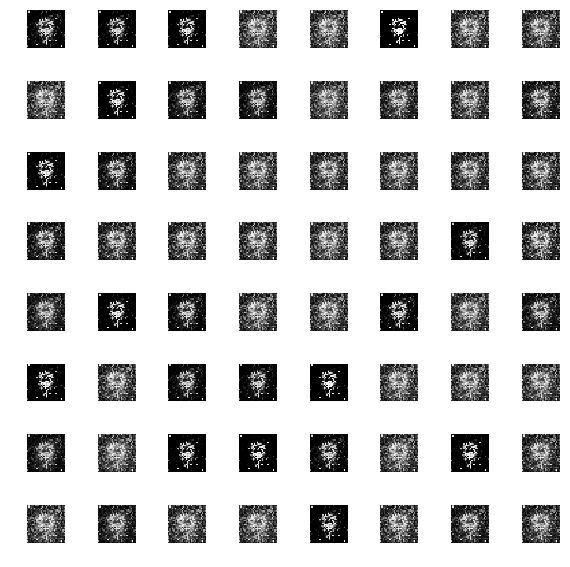

[Epoch 2/25] [Batch 600/938] [D loss: 0.08355660736560822] [G loss: 3.973949670791626]


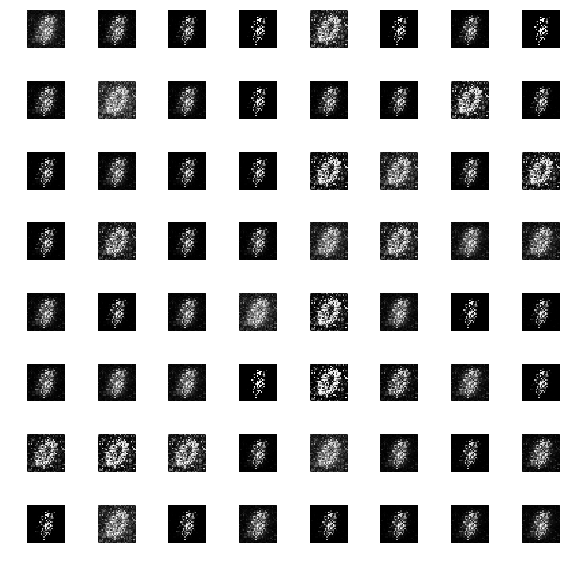

[Epoch 2/25] [Batch 700/938] [D loss: 0.04368489235639572] [G loss: 4.646283149719238]


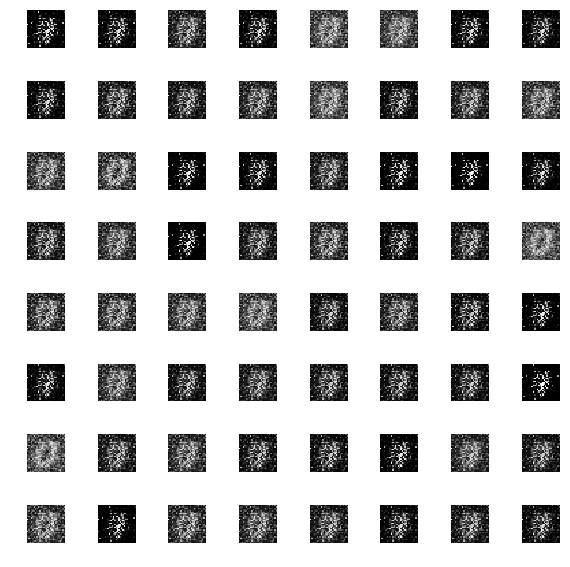

[Epoch 2/25] [Batch 800/938] [D loss: 0.18049195408821106] [G loss: 3.4562106132507324]


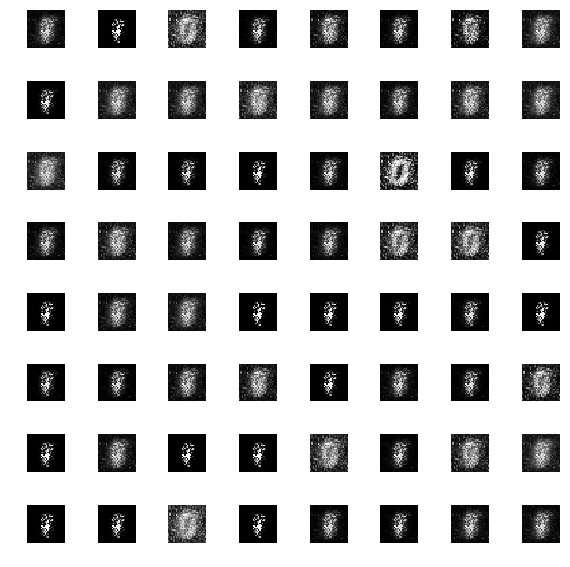

[Epoch 2/25] [Batch 900/938] [D loss: 0.019183356314897537] [G loss: 6.0432329177856445]


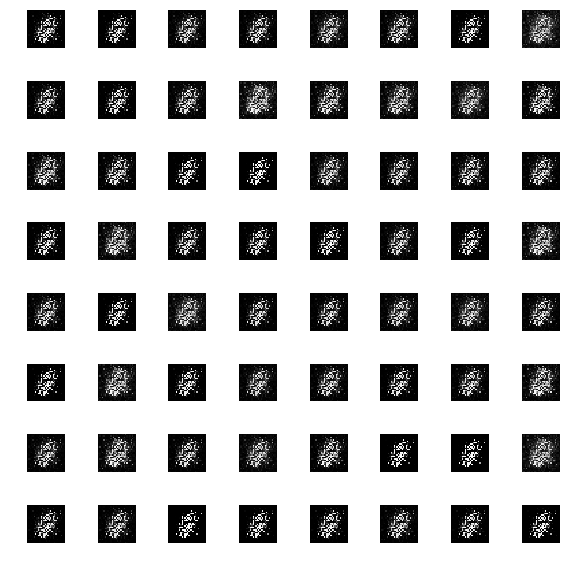

[Epoch 3/25] [Batch 0/938] [D loss: 0.01743452437222004] [G loss: 8.44902515411377]


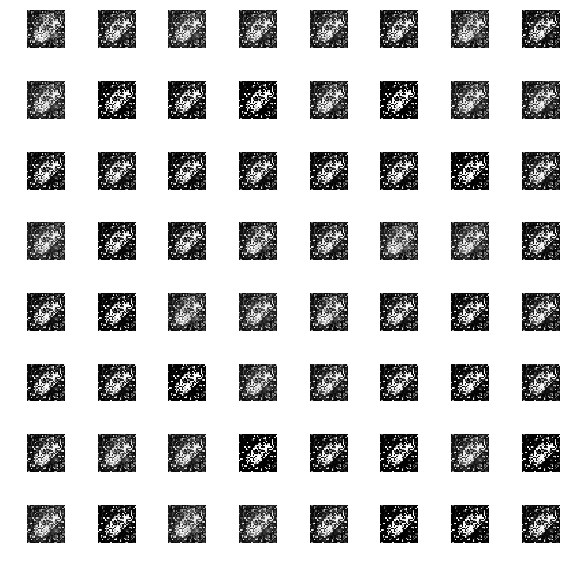

[Epoch 3/25] [Batch 100/938] [D loss: 0.055731795728206635] [G loss: 3.872745990753174]


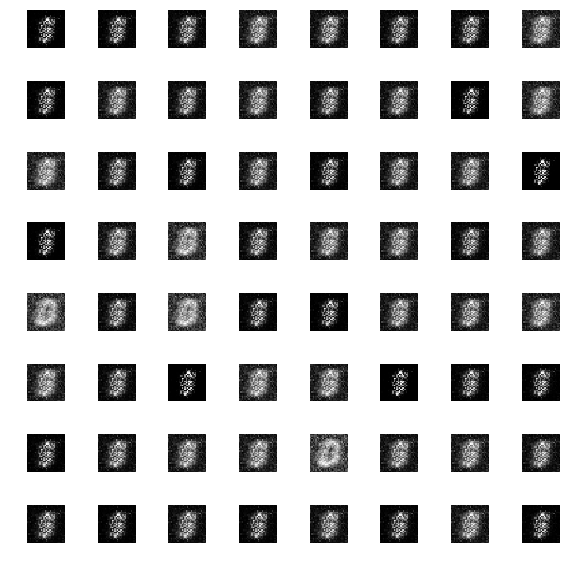

[Epoch 3/25] [Batch 200/938] [D loss: 0.06858396530151367] [G loss: 4.312768936157227]


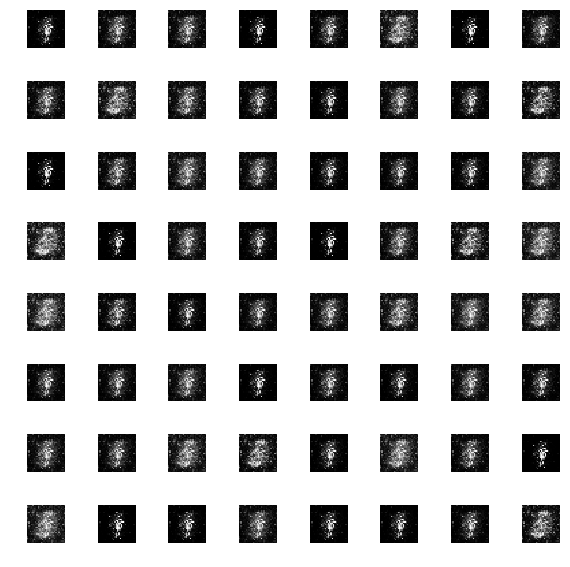

[Epoch 3/25] [Batch 300/938] [D loss: 0.11319514364004135] [G loss: 5.403973579406738]


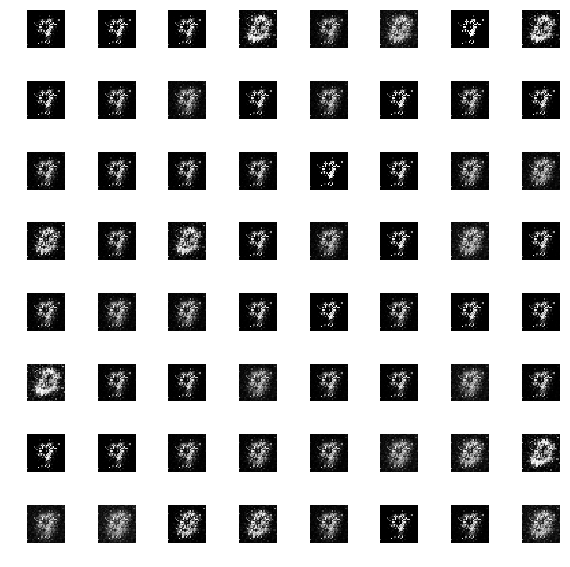

[Epoch 3/25] [Batch 400/938] [D loss: 0.009818268939852715] [G loss: 4.338537216186523]


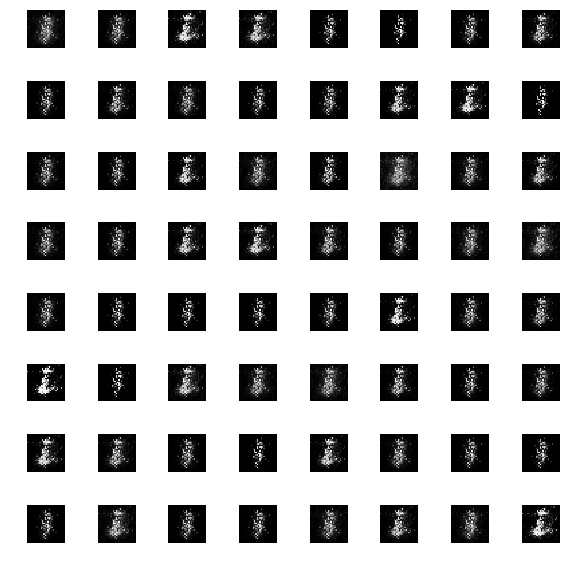

[Epoch 3/25] [Batch 500/938] [D loss: 0.03674754127860069] [G loss: 3.703338146209717]


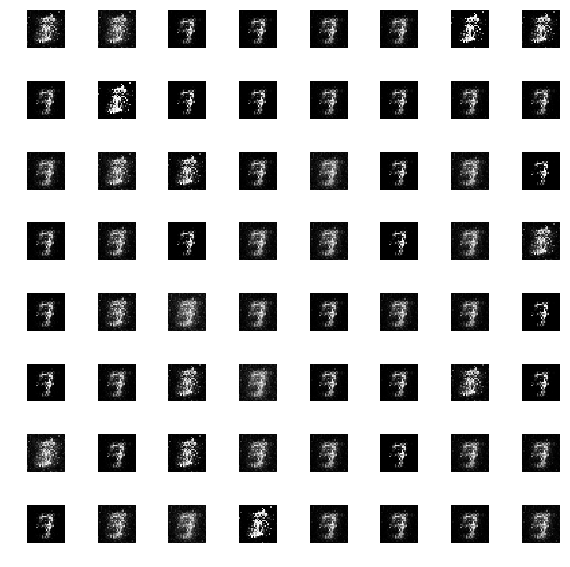

[Epoch 3/25] [Batch 600/938] [D loss: 0.04249338060617447] [G loss: 4.372477054595947]


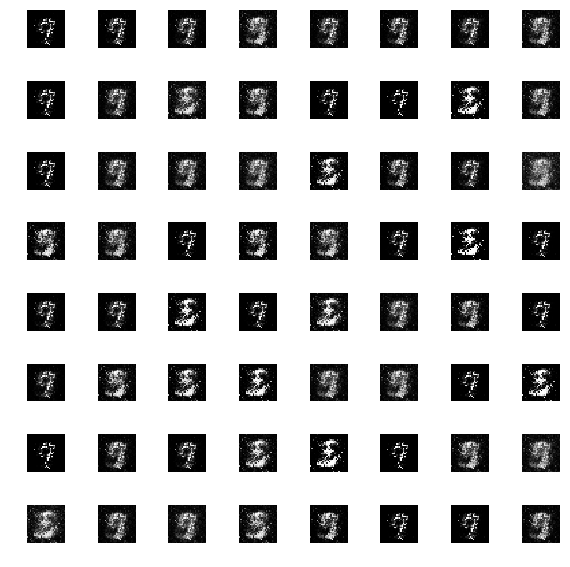

[Epoch 3/25] [Batch 700/938] [D loss: 0.029512714594602585] [G loss: 4.196165084838867]


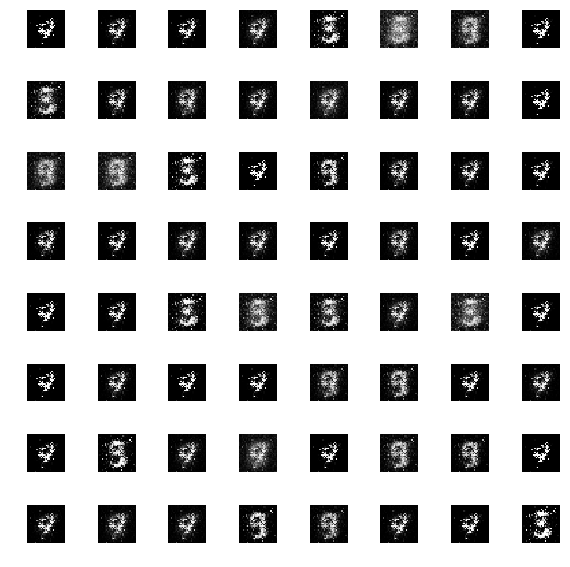

[Epoch 3/25] [Batch 800/938] [D loss: 0.07111340016126633] [G loss: 6.462352752685547]


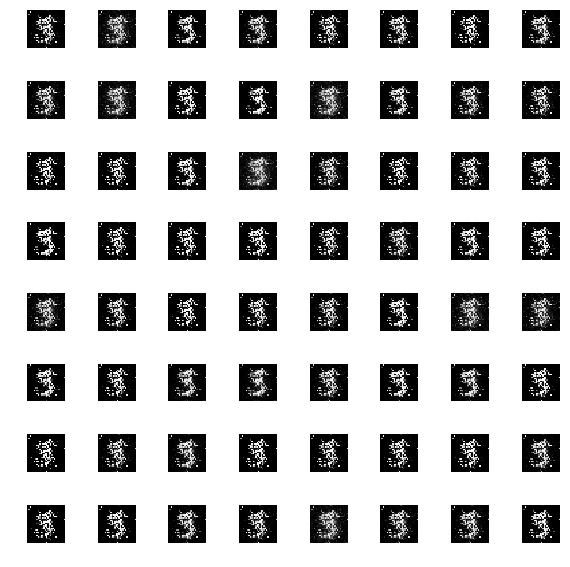

[Epoch 3/25] [Batch 900/938] [D loss: 0.19163179397583008] [G loss: 2.793247699737549]


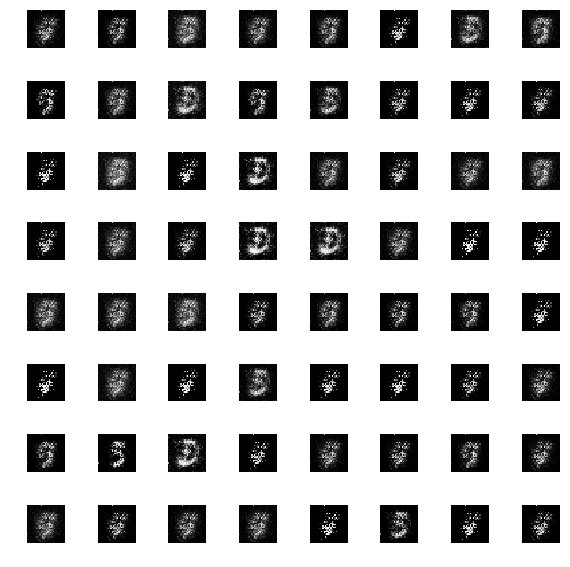

[Epoch 4/25] [Batch 0/938] [D loss: 0.09163707494735718] [G loss: 3.964230537414551]


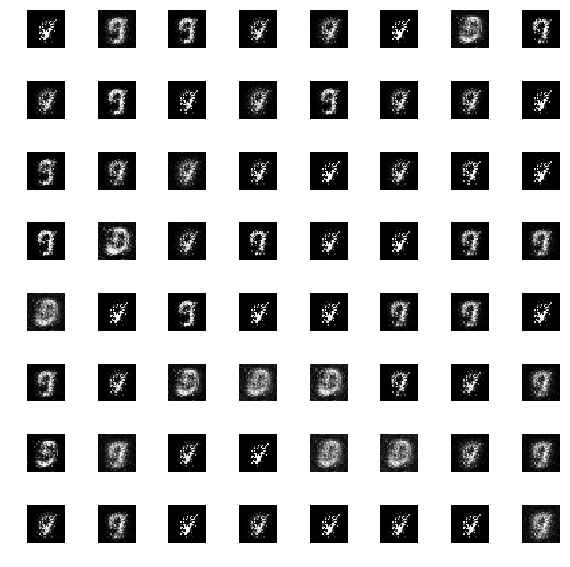

[Epoch 4/25] [Batch 100/938] [D loss: 0.10612712055444717] [G loss: 4.113454818725586]


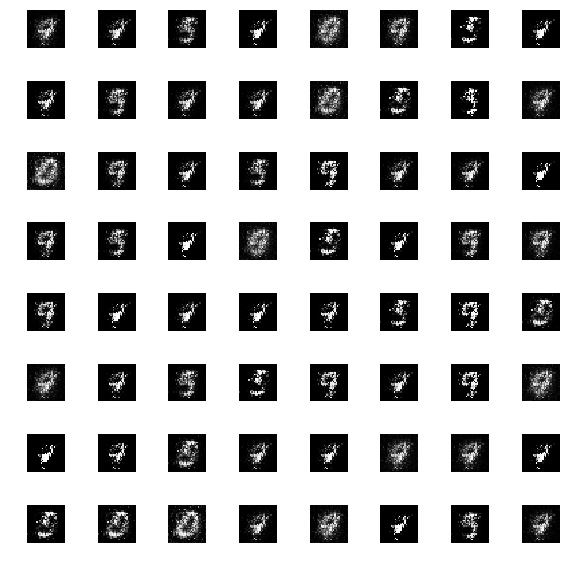

[Epoch 4/25] [Batch 200/938] [D loss: 0.1477576345205307] [G loss: 3.969728469848633]


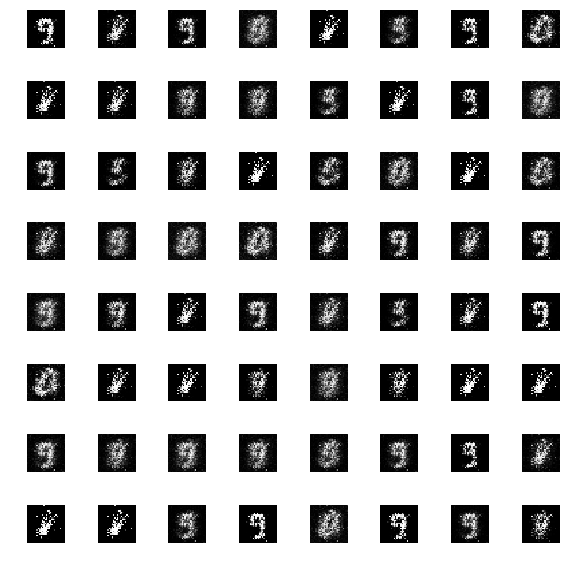

[Epoch 4/25] [Batch 300/938] [D loss: 0.147340327501297] [G loss: 3.1010799407958984]


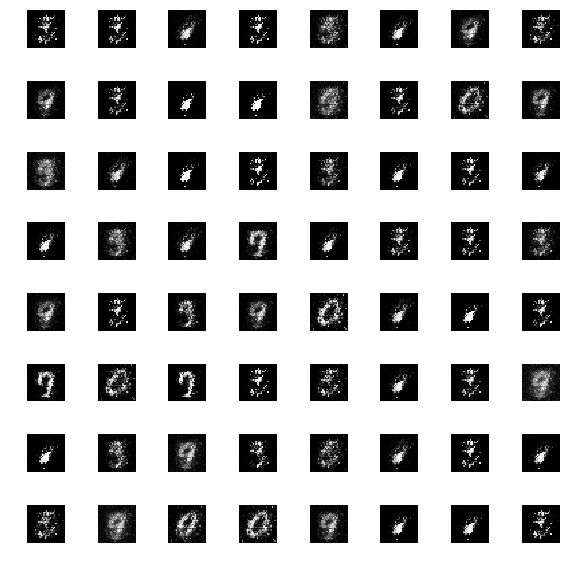

[Epoch 4/25] [Batch 400/938] [D loss: 0.05793694406747818] [G loss: 4.419580936431885]


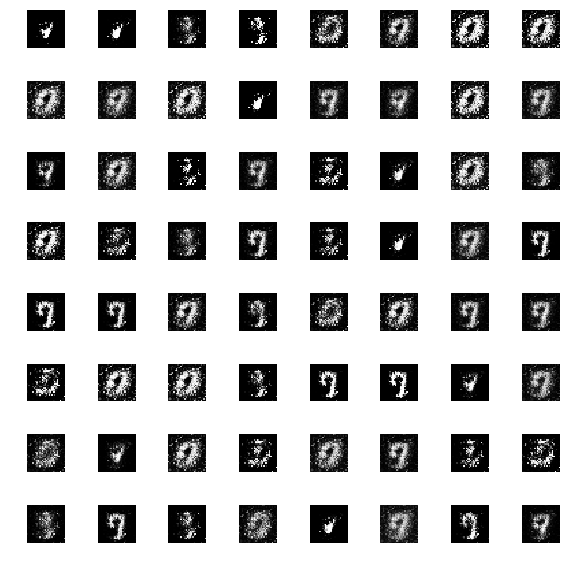

[Epoch 4/25] [Batch 500/938] [D loss: 0.11956530064344406] [G loss: 4.146212100982666]


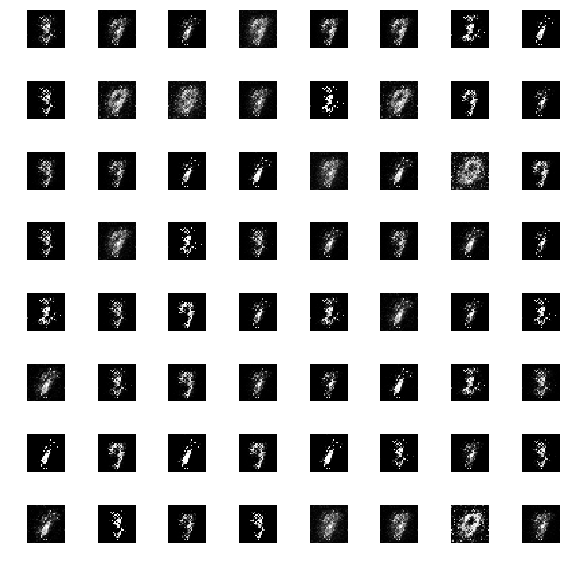

[Epoch 4/25] [Batch 600/938] [D loss: 0.10547003895044327] [G loss: 4.757763862609863]


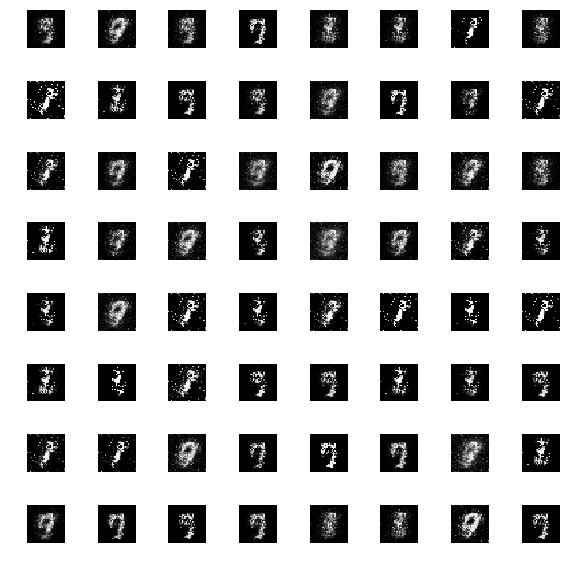

[Epoch 4/25] [Batch 700/938] [D loss: 0.08216851949691772] [G loss: 3.1285672187805176]


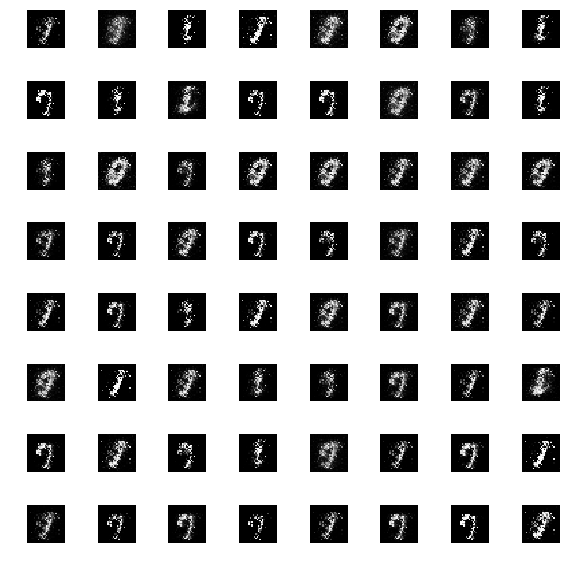

[Epoch 4/25] [Batch 800/938] [D loss: 0.040562935173511505] [G loss: 3.863616466522217]


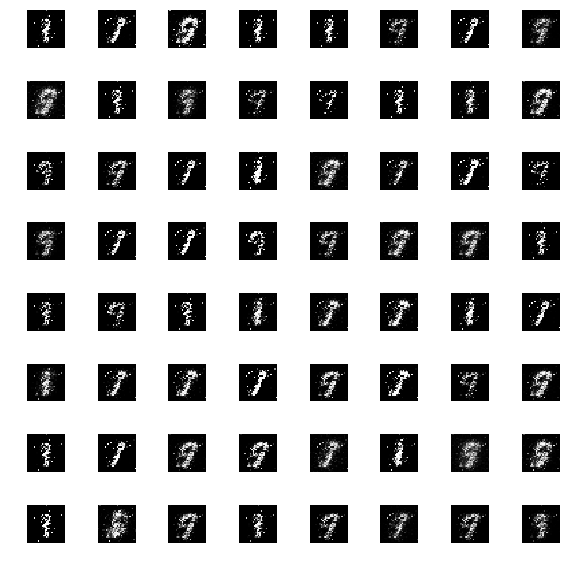

[Epoch 4/25] [Batch 900/938] [D loss: 0.12188784033060074] [G loss: 4.465205192565918]


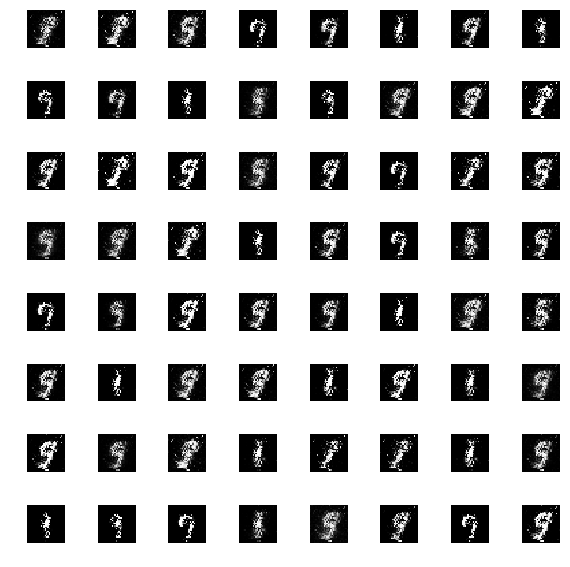

[Epoch 5/25] [Batch 0/938] [D loss: 0.21048562228679657] [G loss: 4.8901262283325195]


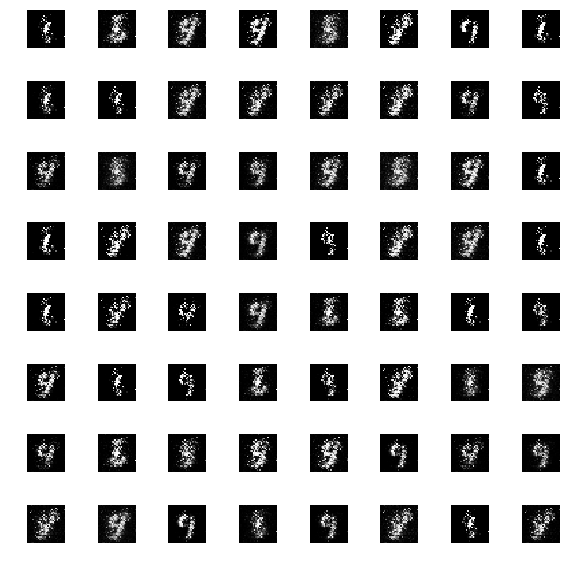

[Epoch 5/25] [Batch 100/938] [D loss: 0.0848497822880745] [G loss: 3.489804744720459]


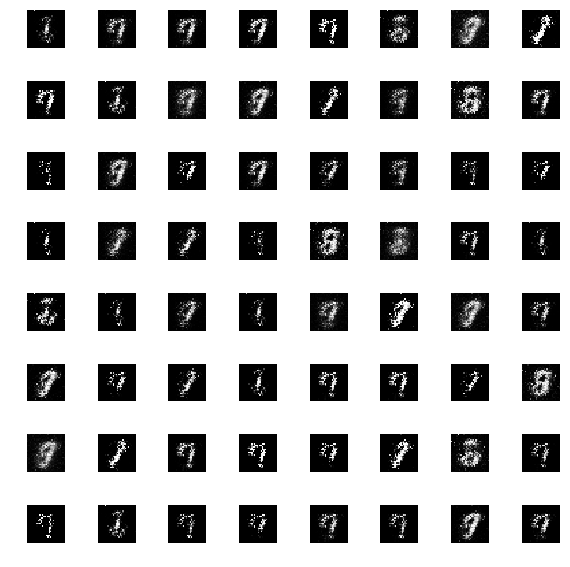

[Epoch 5/25] [Batch 200/938] [D loss: 0.09416861832141876] [G loss: 4.287428379058838]


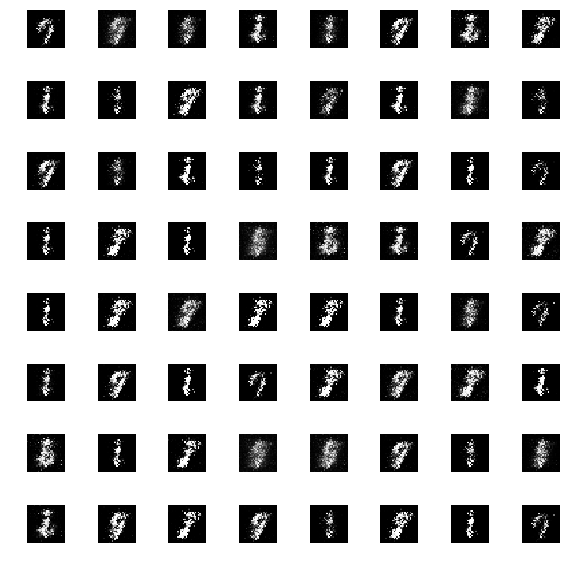

[Epoch 5/25] [Batch 300/938] [D loss: 0.07451775670051575] [G loss: 3.908623695373535]


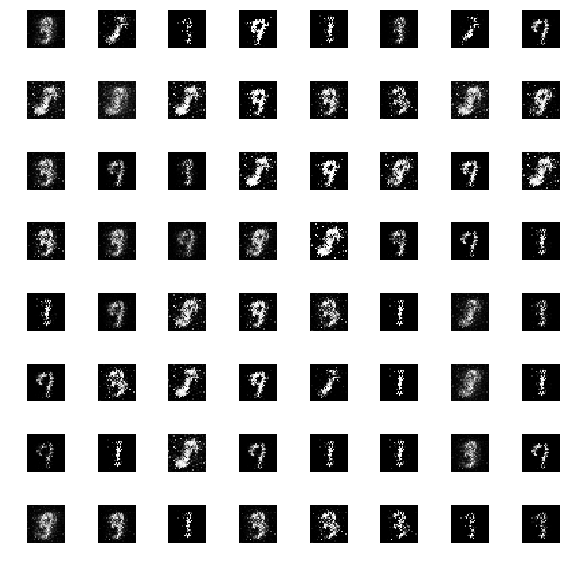

[Epoch 5/25] [Batch 400/938] [D loss: 0.17114710807800293] [G loss: 3.8685431480407715]


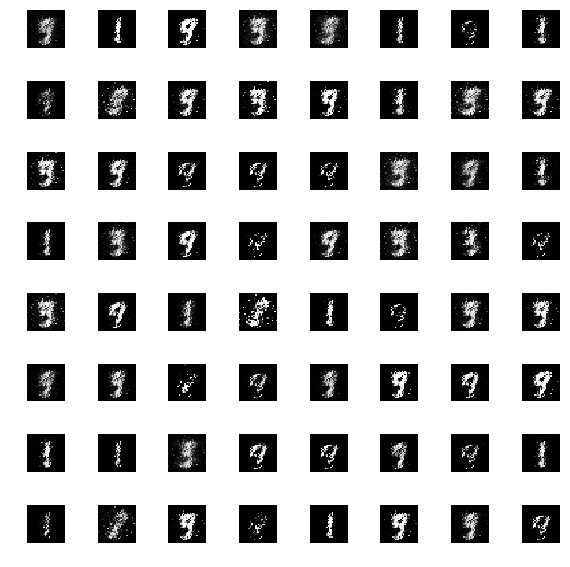

[Epoch 5/25] [Batch 500/938] [D loss: 0.18002167344093323] [G loss: 3.693723678588867]


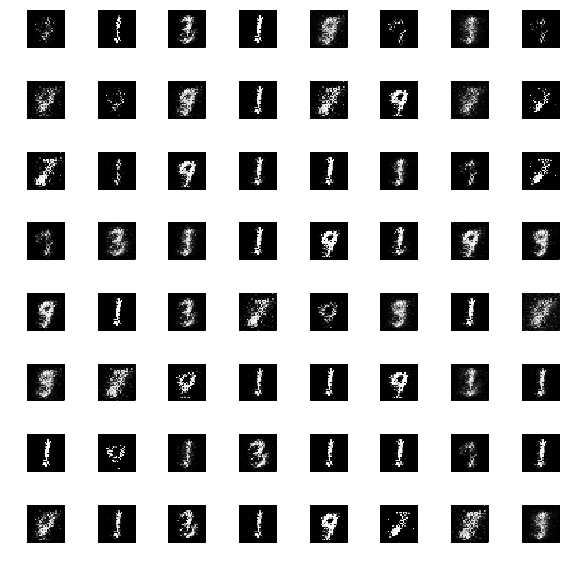

[Epoch 5/25] [Batch 600/938] [D loss: 0.15879109501838684] [G loss: 3.426971912384033]


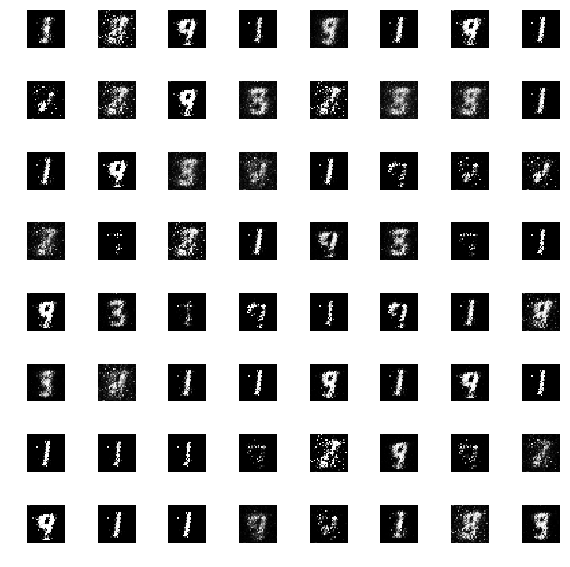

[Epoch 5/25] [Batch 700/938] [D loss: 0.17347046732902527] [G loss: 2.7043726444244385]


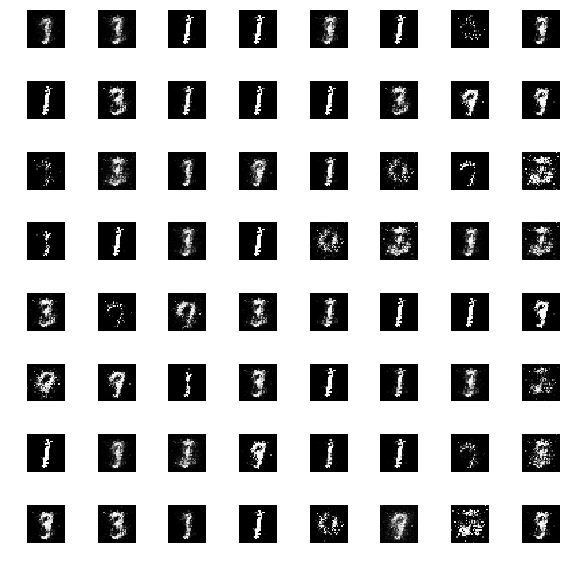

[Epoch 5/25] [Batch 800/938] [D loss: 0.21082624793052673] [G loss: 2.6396446228027344]


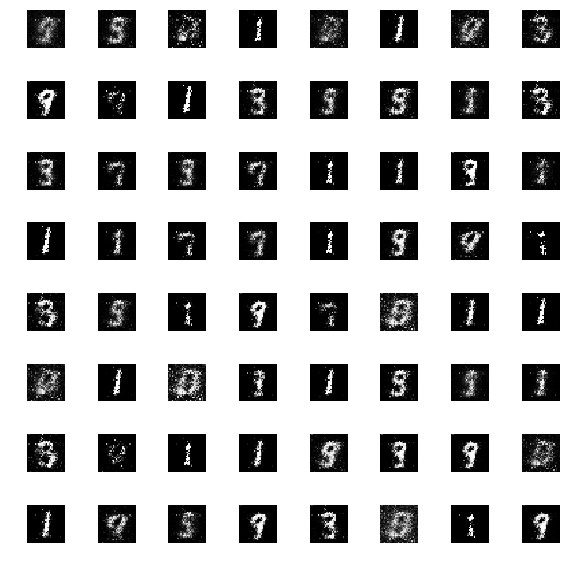

[Epoch 5/25] [Batch 900/938] [D loss: 0.2155642807483673] [G loss: 3.180875301361084]


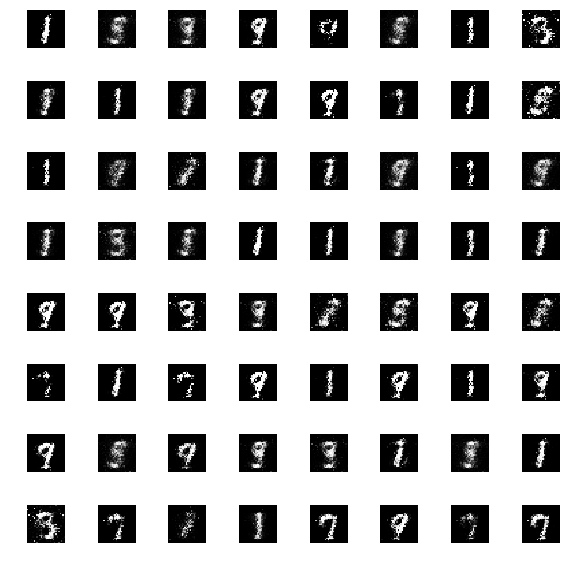

[Epoch 6/25] [Batch 0/938] [D loss: 0.16910700500011444] [G loss: 3.570345878601074]


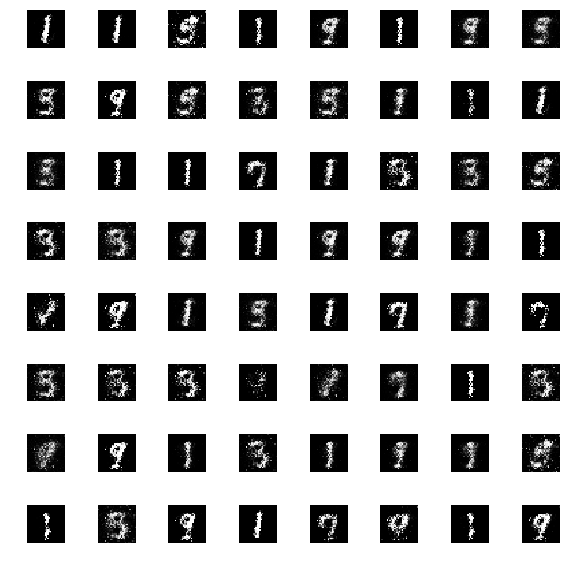

[Epoch 6/25] [Batch 100/938] [D loss: 0.09801647067070007] [G loss: 3.051906108856201]


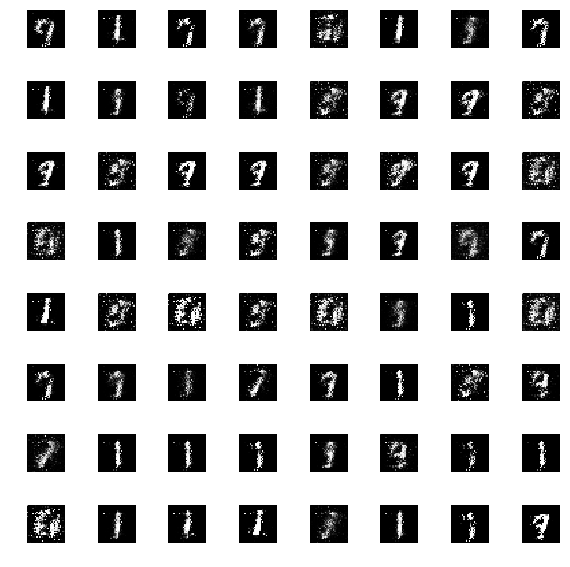

[Epoch 6/25] [Batch 200/938] [D loss: 0.20602405071258545] [G loss: 3.475076675415039]


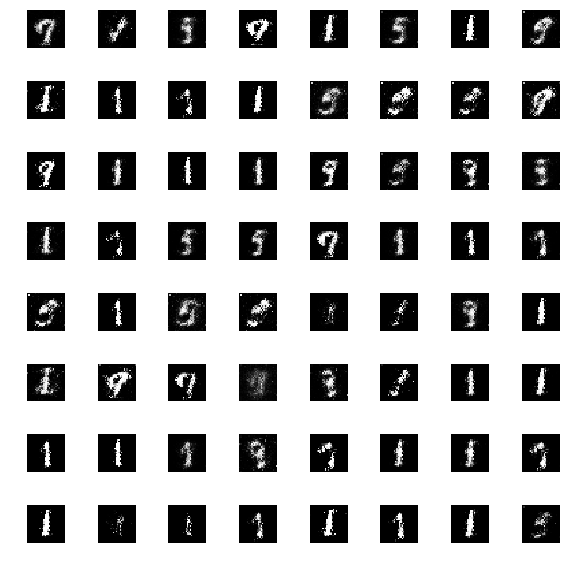

[Epoch 6/25] [Batch 300/938] [D loss: 0.10963228344917297] [G loss: 4.035923004150391]


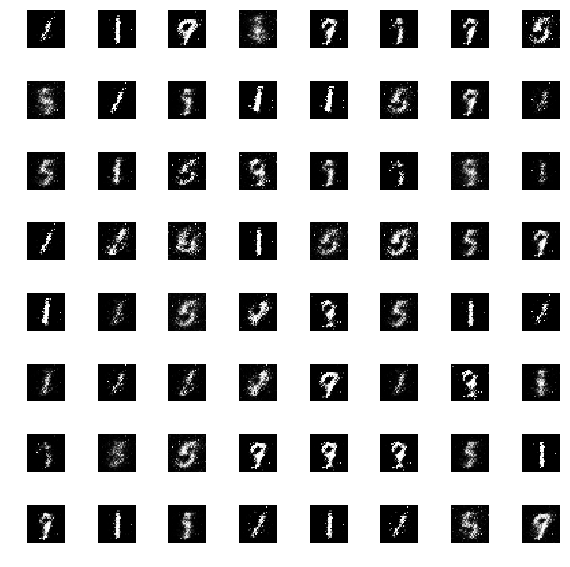

[Epoch 6/25] [Batch 400/938] [D loss: 0.15697336196899414] [G loss: 3.7444238662719727]


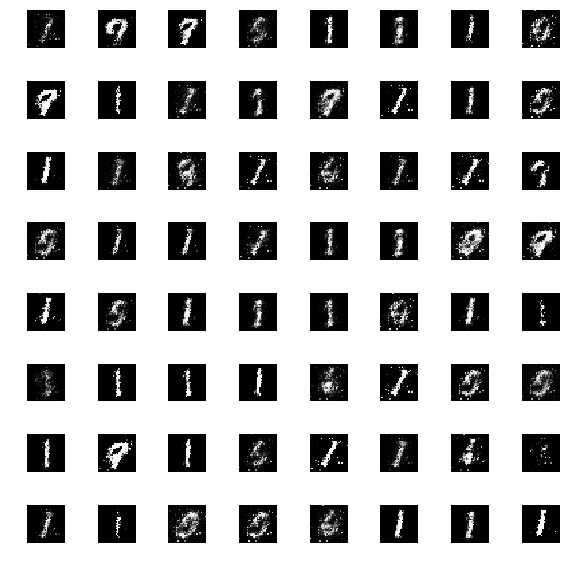

[Epoch 6/25] [Batch 500/938] [D loss: 0.16214703023433685] [G loss: 2.7937119007110596]


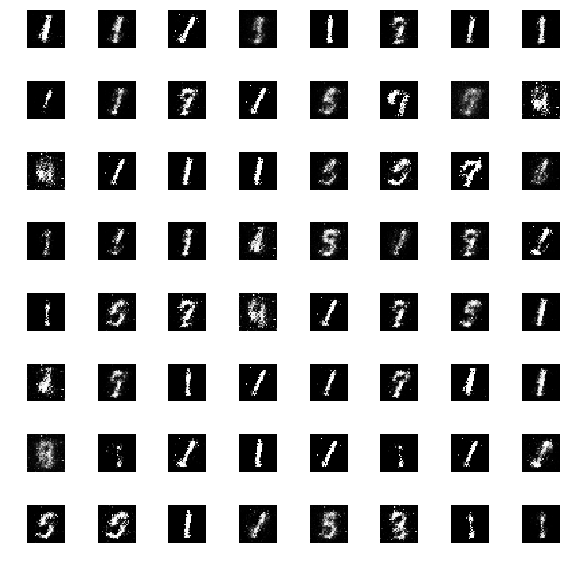

[Epoch 6/25] [Batch 600/938] [D loss: 0.247231125831604] [G loss: 2.8422279357910156]


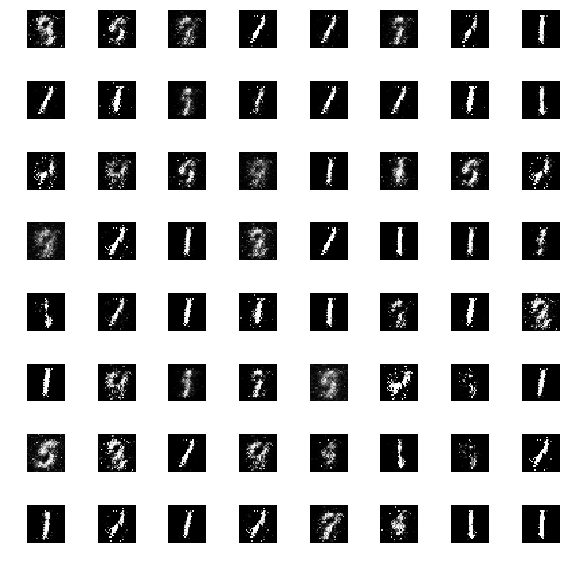

[Epoch 6/25] [Batch 700/938] [D loss: 0.18883535265922546] [G loss: 3.2364840507507324]


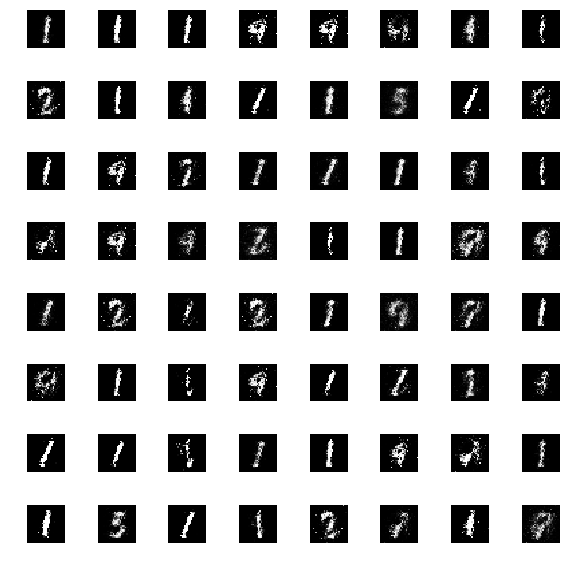

[Epoch 6/25] [Batch 800/938] [D loss: 0.1413497030735016] [G loss: 3.137824773788452]


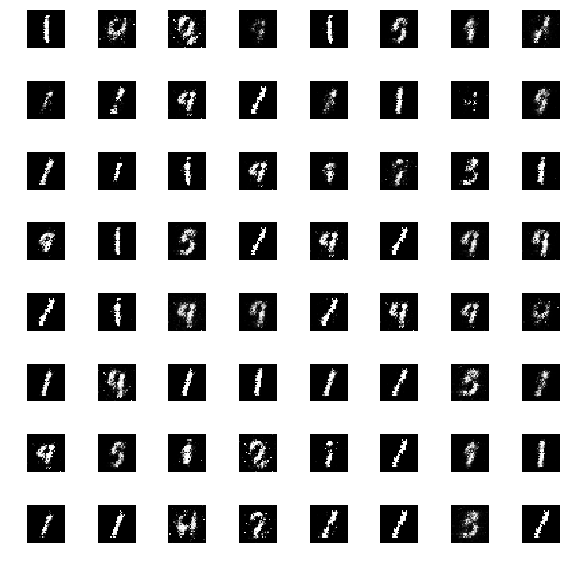

[Epoch 6/25] [Batch 900/938] [D loss: 0.1657227724790573] [G loss: 2.3791050910949707]


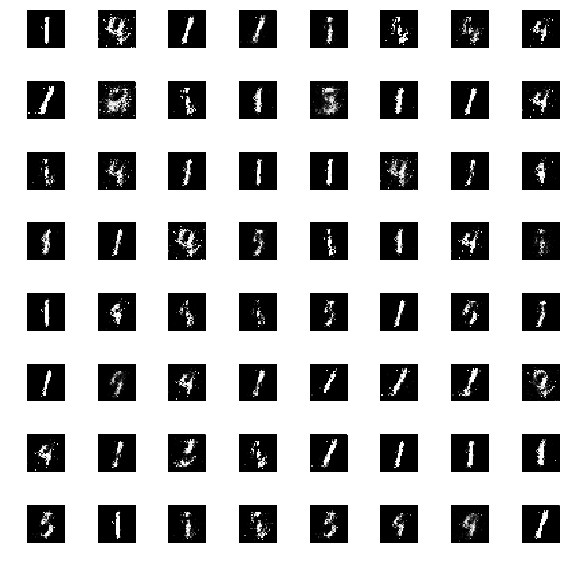

[Epoch 7/25] [Batch 0/938] [D loss: 0.1923794448375702] [G loss: 3.3971264362335205]


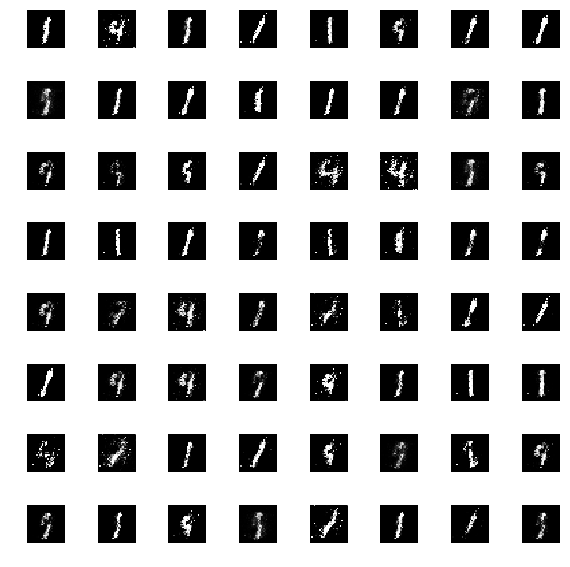

[Epoch 7/25] [Batch 100/938] [D loss: 0.12793830037117004] [G loss: 2.539048433303833]


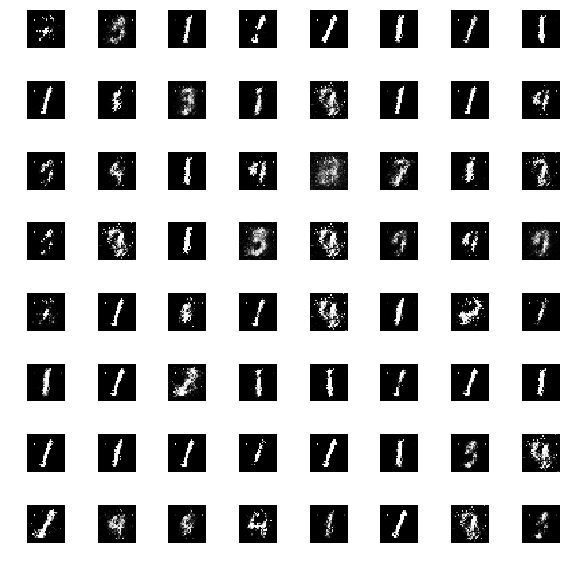

[Epoch 7/25] [Batch 200/938] [D loss: 0.2974283993244171] [G loss: 2.9849958419799805]


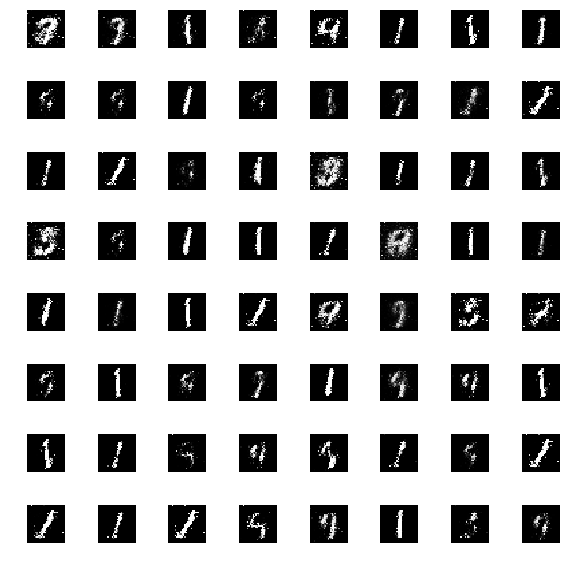

[Epoch 7/25] [Batch 300/938] [D loss: 0.17882947623729706] [G loss: 2.9584708213806152]


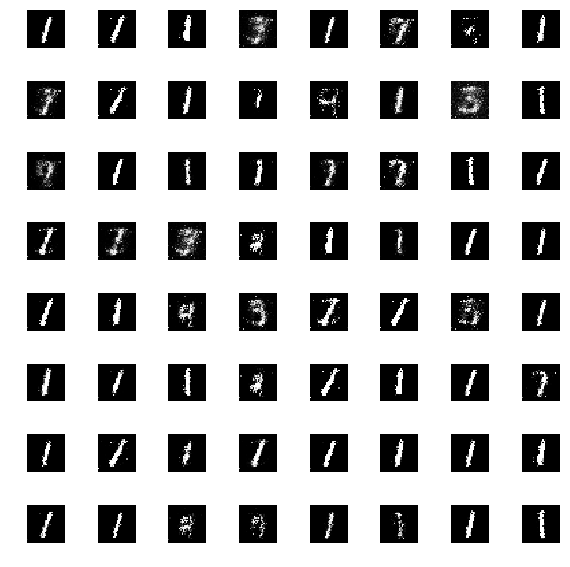

[Epoch 7/25] [Batch 400/938] [D loss: 0.16703352332115173] [G loss: 3.6543309688568115]


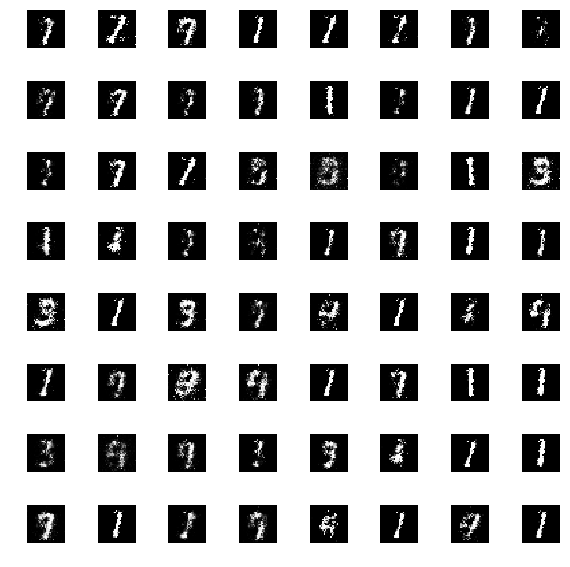

[Epoch 7/25] [Batch 500/938] [D loss: 0.22250090539455414] [G loss: 2.5276601314544678]


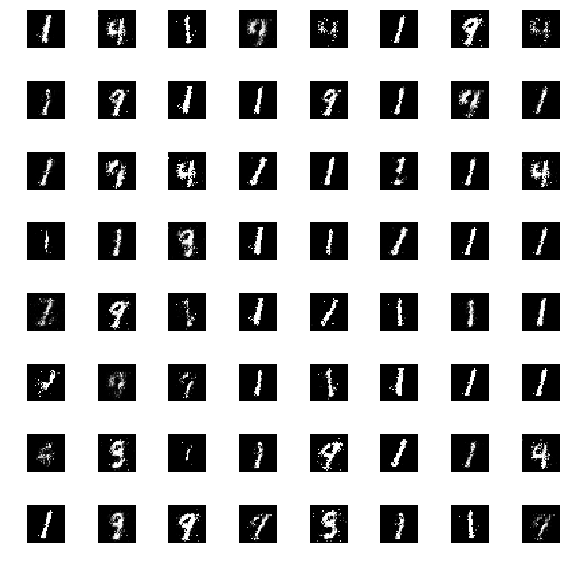

[Epoch 7/25] [Batch 600/938] [D loss: 0.2743346095085144] [G loss: 2.403557300567627]


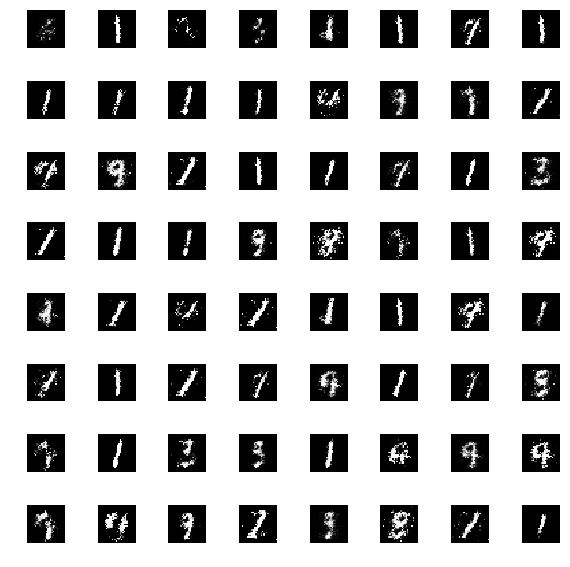

[Epoch 7/25] [Batch 700/938] [D loss: 0.2189771682024002] [G loss: 2.1870200634002686]


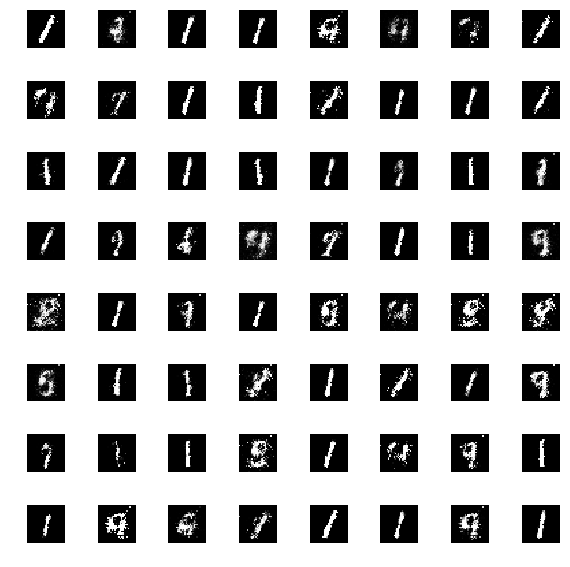

[Epoch 7/25] [Batch 800/938] [D loss: 0.12569421529769897] [G loss: 2.9855942726135254]


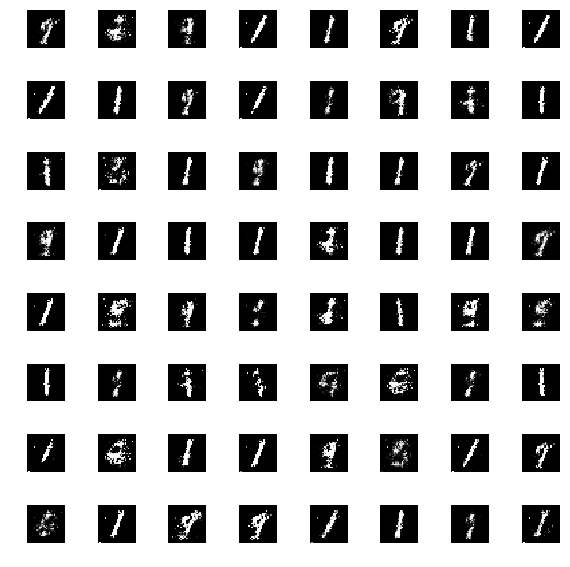

[Epoch 7/25] [Batch 900/938] [D loss: 0.26126015186309814] [G loss: 2.5839927196502686]


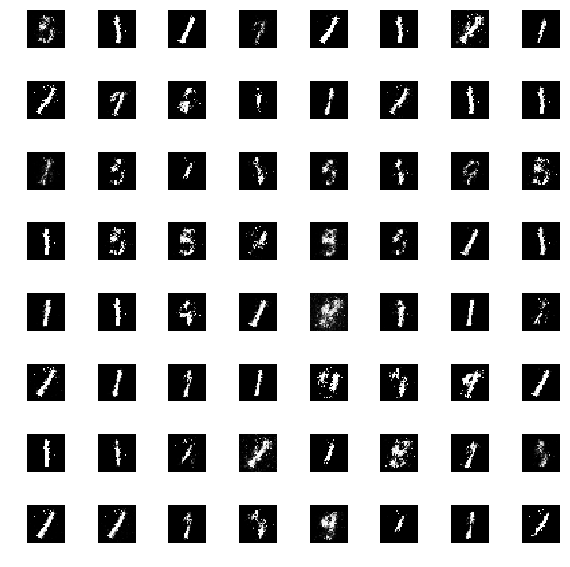

[Epoch 8/25] [Batch 0/938] [D loss: 0.23965045809745789] [G loss: 3.4139938354492188]


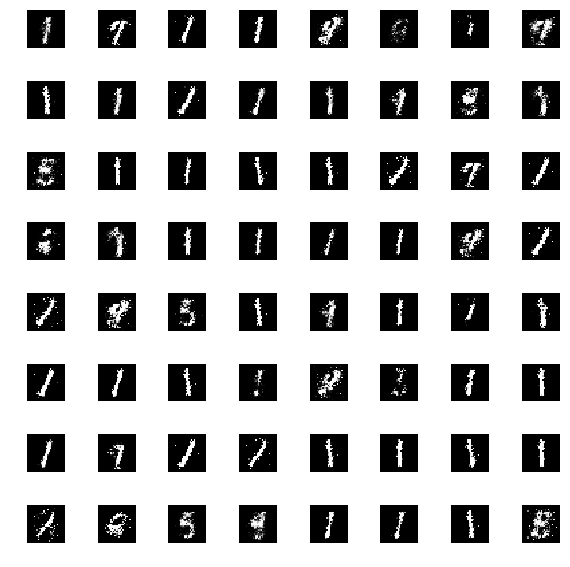

[Epoch 8/25] [Batch 100/938] [D loss: 0.2583596110343933] [G loss: 2.270172119140625]


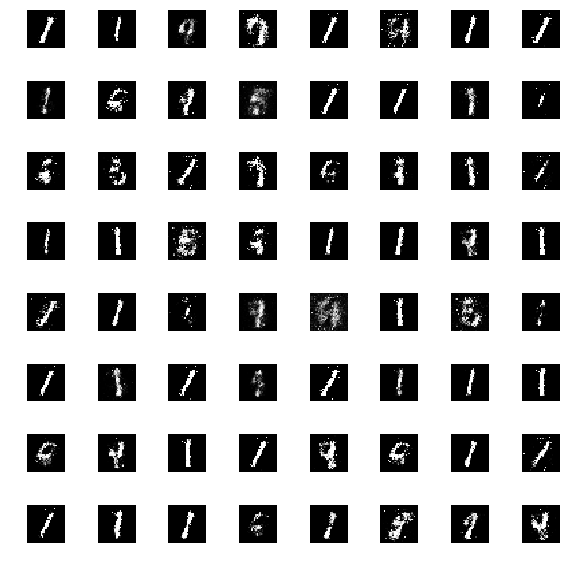

[Epoch 8/25] [Batch 200/938] [D loss: 0.2762942314147949] [G loss: 2.4260265827178955]


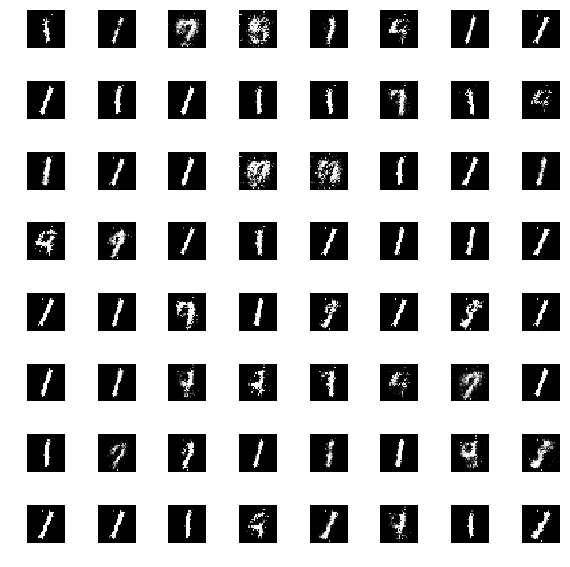

[Epoch 8/25] [Batch 300/938] [D loss: 0.24286216497421265] [G loss: 2.6415982246398926]


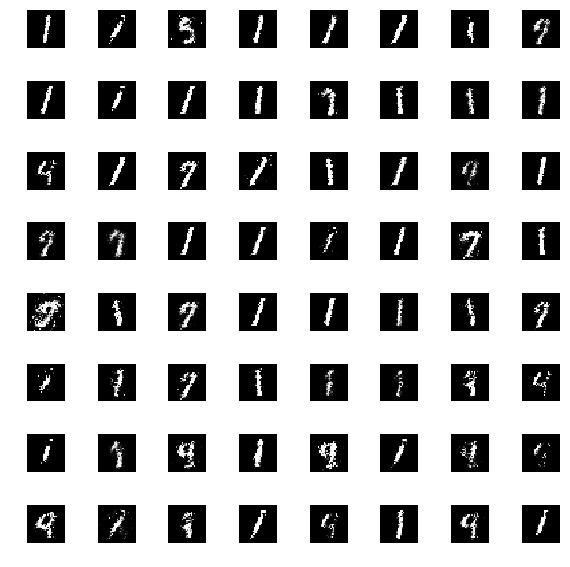

[Epoch 8/25] [Batch 400/938] [D loss: 0.1970328688621521] [G loss: 2.5823278427124023]


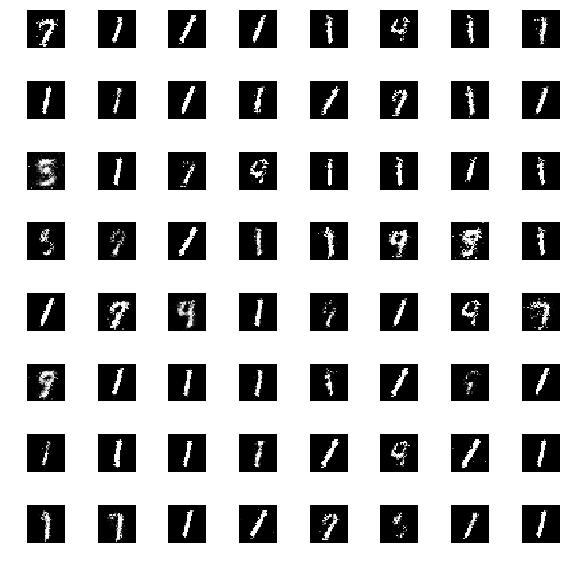

[Epoch 8/25] [Batch 500/938] [D loss: 0.2357940673828125] [G loss: 2.709331512451172]


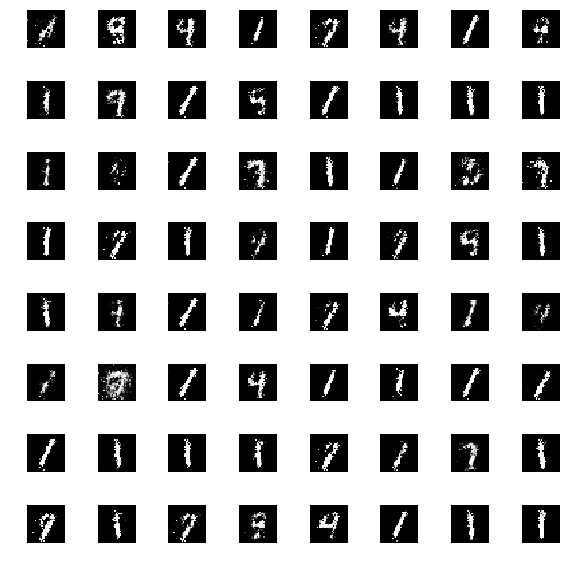

[Epoch 8/25] [Batch 600/938] [D loss: 0.2517038881778717] [G loss: 2.8201651573181152]


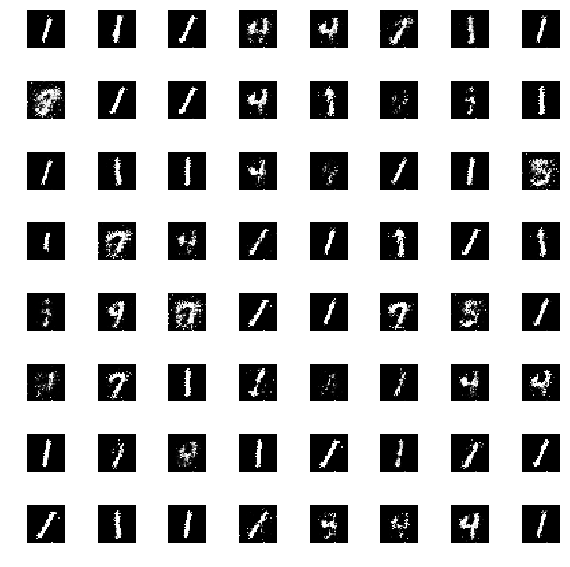

[Epoch 8/25] [Batch 700/938] [D loss: 0.23708149790763855] [G loss: 2.3397347927093506]


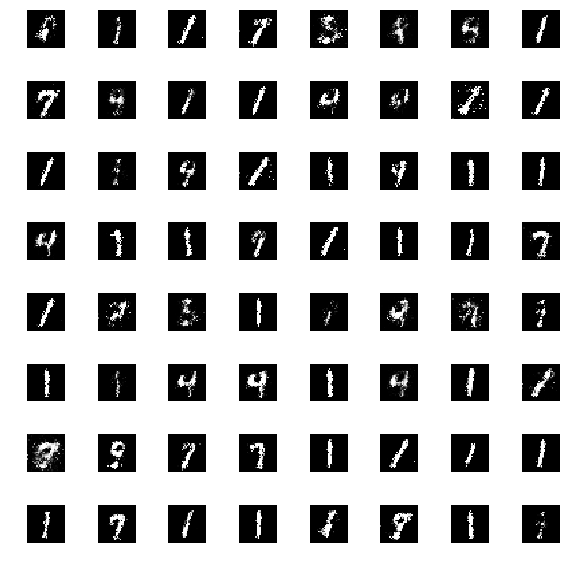

[Epoch 8/25] [Batch 800/938] [D loss: 0.20180556178092957] [G loss: 2.3473010063171387]


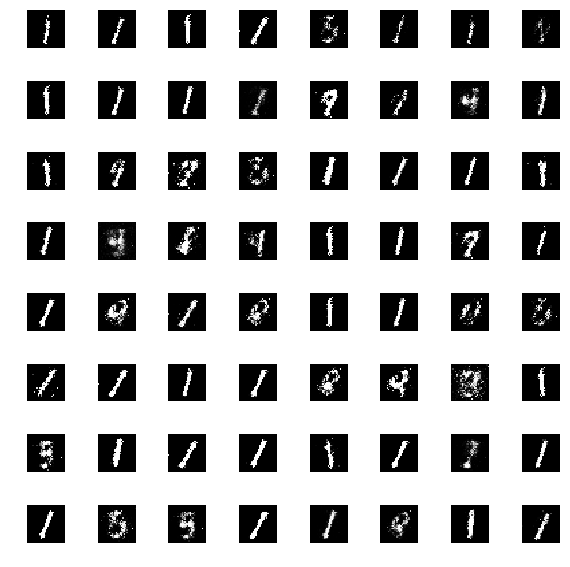

[Epoch 8/25] [Batch 900/938] [D loss: 0.3122192323207855] [G loss: 2.6718788146972656]


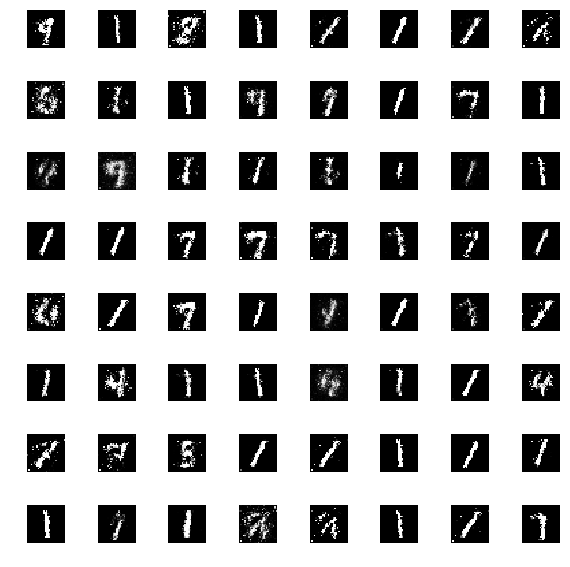

[Epoch 9/25] [Batch 0/938] [D loss: 0.3123719096183777] [G loss: 2.4483225345611572]


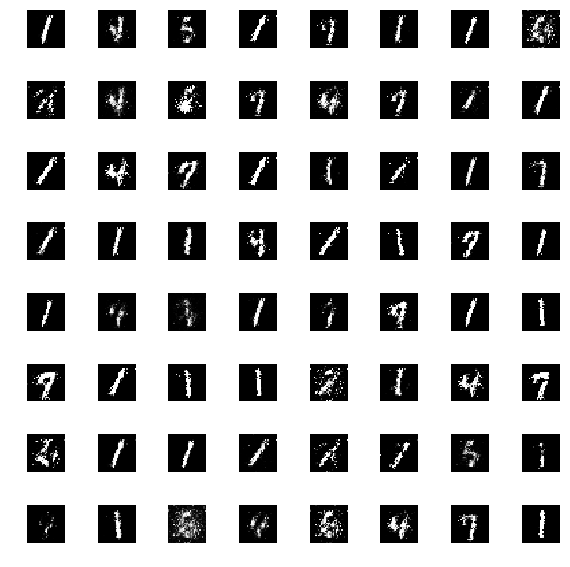

[Epoch 9/25] [Batch 100/938] [D loss: 0.2153725028038025] [G loss: 3.02199387550354]


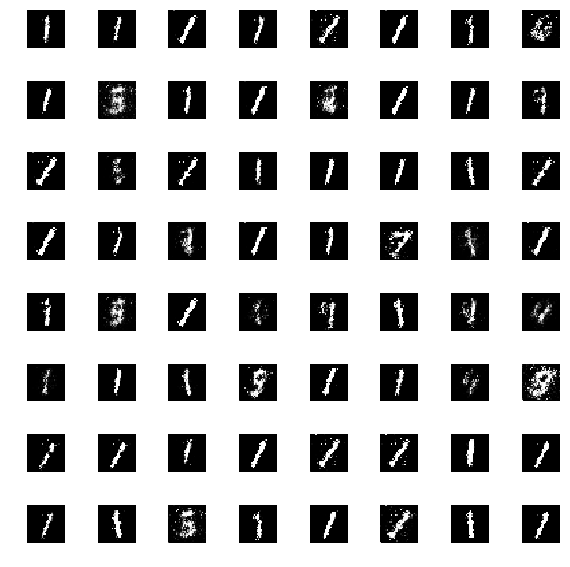

[Epoch 9/25] [Batch 200/938] [D loss: 0.2636694312095642] [G loss: 2.36240291595459]


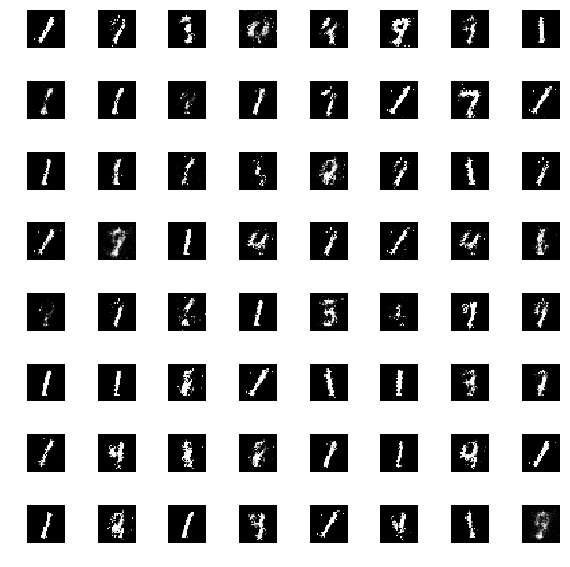

[Epoch 9/25] [Batch 300/938] [D loss: 0.19726425409317017] [G loss: 3.5662741661071777]


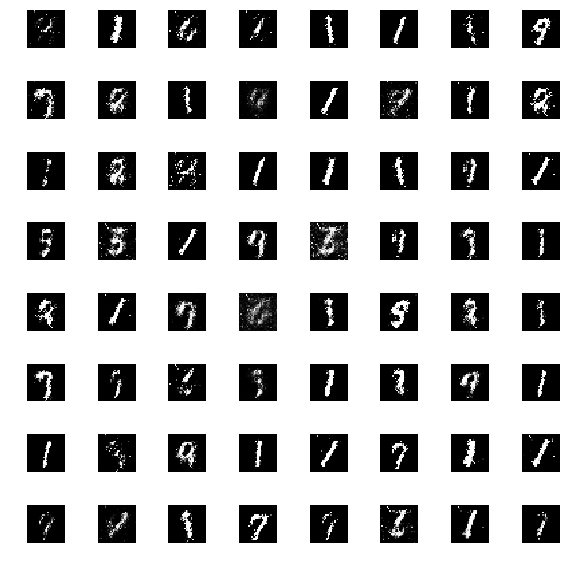

[Epoch 9/25] [Batch 400/938] [D loss: 0.2291301190853119] [G loss: 2.569258689880371]


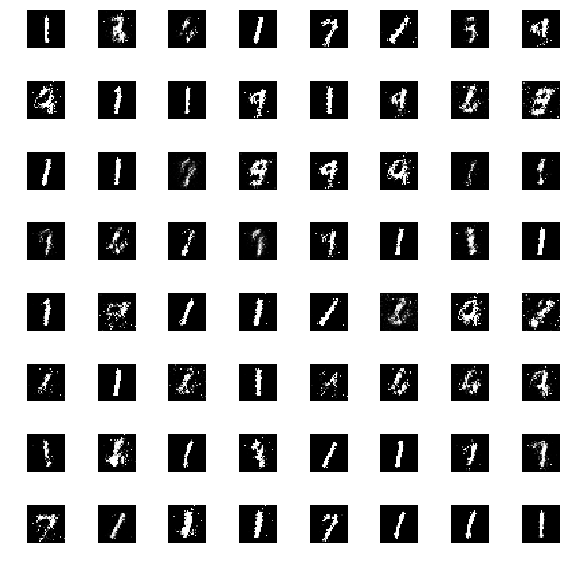

[Epoch 9/25] [Batch 500/938] [D loss: 0.22183793783187866] [G loss: 2.5220582485198975]


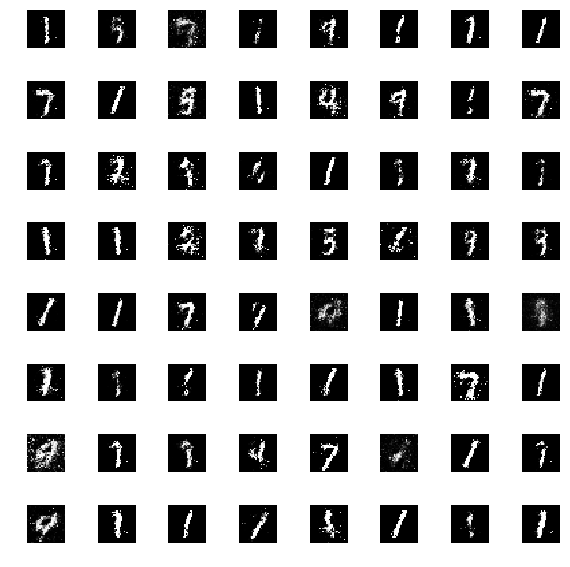

[Epoch 9/25] [Batch 600/938] [D loss: 0.27202779054641724] [G loss: 2.0804507732391357]


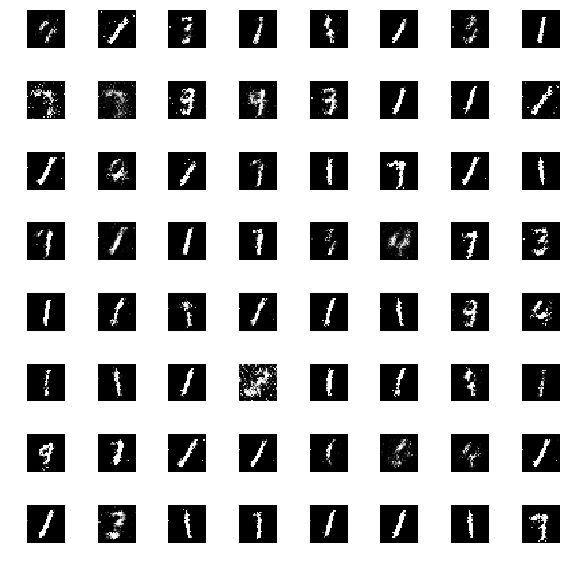

[Epoch 9/25] [Batch 700/938] [D loss: 0.23820291459560394] [G loss: 2.196202278137207]


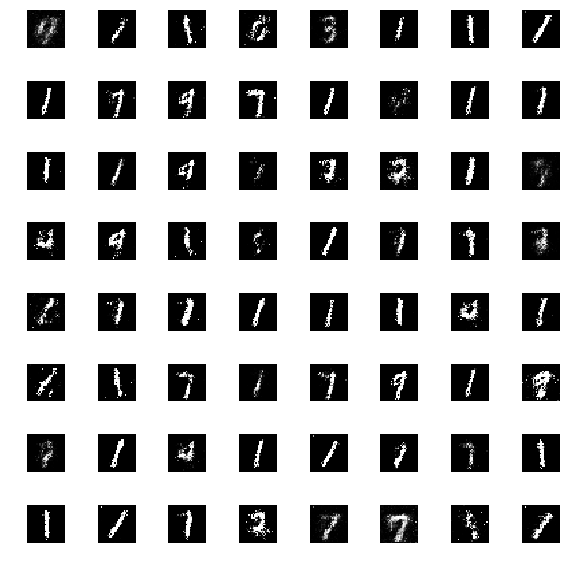

[Epoch 9/25] [Batch 800/938] [D loss: 0.22830957174301147] [G loss: 2.4504055976867676]


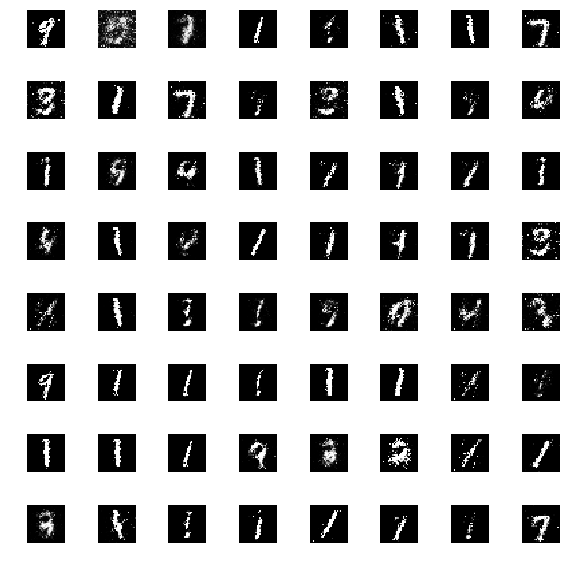

[Epoch 9/25] [Batch 900/938] [D loss: 0.2786691188812256] [G loss: 2.7555103302001953]


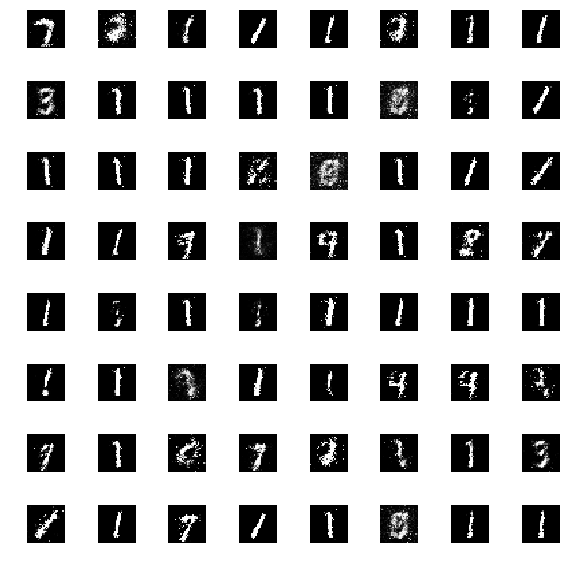

[Epoch 10/25] [Batch 0/938] [D loss: 0.3248044550418854] [G loss: 2.6196095943450928]


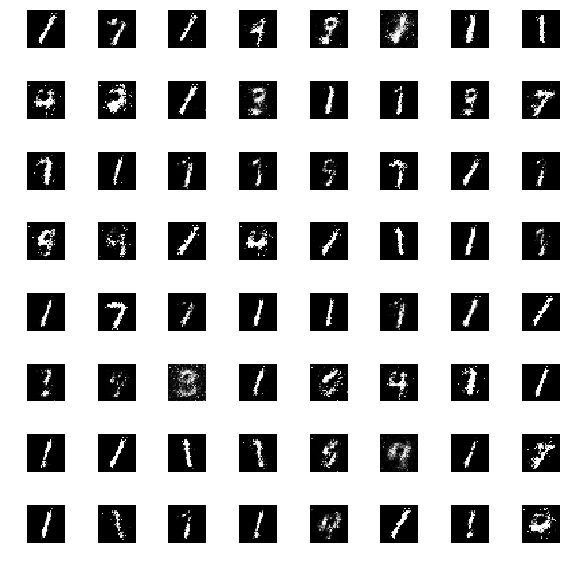

[Epoch 10/25] [Batch 100/938] [D loss: 0.276220440864563] [G loss: 2.3381400108337402]


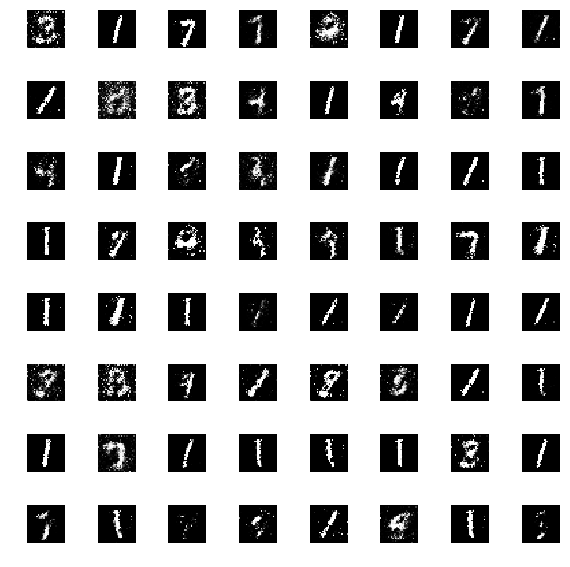

[Epoch 10/25] [Batch 200/938] [D loss: 0.30283159017562866] [G loss: 3.1150596141815186]


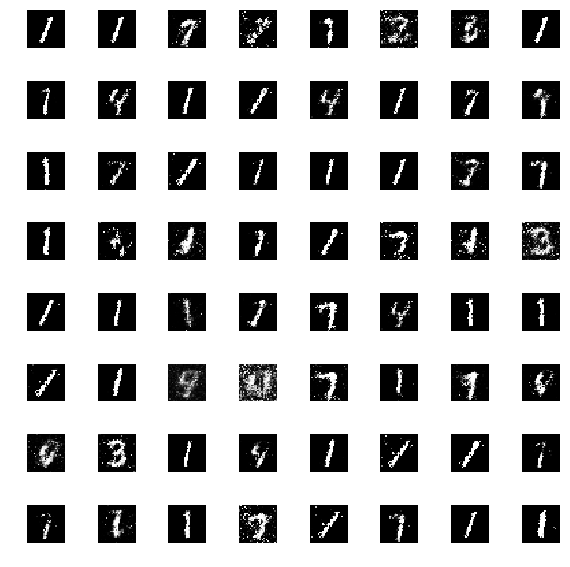

[Epoch 10/25] [Batch 300/938] [D loss: 0.25204998254776] [G loss: 2.089667320251465]


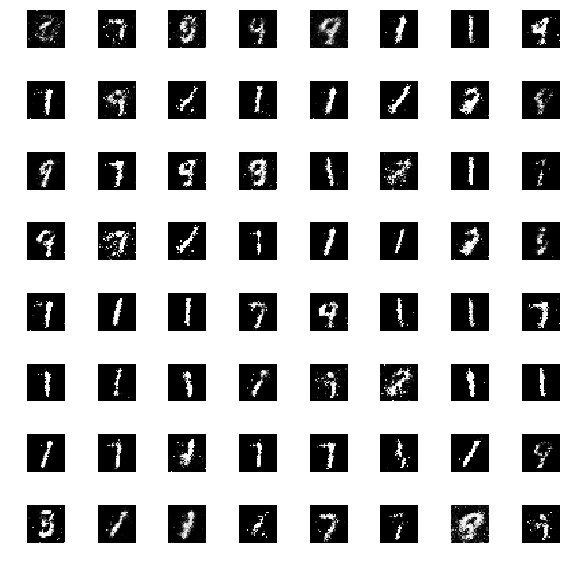

[Epoch 10/25] [Batch 400/938] [D loss: 0.2698360085487366] [G loss: 2.2780325412750244]


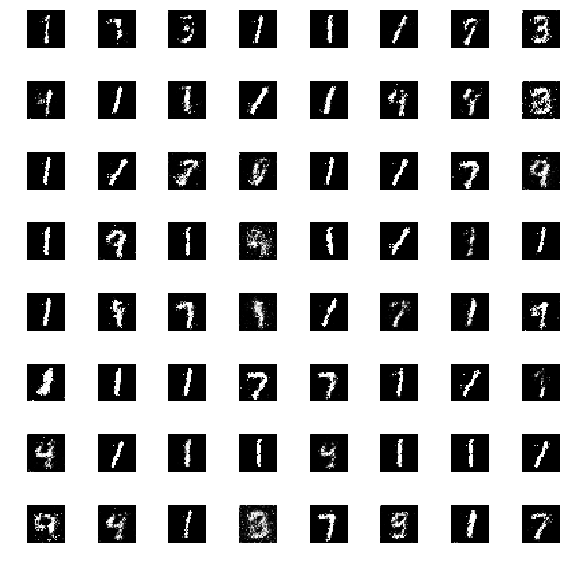

[Epoch 10/25] [Batch 500/938] [D loss: 0.28715357184410095] [G loss: 2.2986841201782227]


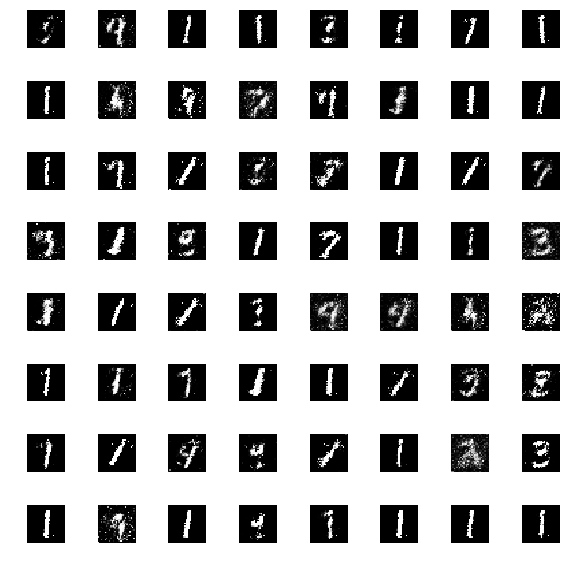

[Epoch 10/25] [Batch 600/938] [D loss: 0.22372502088546753] [G loss: 2.327500820159912]


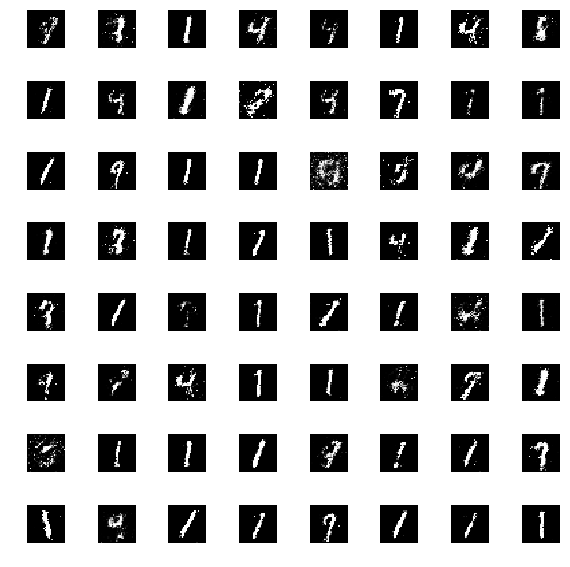

[Epoch 10/25] [Batch 700/938] [D loss: 0.29491016268730164] [G loss: 2.3647568225860596]


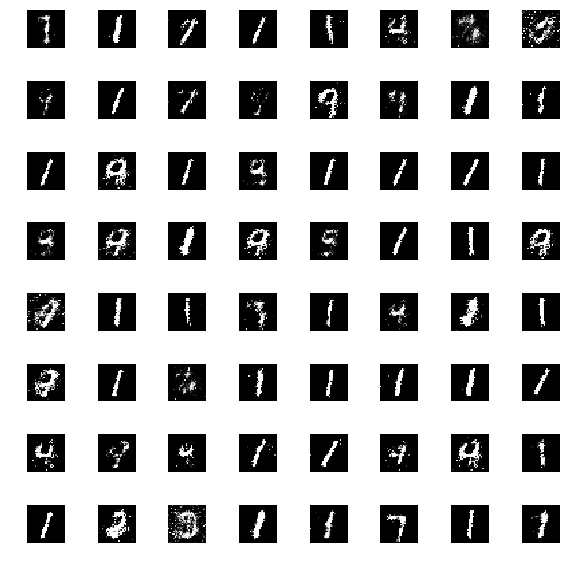

[Epoch 10/25] [Batch 800/938] [D loss: 0.35181447863578796] [G loss: 2.2868258953094482]


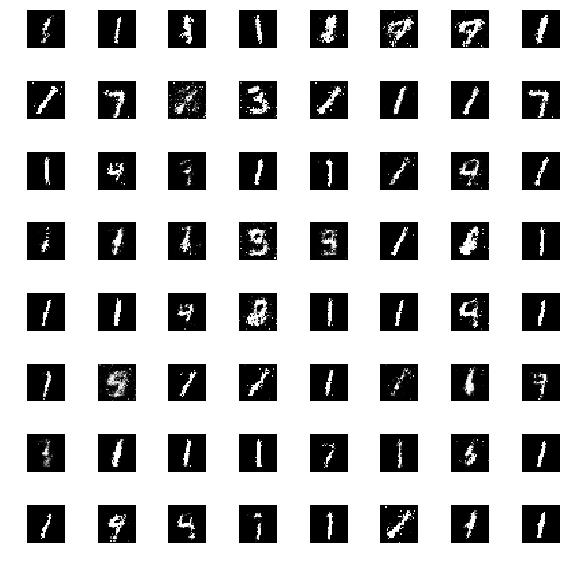

[Epoch 10/25] [Batch 900/938] [D loss: 0.36403387784957886] [G loss: 1.889665126800537]


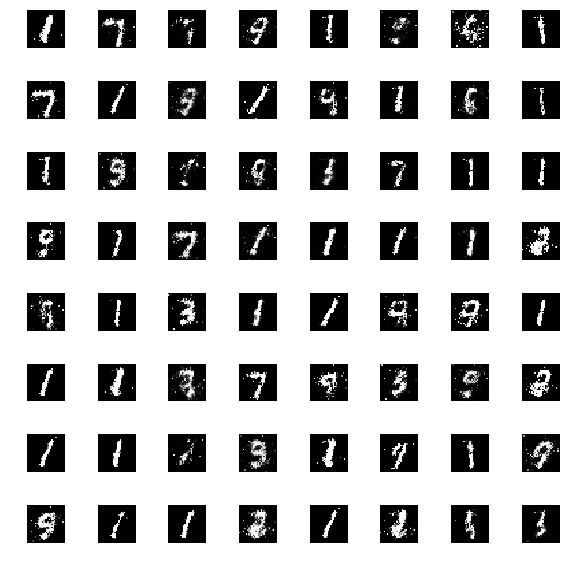

[Epoch 11/25] [Batch 0/938] [D loss: 0.31361958384513855] [G loss: 2.288473606109619]


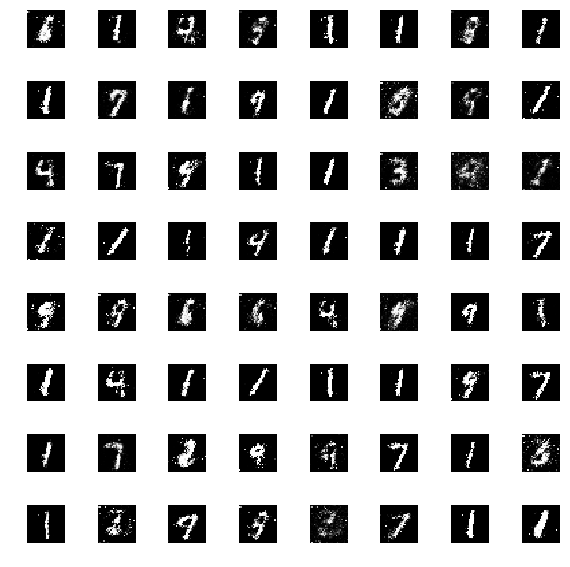

[Epoch 11/25] [Batch 100/938] [D loss: 0.3425092101097107] [G loss: 2.0643539428710938]


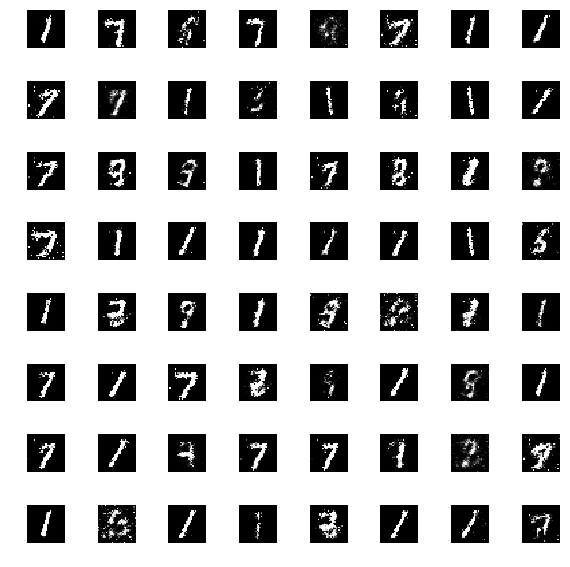

[Epoch 11/25] [Batch 200/938] [D loss: 0.31651630997657776] [G loss: 1.5852830410003662]


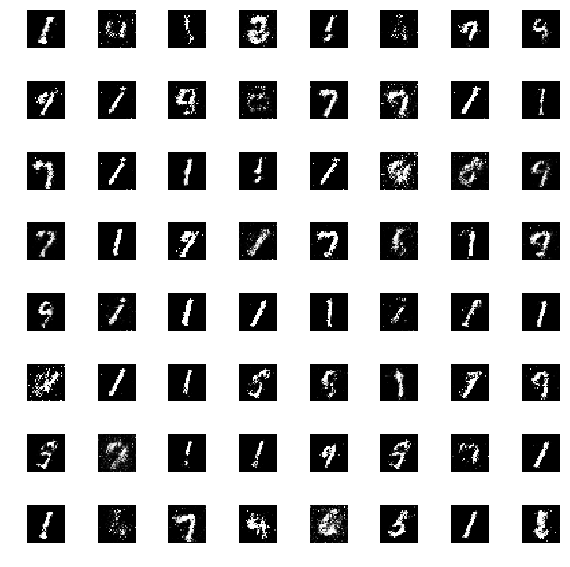

[Epoch 11/25] [Batch 300/938] [D loss: 0.4256824254989624] [G loss: 1.448197603225708]


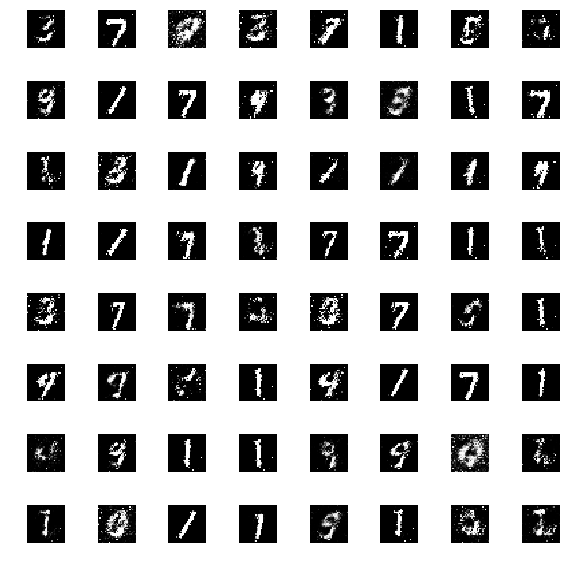

[Epoch 11/25] [Batch 400/938] [D loss: 0.2756742238998413] [G loss: 1.8985012769699097]


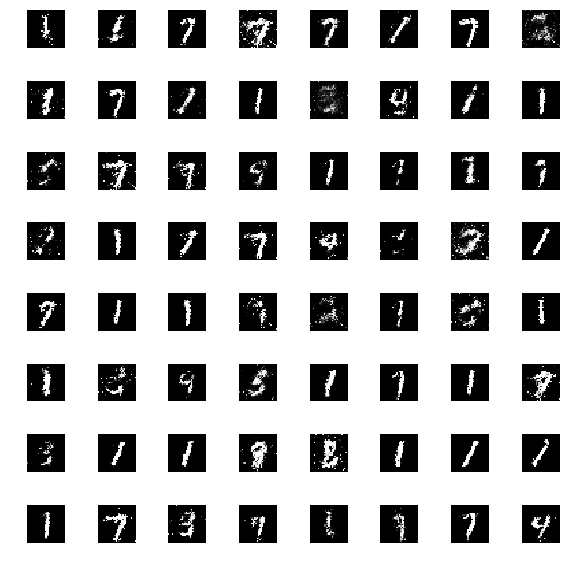

[Epoch 11/25] [Batch 500/938] [D loss: 0.34694766998291016] [G loss: 1.68206787109375]


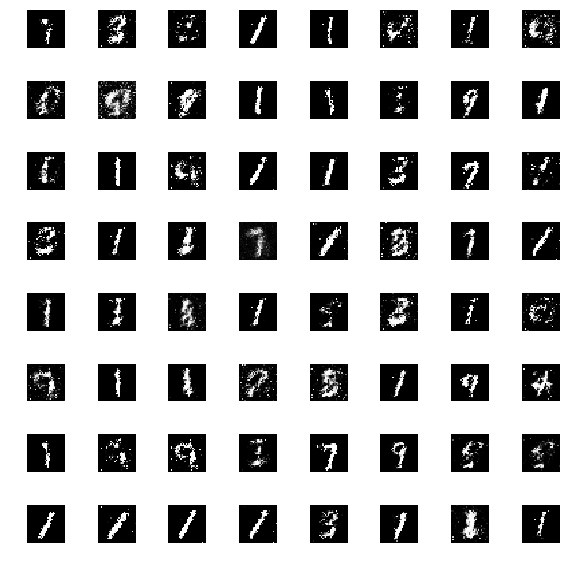

[Epoch 11/25] [Batch 600/938] [D loss: 0.4368821382522583] [G loss: 1.9563062191009521]


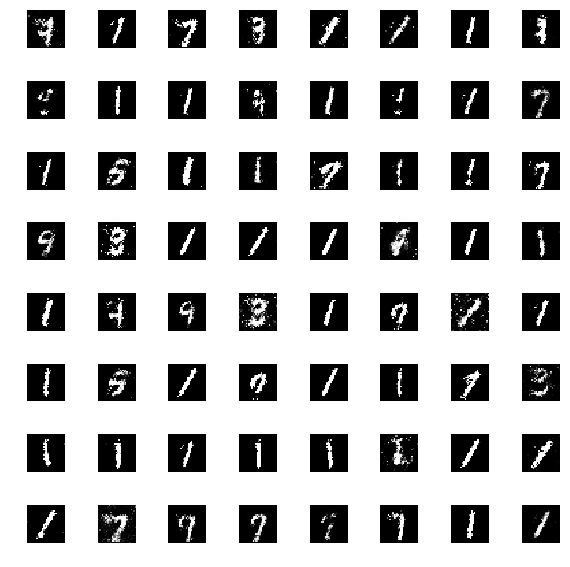

[Epoch 11/25] [Batch 700/938] [D loss: 0.3907361328601837] [G loss: 1.9546815156936646]


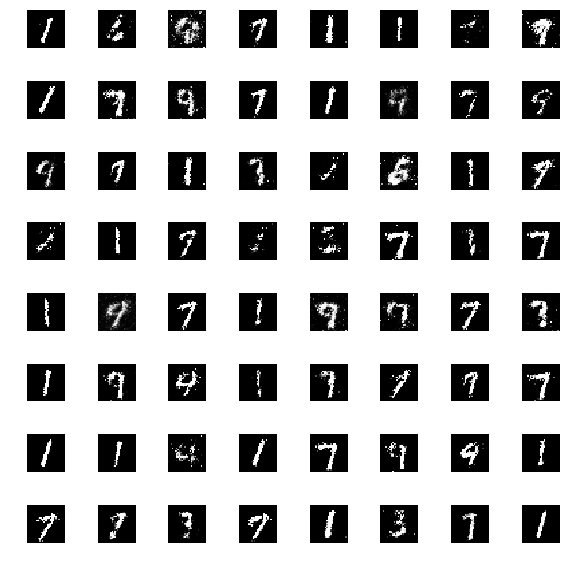

[Epoch 11/25] [Batch 800/938] [D loss: 0.36514610052108765] [G loss: 2.103032112121582]


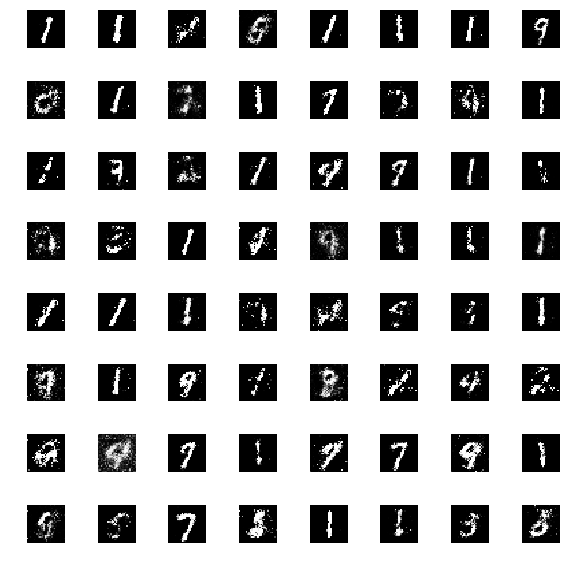

[Epoch 11/25] [Batch 900/938] [D loss: 0.32331883907318115] [G loss: 1.920583724975586]


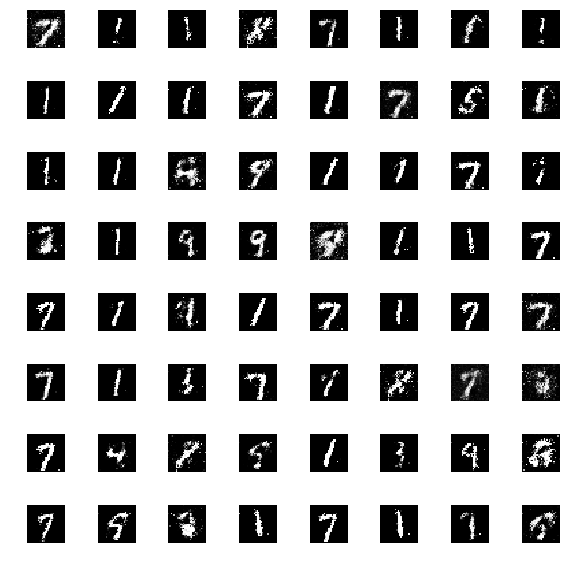

[Epoch 12/25] [Batch 0/938] [D loss: 0.2830750346183777] [G loss: 1.985802173614502]


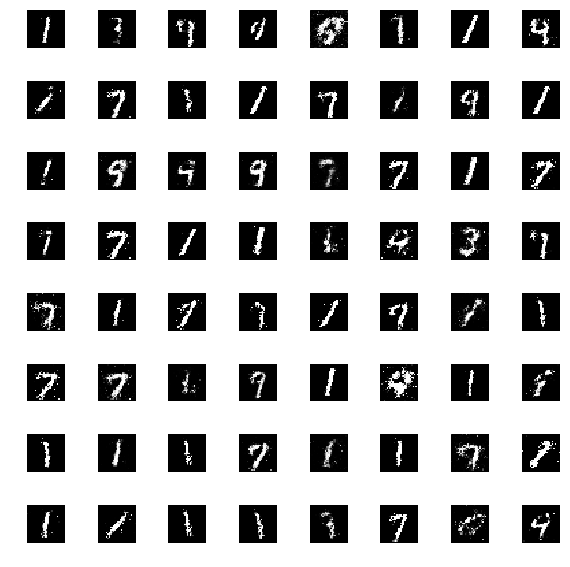

[Epoch 12/25] [Batch 100/938] [D loss: 0.1982373148202896] [G loss: 2.0642082691192627]


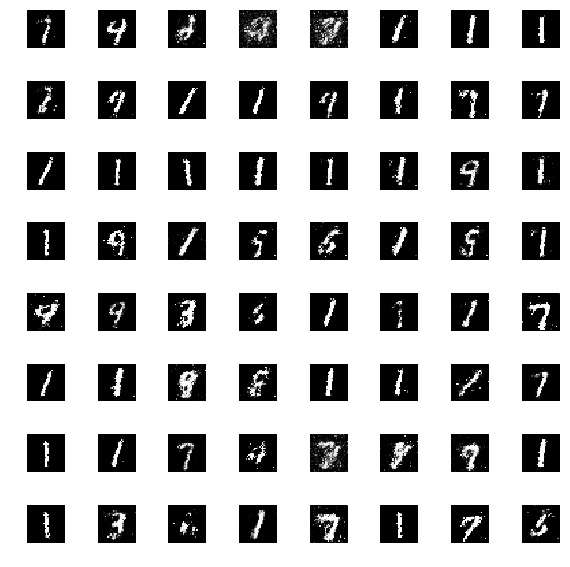

[Epoch 12/25] [Batch 200/938] [D loss: 0.3001396656036377] [G loss: 1.9567360877990723]


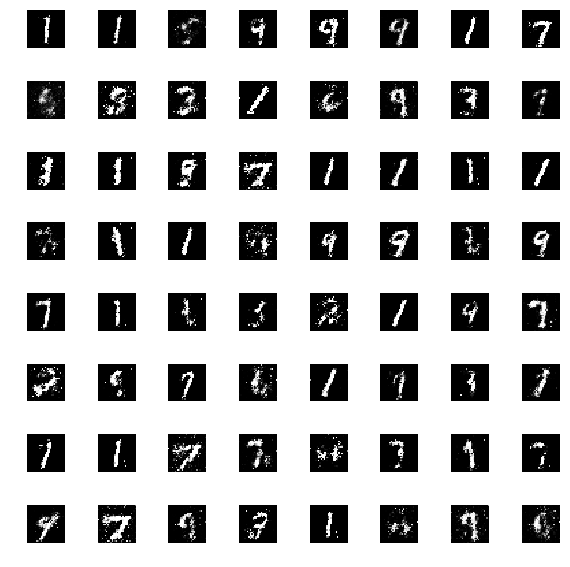

[Epoch 12/25] [Batch 300/938] [D loss: 0.2866699695587158] [G loss: 2.095036029815674]


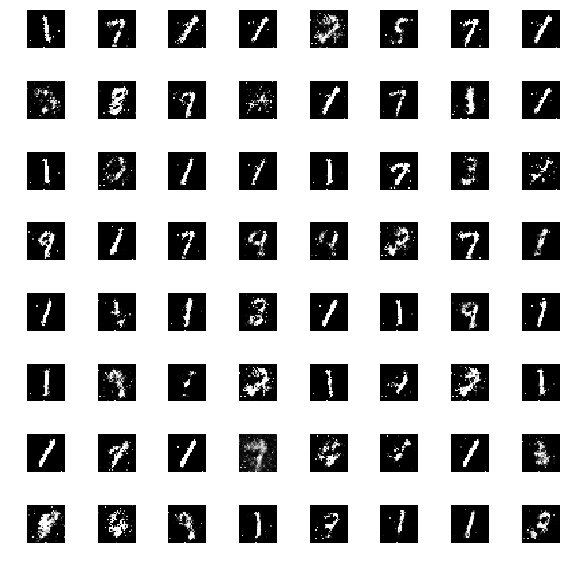

[Epoch 12/25] [Batch 400/938] [D loss: 0.36666882038116455] [G loss: 1.8440037965774536]


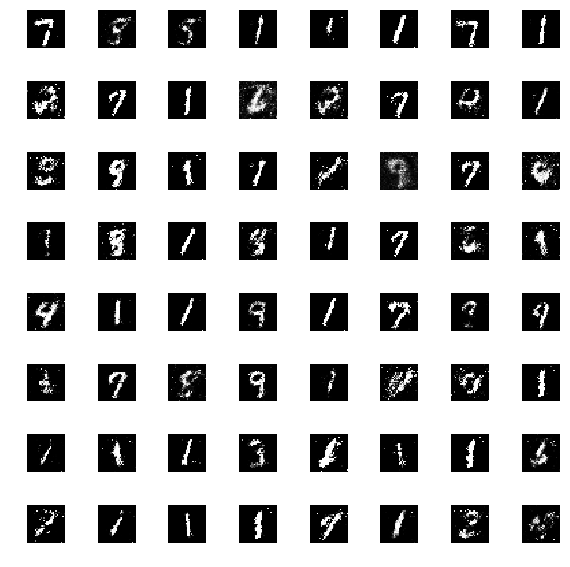

[Epoch 12/25] [Batch 500/938] [D loss: 0.4312480688095093] [G loss: 1.8264864683151245]


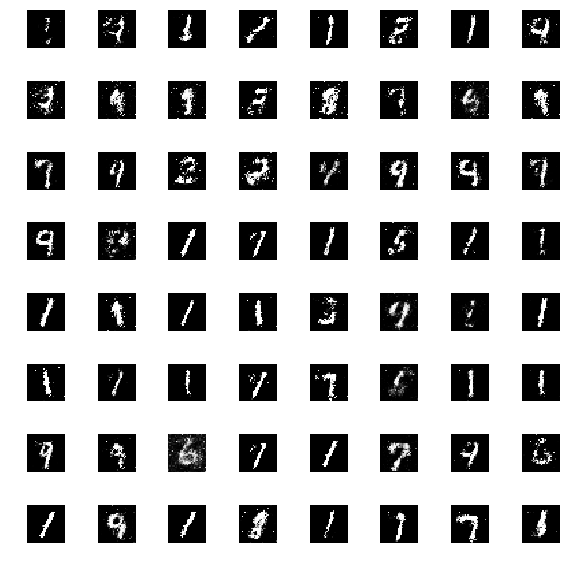

[Epoch 12/25] [Batch 600/938] [D loss: 0.3620554506778717] [G loss: 2.310396194458008]


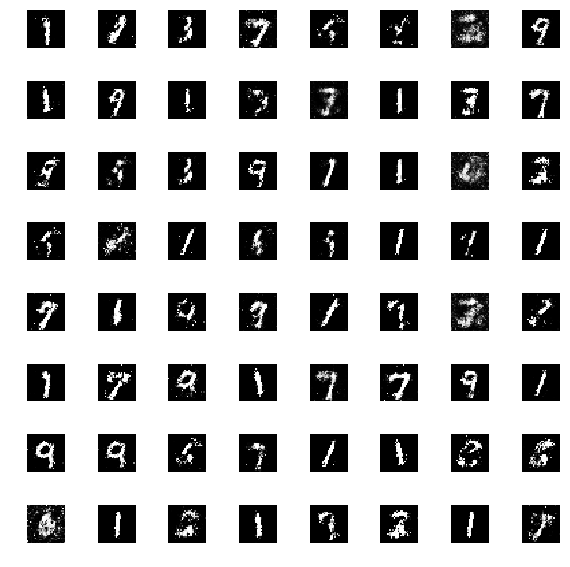

[Epoch 12/25] [Batch 700/938] [D loss: 0.39397183060646057] [G loss: 2.094348192214966]


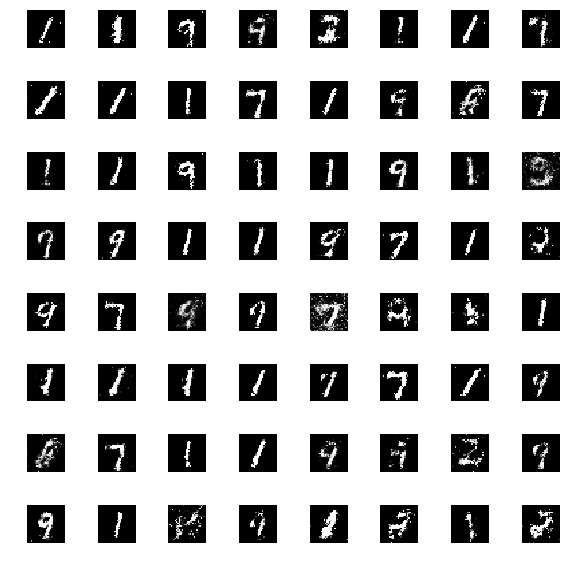

[Epoch 12/25] [Batch 800/938] [D loss: 0.3857323229312897] [G loss: 1.8235907554626465]


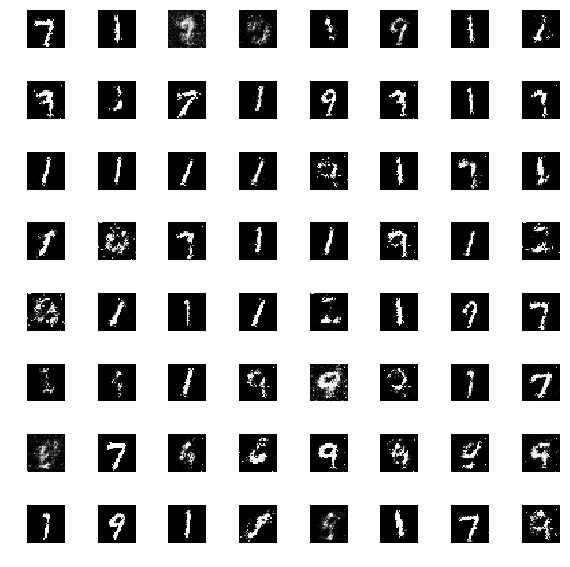

[Epoch 12/25] [Batch 900/938] [D loss: 0.28972041606903076] [G loss: 1.8482229709625244]


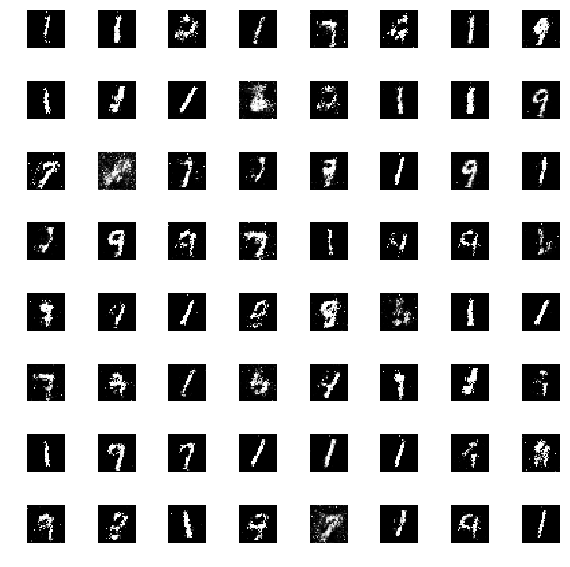

[Epoch 13/25] [Batch 0/938] [D loss: 0.35884004831314087] [G loss: 2.342010974884033]


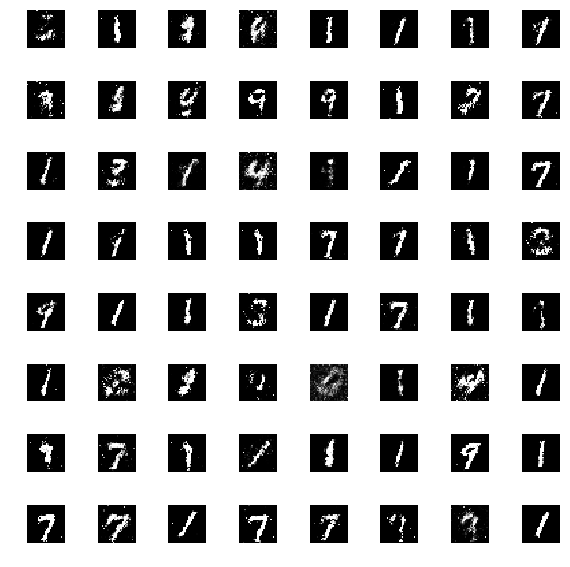

[Epoch 13/25] [Batch 100/938] [D loss: 0.31368082761764526] [G loss: 1.8793669939041138]


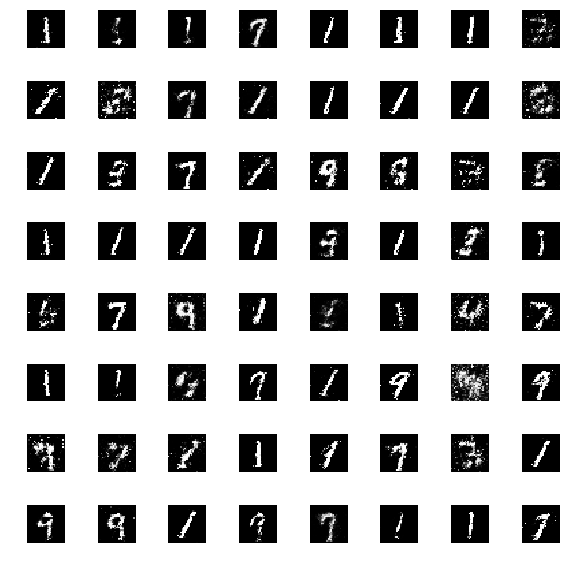

[Epoch 13/25] [Batch 200/938] [D loss: 0.32026323676109314] [G loss: 1.6445534229278564]


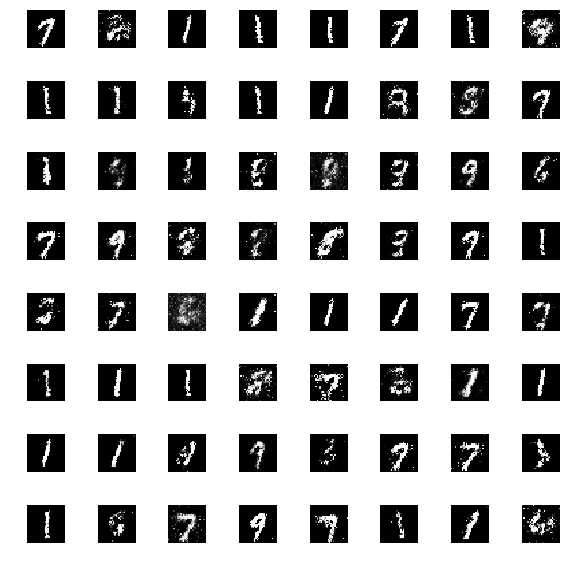

[Epoch 13/25] [Batch 300/938] [D loss: 0.3631781041622162] [G loss: 1.5563530921936035]


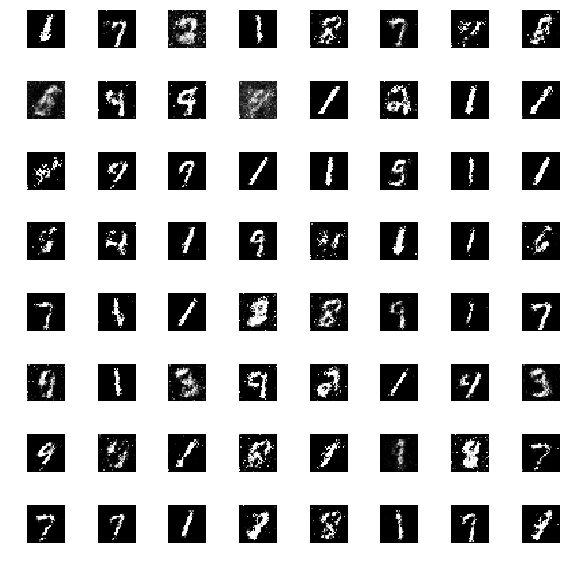

[Epoch 13/25] [Batch 400/938] [D loss: 0.3815957009792328] [G loss: 1.638903021812439]


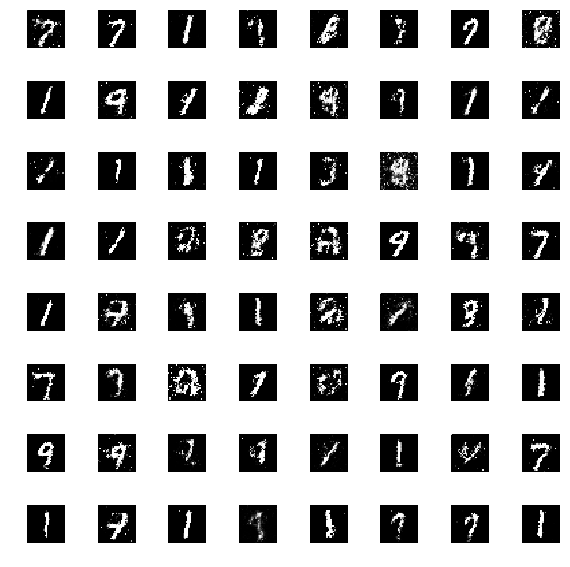

[Epoch 13/25] [Batch 500/938] [D loss: 0.3833947479724884] [G loss: 1.643202304840088]


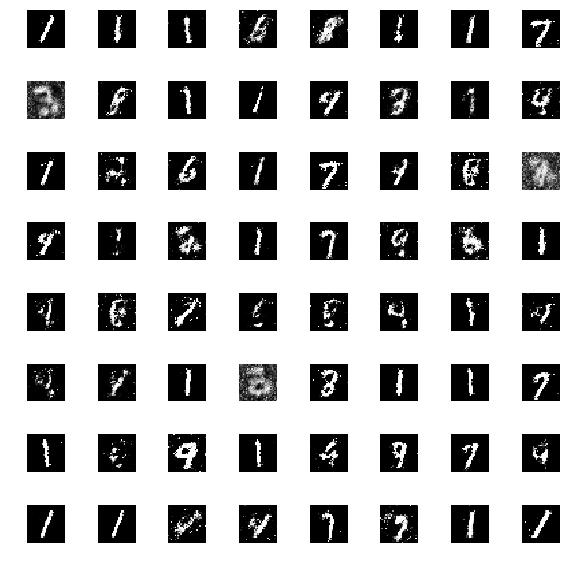

[Epoch 13/25] [Batch 600/938] [D loss: 0.41217881441116333] [G loss: 1.561160683631897]


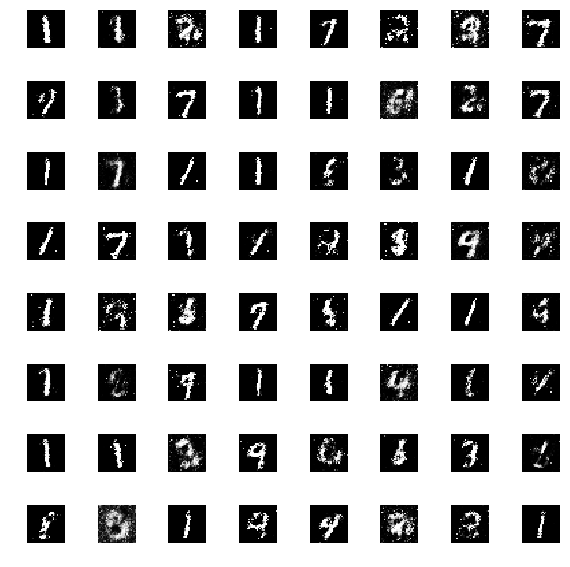

[Epoch 13/25] [Batch 700/938] [D loss: 0.39148640632629395] [G loss: 1.5260543823242188]


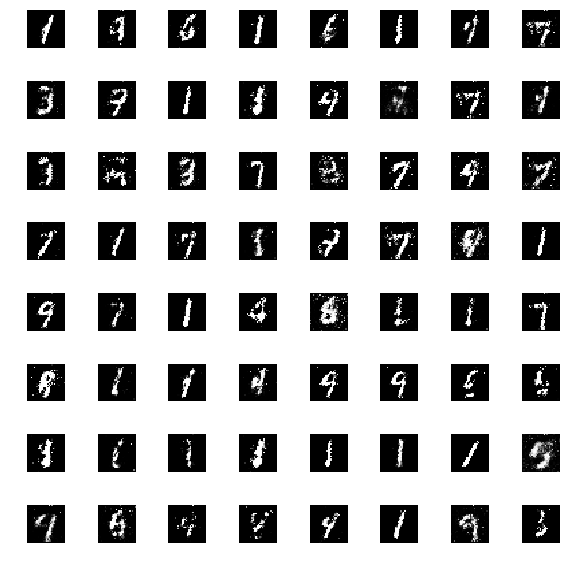

[Epoch 13/25] [Batch 800/938] [D loss: 0.44892746210098267] [G loss: 1.509271502494812]


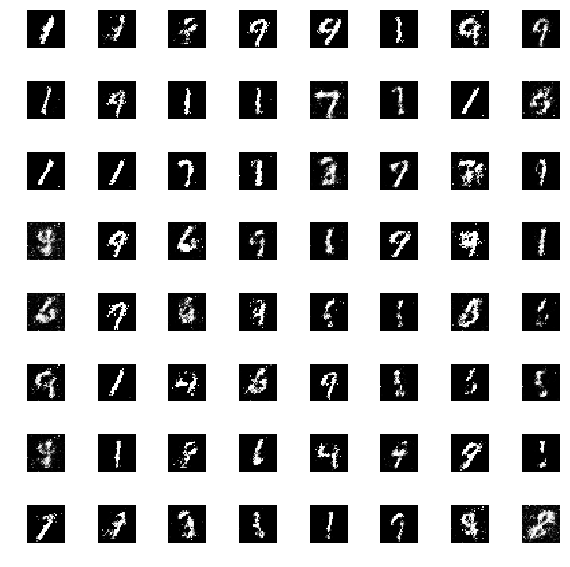

[Epoch 13/25] [Batch 900/938] [D loss: 0.4211657643318176] [G loss: 1.540277361869812]


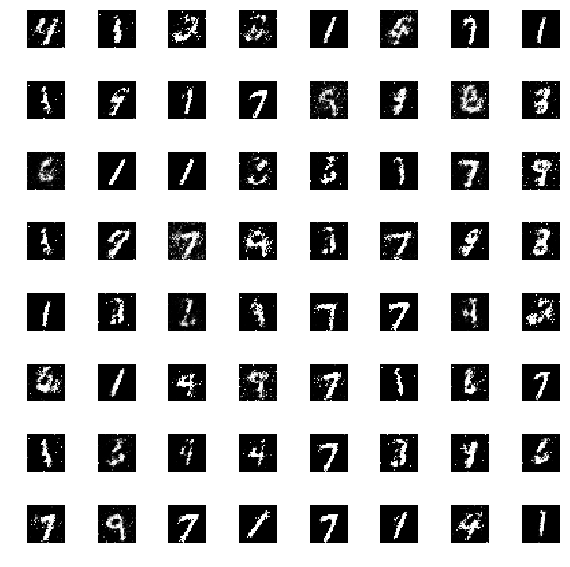

[Epoch 14/25] [Batch 0/938] [D loss: 0.33728405833244324] [G loss: 1.7013146877288818]


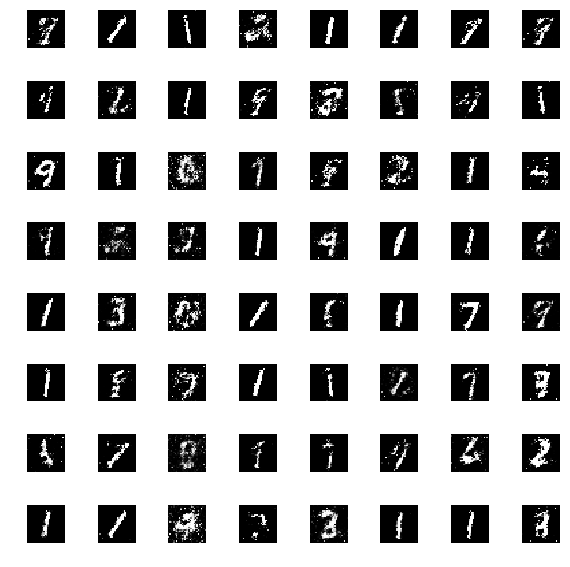

[Epoch 14/25] [Batch 100/938] [D loss: 0.38898688554763794] [G loss: 1.6232030391693115]


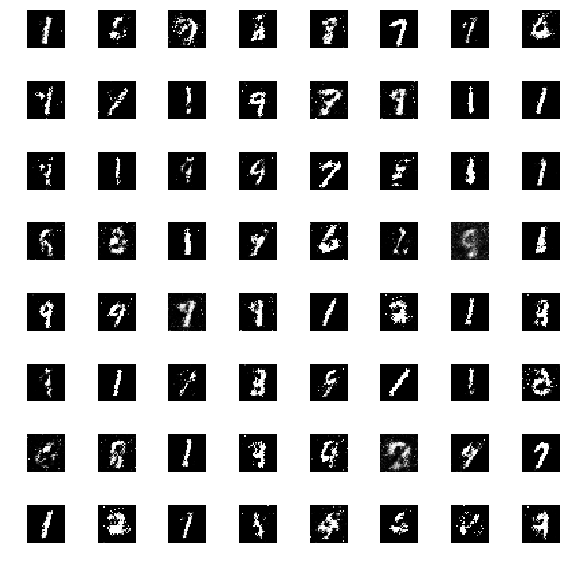

[Epoch 14/25] [Batch 200/938] [D loss: 0.4587358832359314] [G loss: 1.5199729204177856]


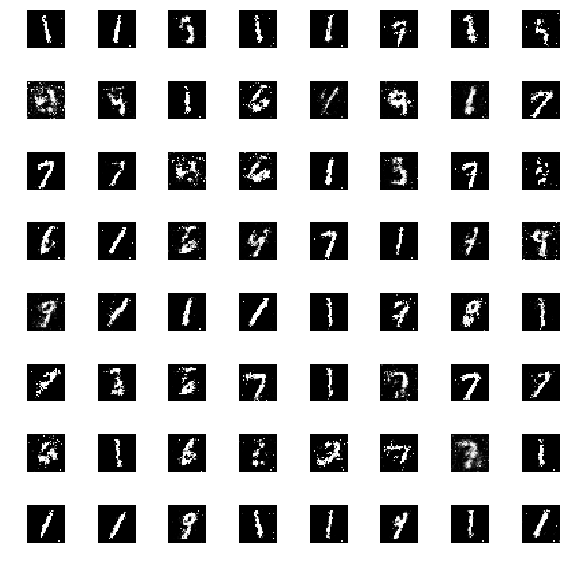

[Epoch 14/25] [Batch 300/938] [D loss: 0.36173784732818604] [G loss: 1.602129578590393]


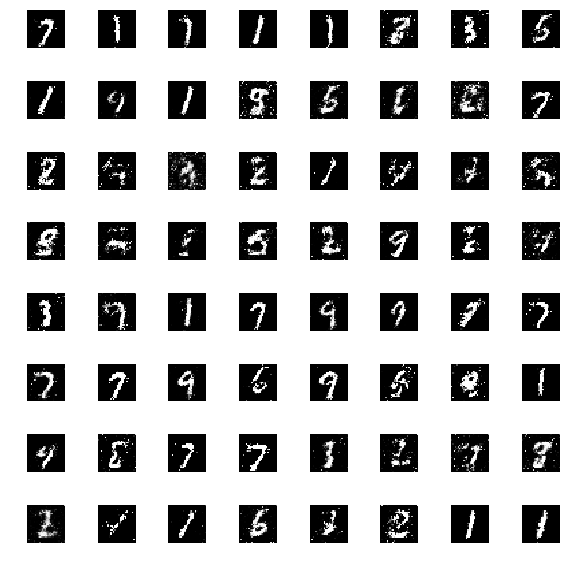

[Epoch 14/25] [Batch 400/938] [D loss: 0.3938753604888916] [G loss: 1.7262287139892578]


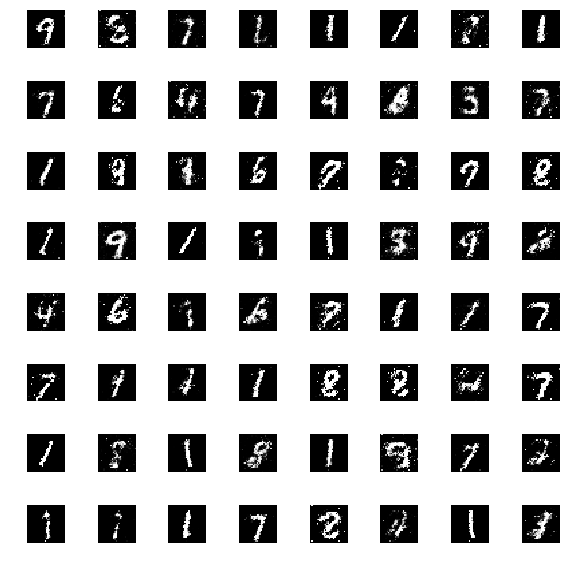

[Epoch 14/25] [Batch 500/938] [D loss: 0.39185577630996704] [G loss: 1.396651268005371]


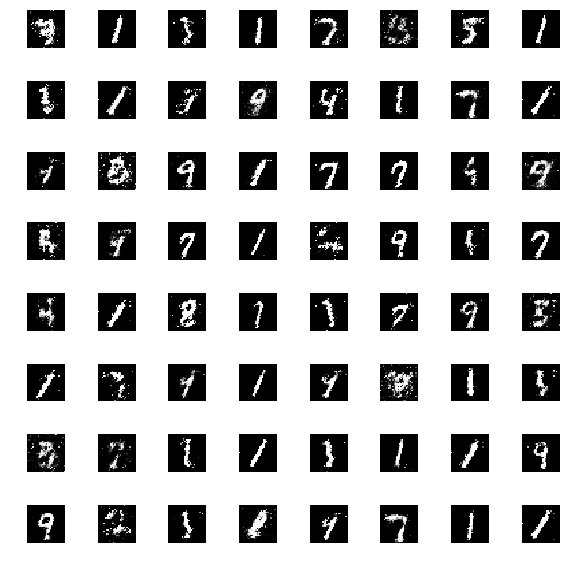

[Epoch 14/25] [Batch 600/938] [D loss: 0.37278515100479126] [G loss: 1.8894039392471313]


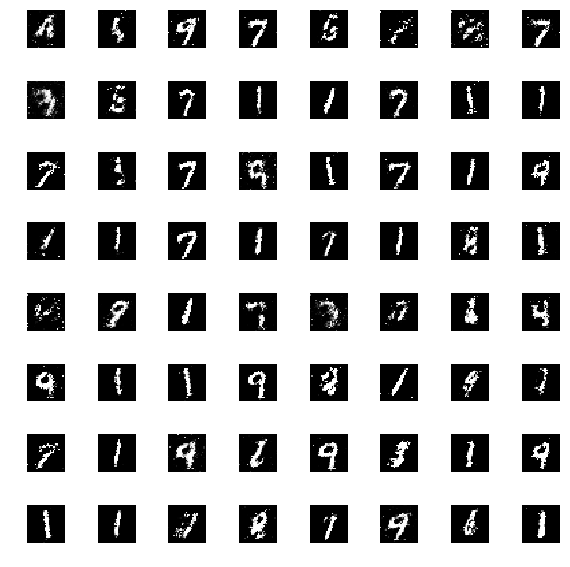

[Epoch 14/25] [Batch 700/938] [D loss: 0.4321557283401489] [G loss: 1.6185718774795532]


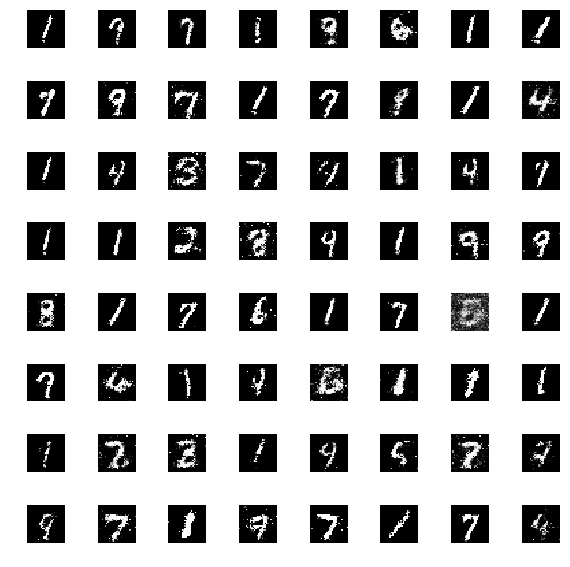

[Epoch 14/25] [Batch 800/938] [D loss: 0.48825904726982117] [G loss: 1.3061776161193848]


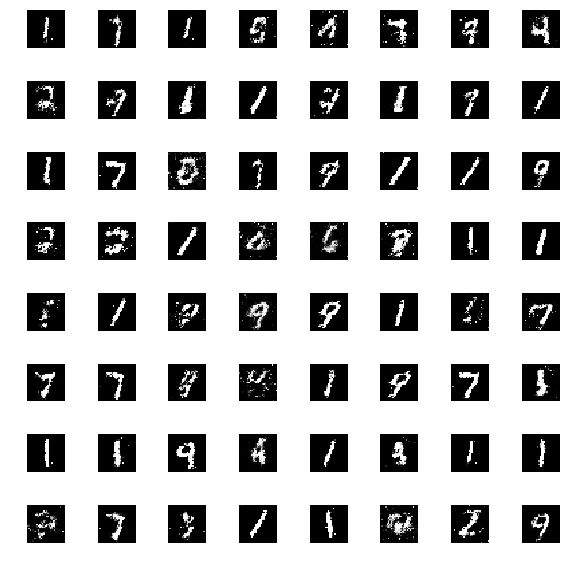

[Epoch 14/25] [Batch 900/938] [D loss: 0.41982489824295044] [G loss: 1.3519264459609985]


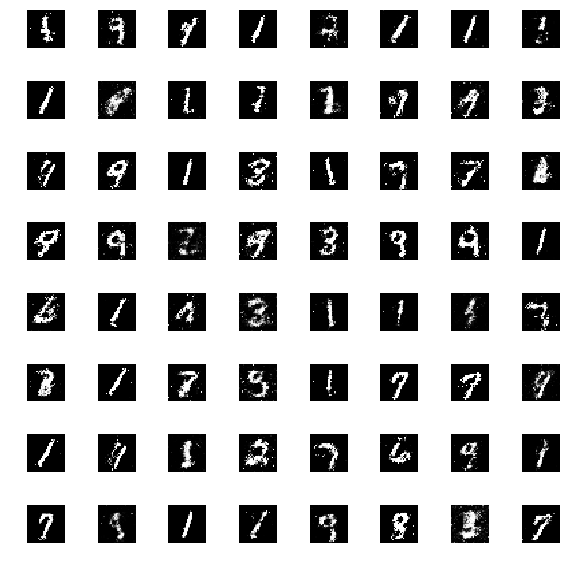

[Epoch 15/25] [Batch 0/938] [D loss: 0.38177937269210815] [G loss: 1.5574367046356201]


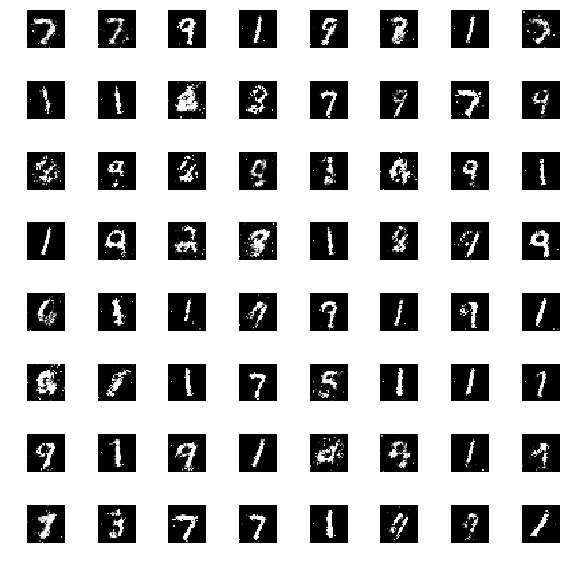

[Epoch 15/25] [Batch 100/938] [D loss: 0.4097440242767334] [G loss: 1.547807216644287]


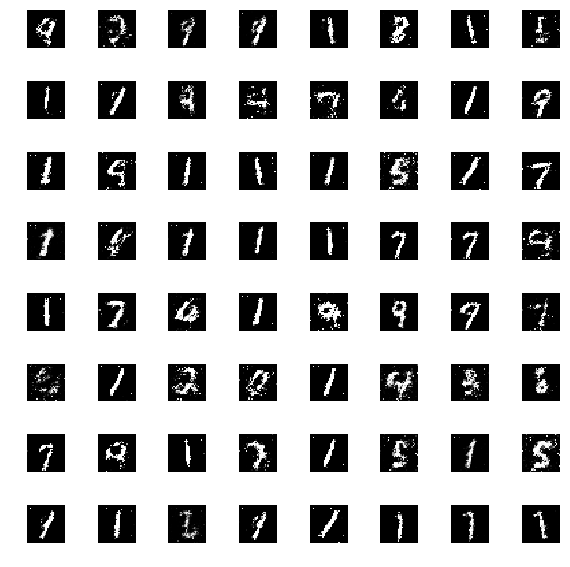

[Epoch 15/25] [Batch 200/938] [D loss: 0.4429185092449188] [G loss: 1.6573861837387085]


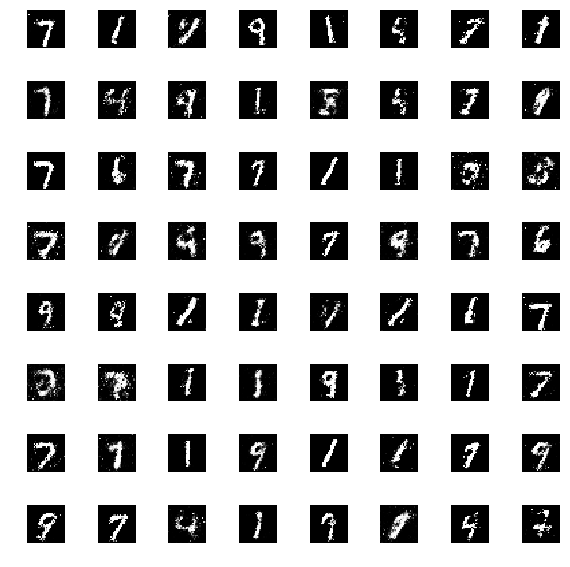

[Epoch 15/25] [Batch 300/938] [D loss: 0.45925086736679077] [G loss: 1.6598235368728638]


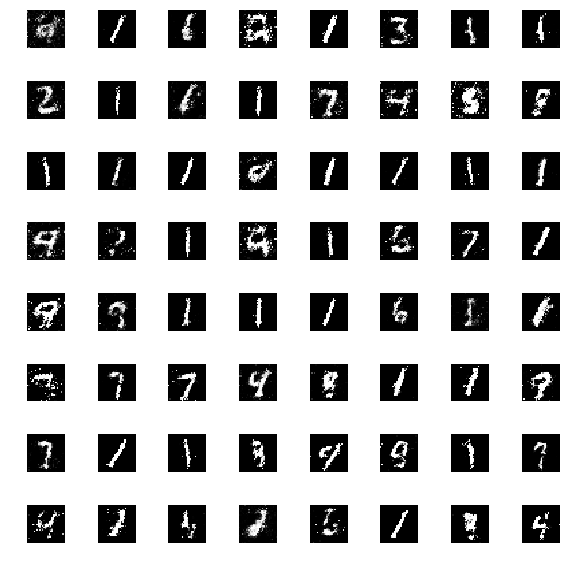

[Epoch 15/25] [Batch 400/938] [D loss: 0.40442317724227905] [G loss: 1.4165219068527222]


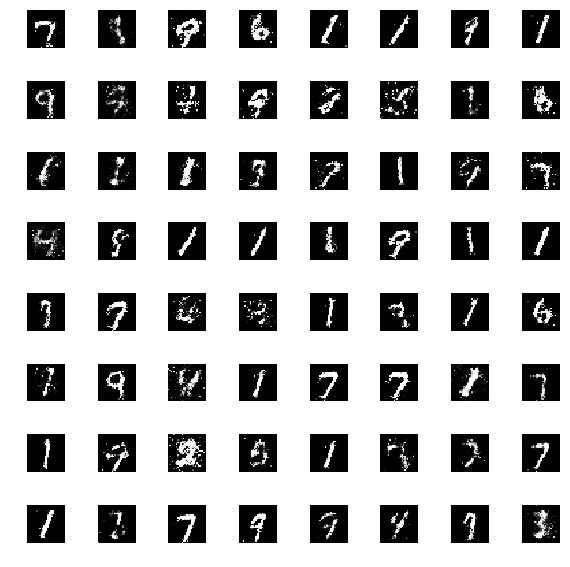

[Epoch 15/25] [Batch 500/938] [D loss: 0.43938976526260376] [G loss: 1.632605791091919]


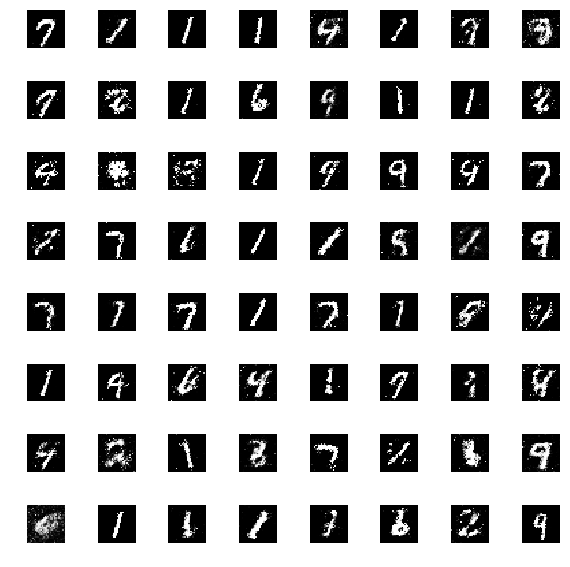

[Epoch 15/25] [Batch 600/938] [D loss: 0.45076650381088257] [G loss: 1.4964380264282227]


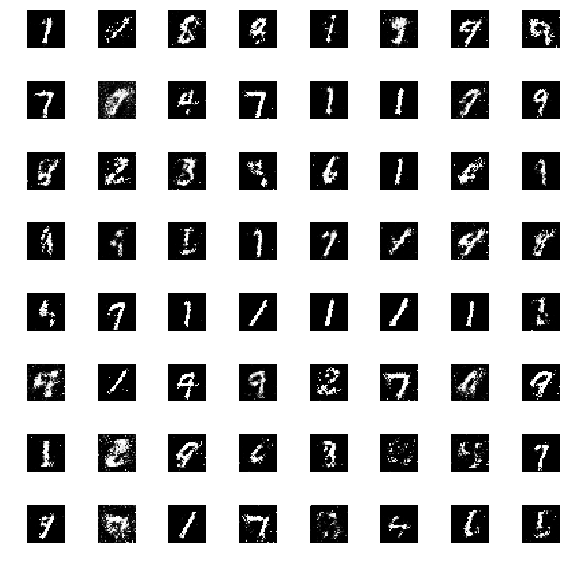

[Epoch 15/25] [Batch 700/938] [D loss: 0.419960081577301] [G loss: 1.5427427291870117]


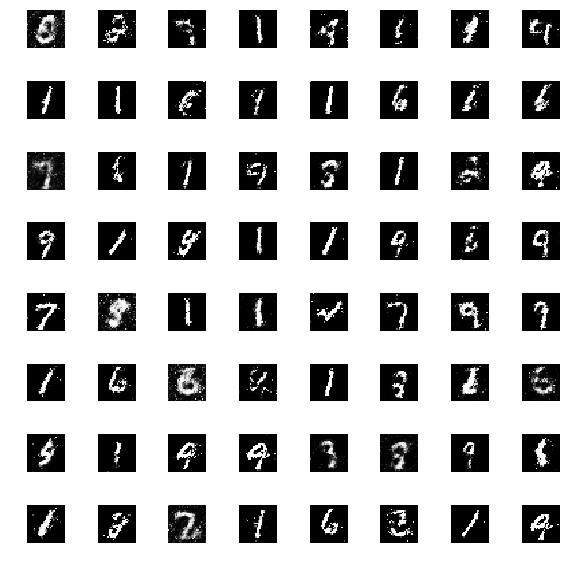

[Epoch 15/25] [Batch 800/938] [D loss: 0.5826386213302612] [G loss: 1.2962905168533325]


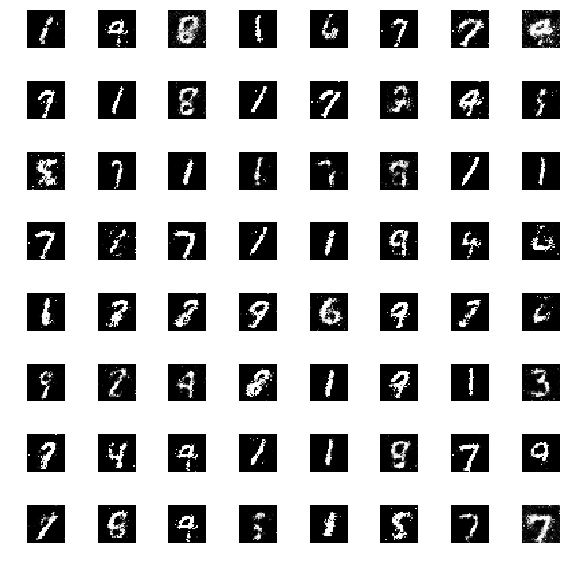

[Epoch 15/25] [Batch 900/938] [D loss: 0.3519696593284607] [G loss: 1.6604149341583252]


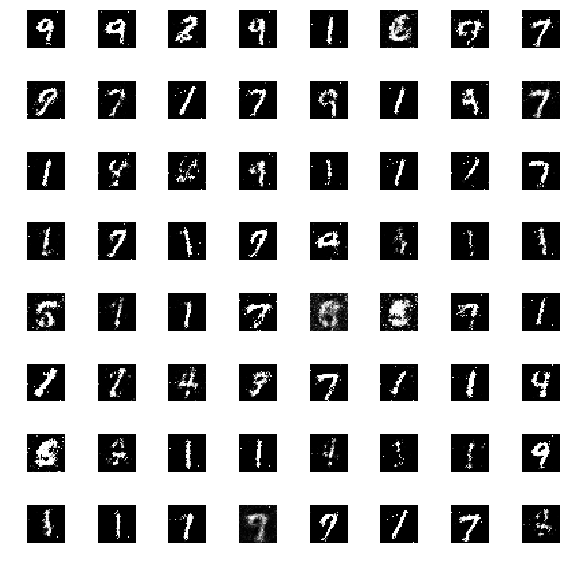

[Epoch 16/25] [Batch 0/938] [D loss: 0.419258713722229] [G loss: 1.8175768852233887]


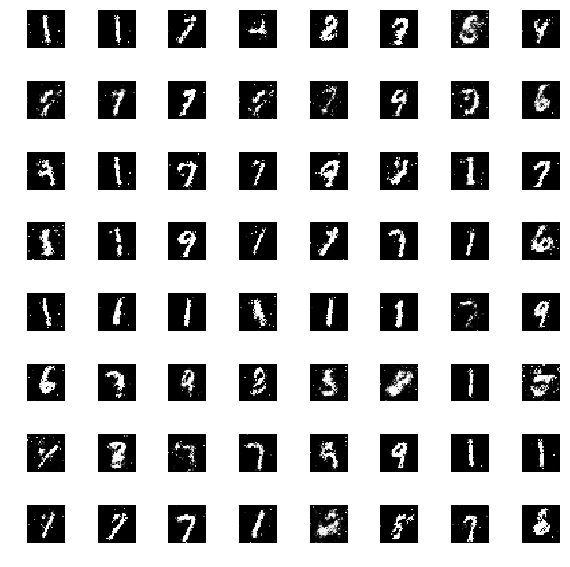

[Epoch 16/25] [Batch 100/938] [D loss: 0.45065435767173767] [G loss: 1.5939600467681885]


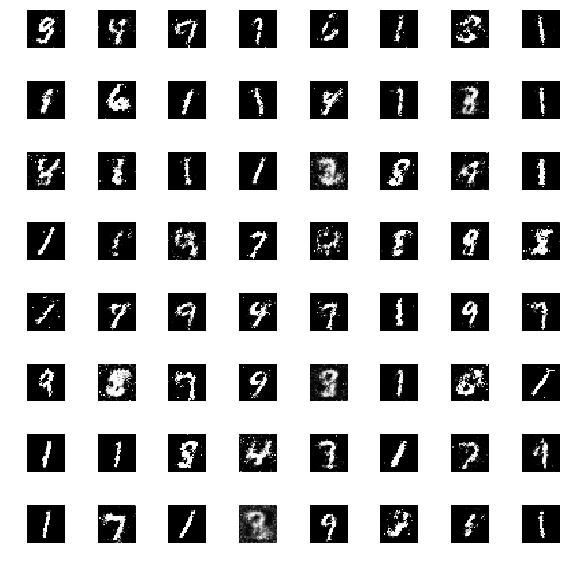

[Epoch 16/25] [Batch 200/938] [D loss: 0.5542727708816528] [G loss: 1.2294455766677856]


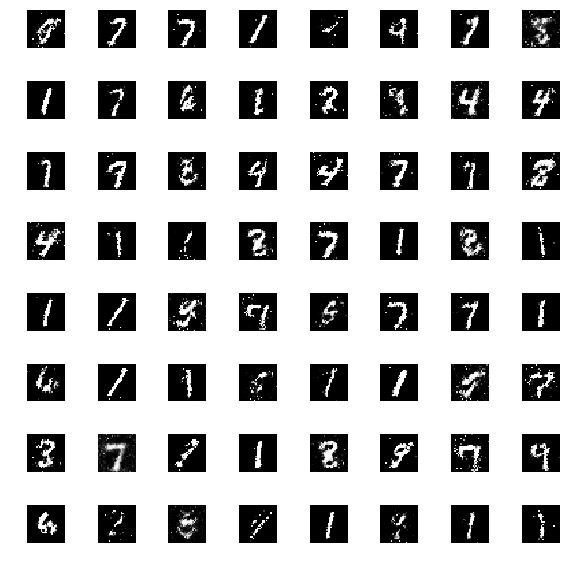

[Epoch 16/25] [Batch 300/938] [D loss: 0.37054672837257385] [G loss: 1.5193501710891724]


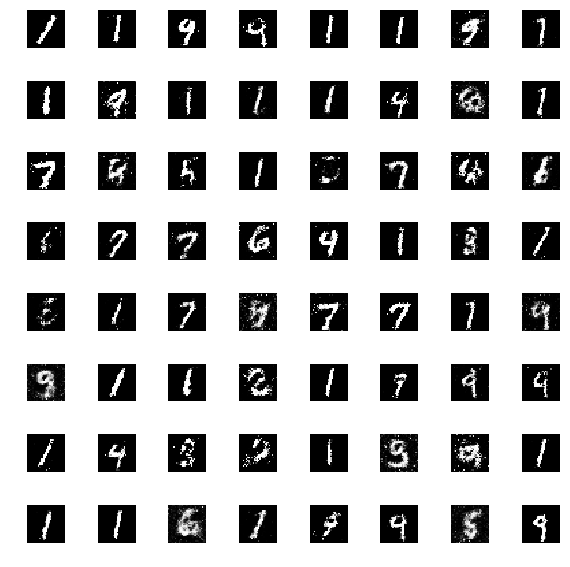

[Epoch 16/25] [Batch 400/938] [D loss: 0.44944578409194946] [G loss: 1.4587706327438354]


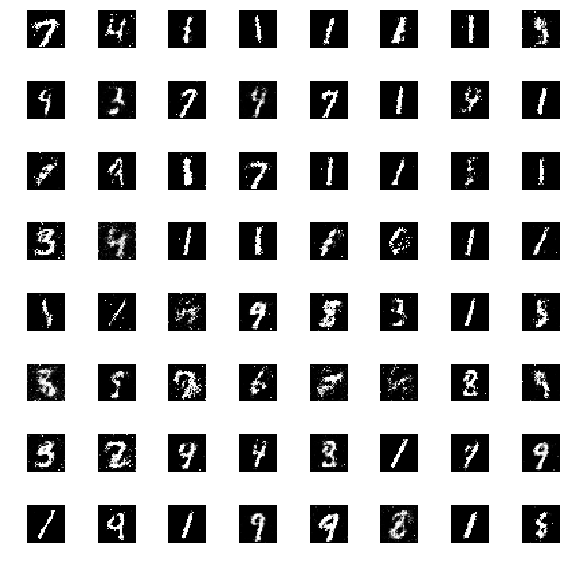

[Epoch 16/25] [Batch 500/938] [D loss: 0.46943598985671997] [G loss: 1.155922532081604]


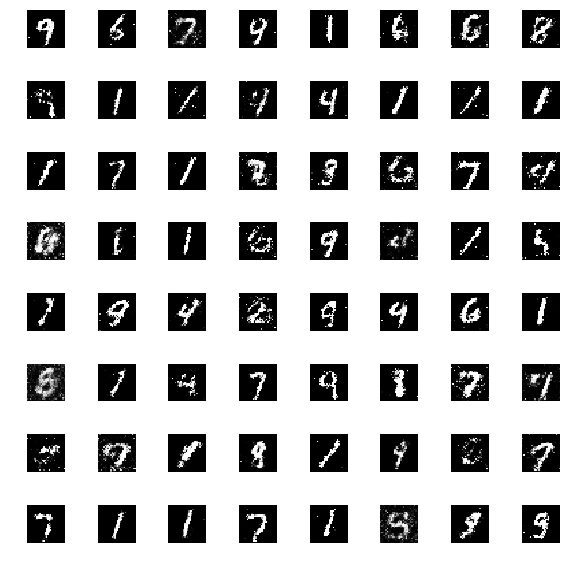

[Epoch 16/25] [Batch 600/938] [D loss: 0.4139157235622406] [G loss: 1.4915332794189453]


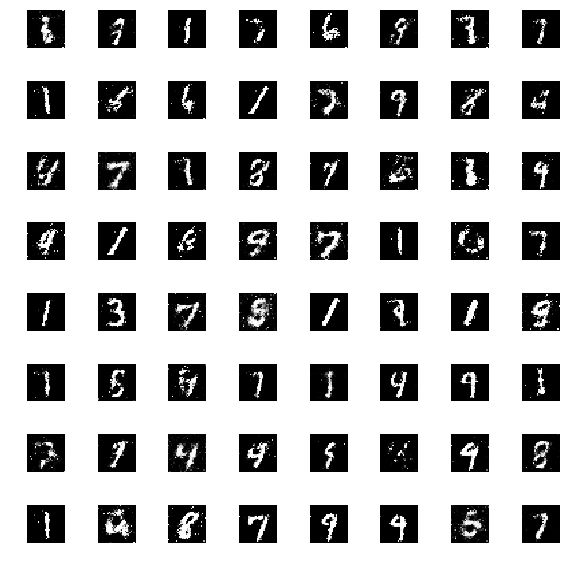

[Epoch 16/25] [Batch 700/938] [D loss: 0.4276259243488312] [G loss: 1.3229728937149048]


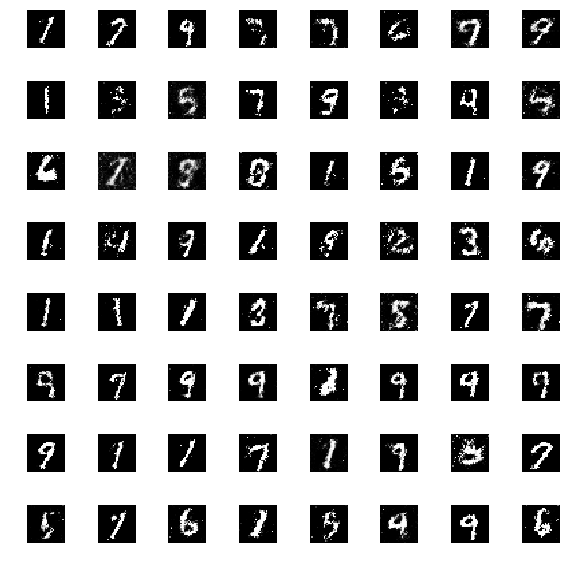

[Epoch 16/25] [Batch 800/938] [D loss: 0.3759020268917084] [G loss: 1.4566802978515625]


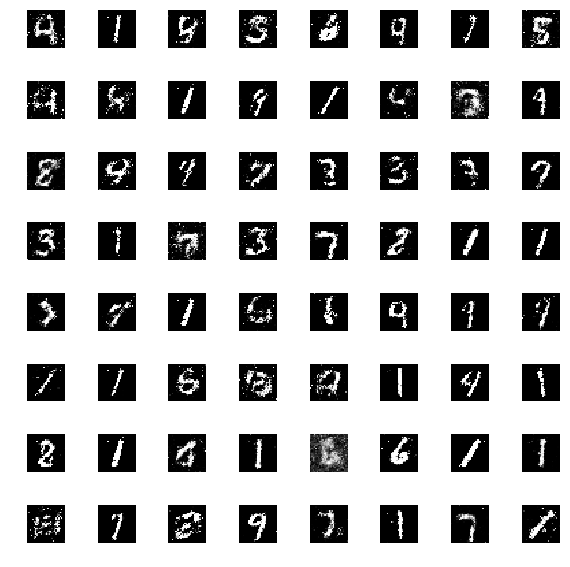

[Epoch 16/25] [Batch 900/938] [D loss: 0.48366406559944153] [G loss: 1.4126938581466675]


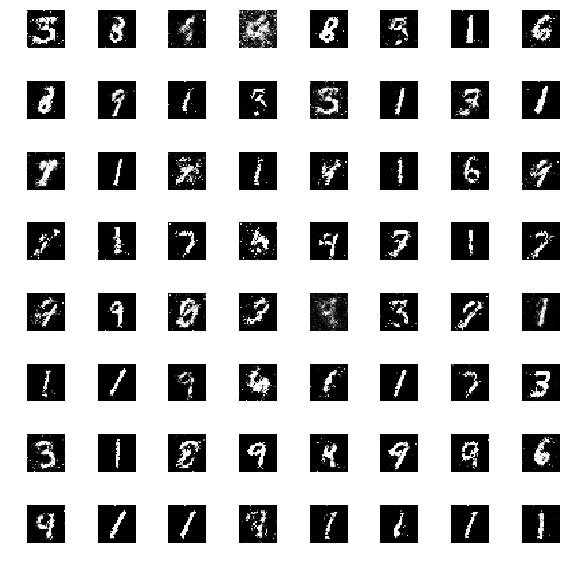

[Epoch 17/25] [Batch 0/938] [D loss: 0.45116299390792847] [G loss: 1.7030904293060303]


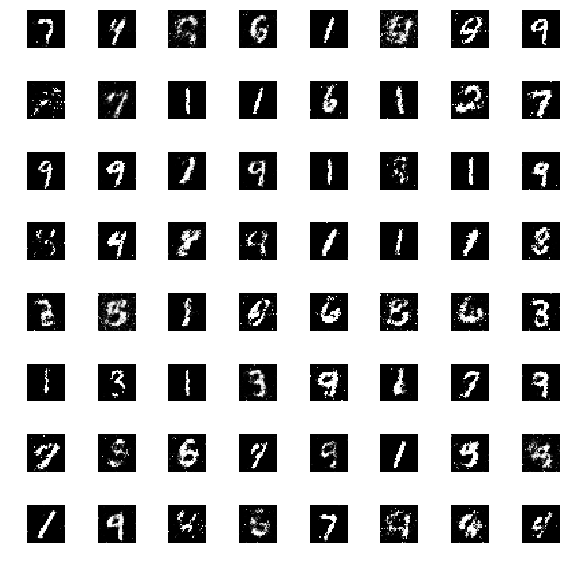

[Epoch 17/25] [Batch 100/938] [D loss: 0.42922043800354004] [G loss: 1.4102823734283447]


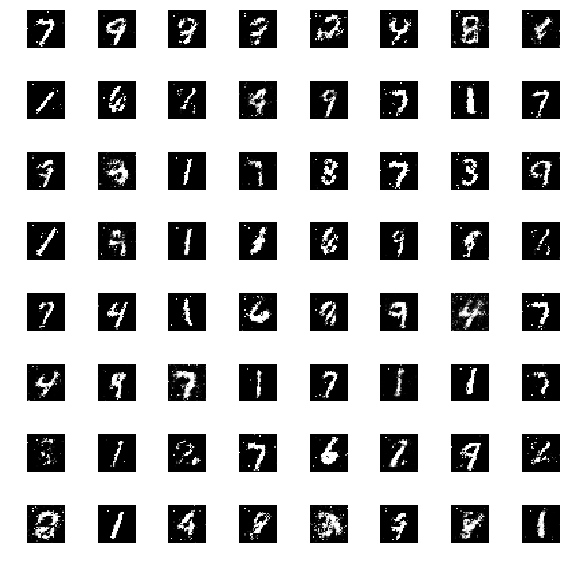

[Epoch 17/25] [Batch 200/938] [D loss: 0.45024794340133667] [G loss: 1.4480009078979492]


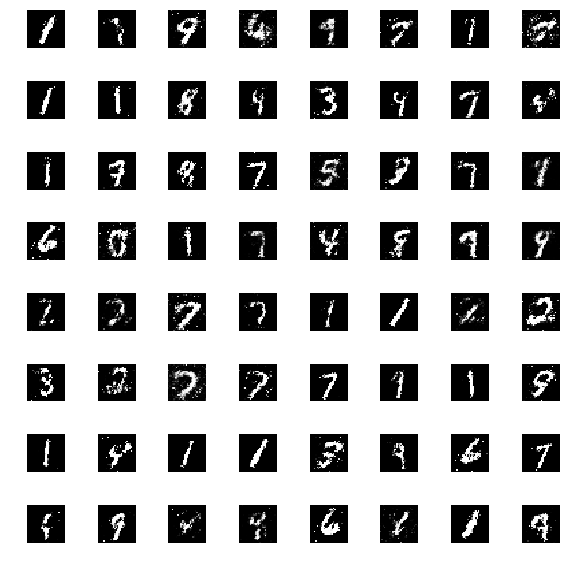

[Epoch 17/25] [Batch 300/938] [D loss: 0.465170681476593] [G loss: 1.4465197324752808]


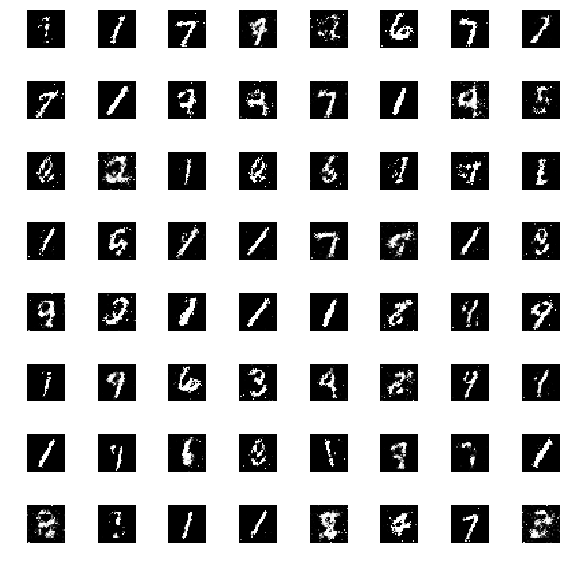

[Epoch 17/25] [Batch 400/938] [D loss: 0.5262818932533264] [G loss: 1.341668963432312]


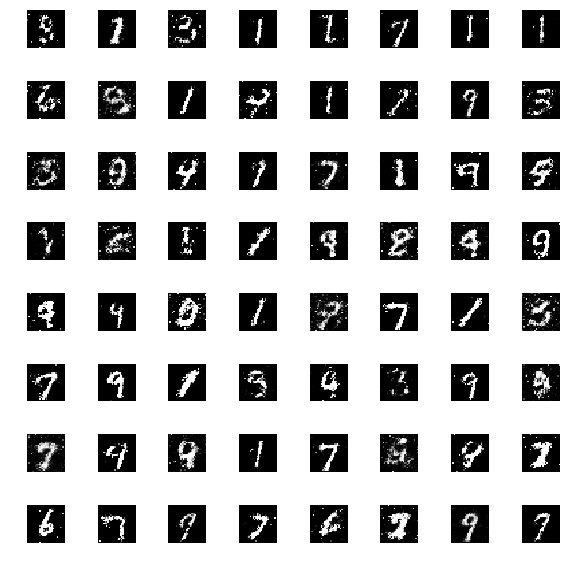

[Epoch 17/25] [Batch 500/938] [D loss: 0.5076146125793457] [G loss: 1.5095378160476685]


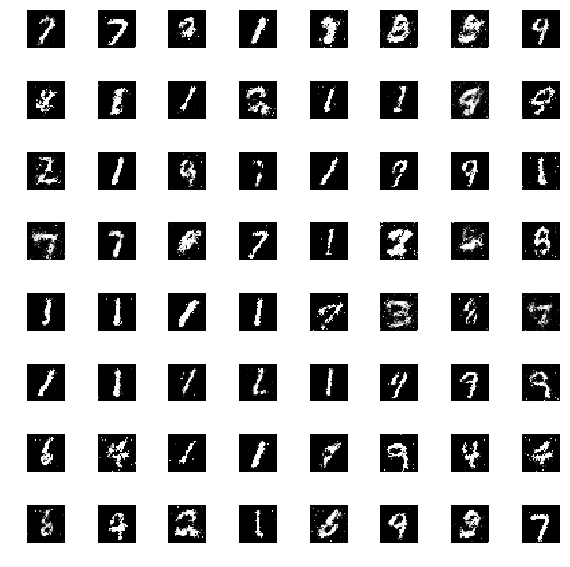

[Epoch 17/25] [Batch 600/938] [D loss: 0.46329784393310547] [G loss: 1.4898287057876587]


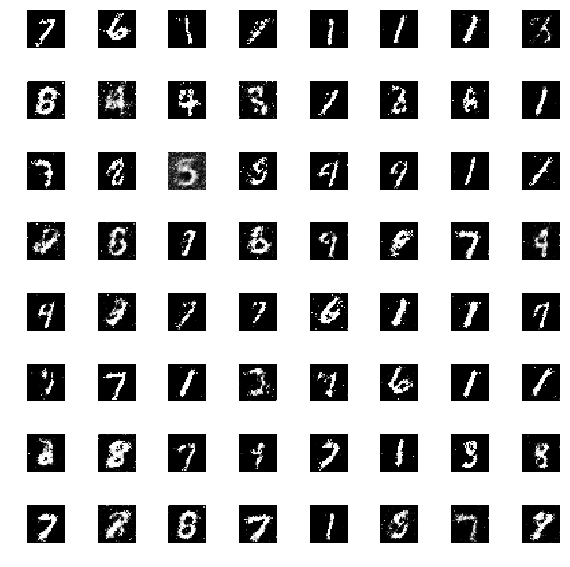

[Epoch 17/25] [Batch 700/938] [D loss: 0.4007810652256012] [G loss: 1.4186127185821533]


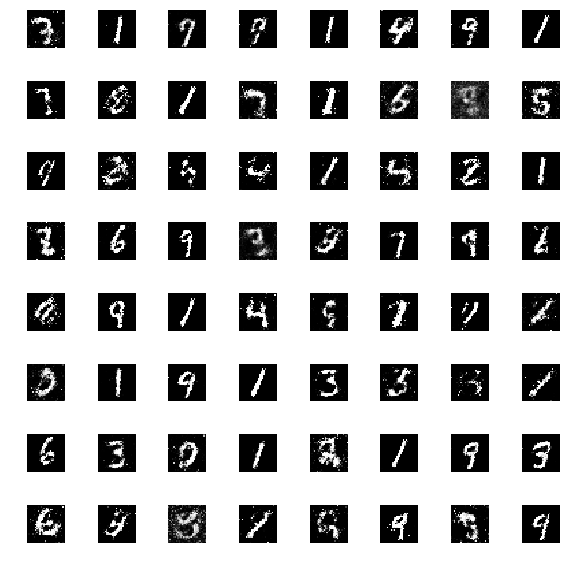

[Epoch 17/25] [Batch 800/938] [D loss: 0.4369032382965088] [G loss: 1.3956445455551147]


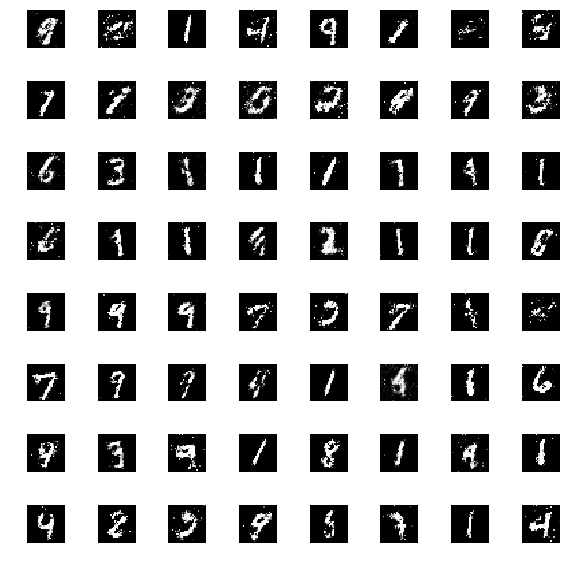

[Epoch 17/25] [Batch 900/938] [D loss: 0.5008326768875122] [G loss: 1.2531720399856567]


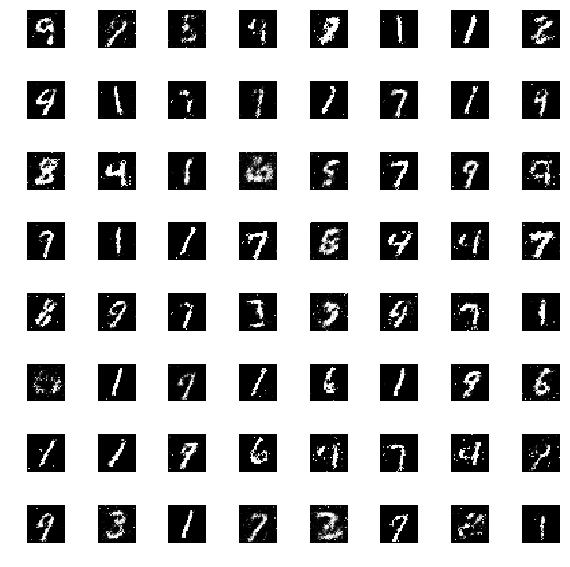

[Epoch 18/25] [Batch 0/938] [D loss: 0.42010319232940674] [G loss: 1.2820466756820679]


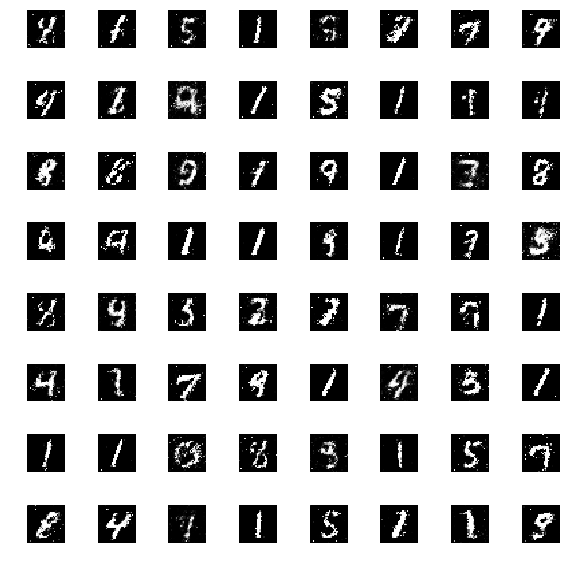

[Epoch 18/25] [Batch 100/938] [D loss: 0.41869544982910156] [G loss: 1.4756652116775513]


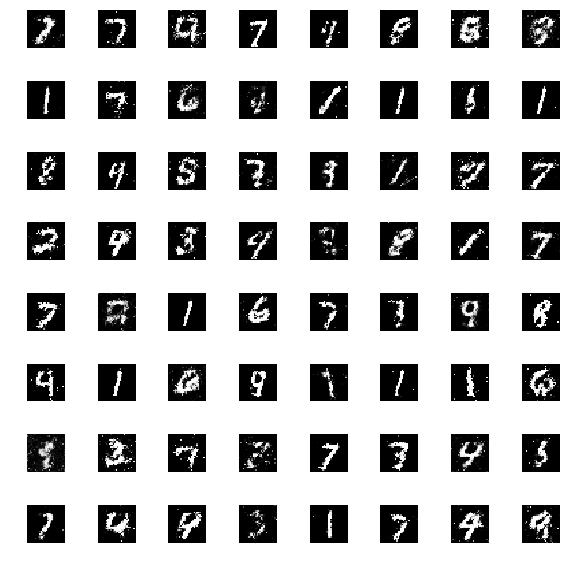

[Epoch 18/25] [Batch 200/938] [D loss: 0.4788285493850708] [G loss: 1.3615297079086304]


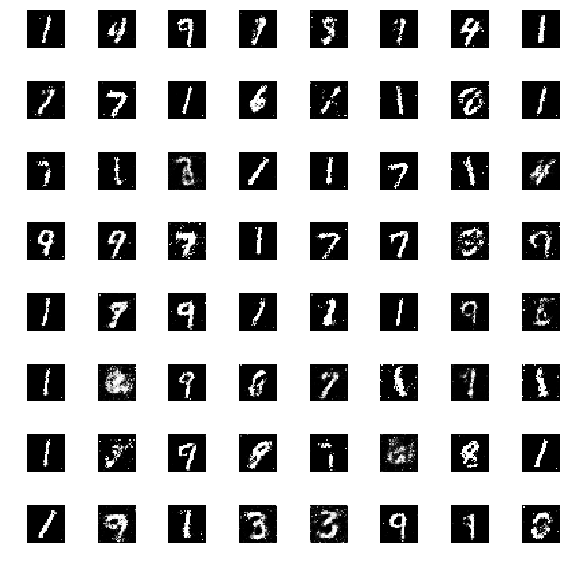

[Epoch 18/25] [Batch 300/938] [D loss: 0.46716663241386414] [G loss: 1.3640244007110596]


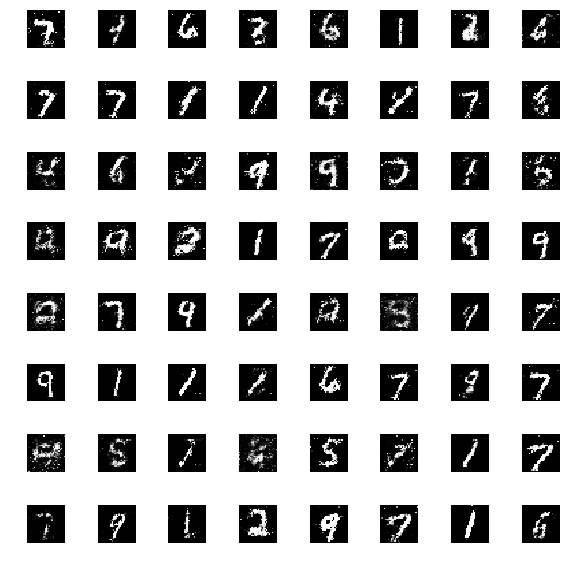

[Epoch 18/25] [Batch 400/938] [D loss: 0.4509597718715668] [G loss: 1.4326739311218262]


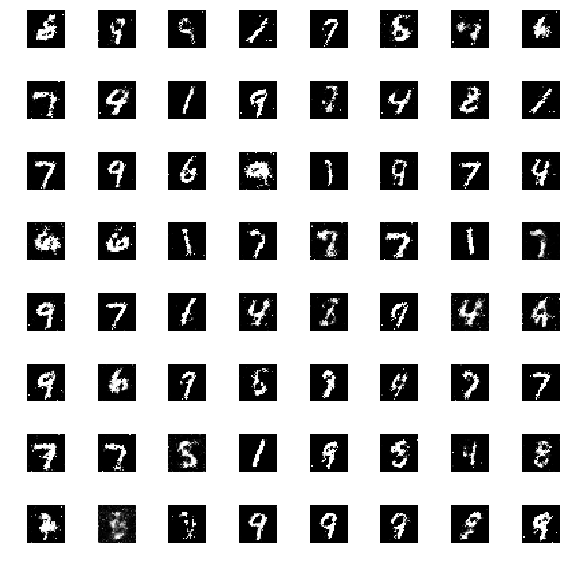

[Epoch 18/25] [Batch 500/938] [D loss: 0.43062734603881836] [G loss: 1.2321404218673706]


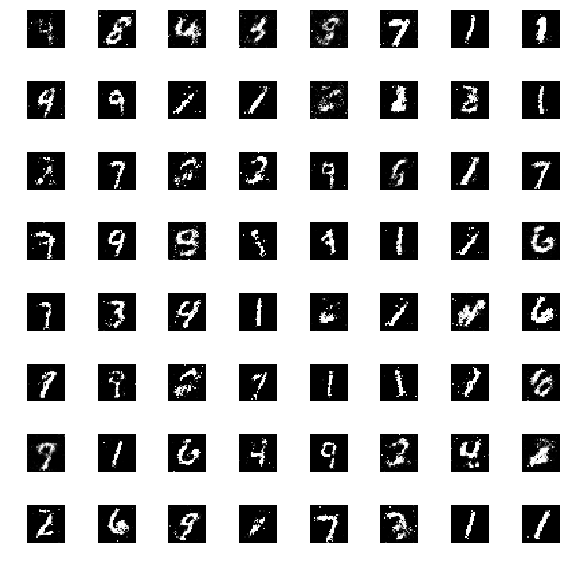

[Epoch 18/25] [Batch 600/938] [D loss: 0.49482861161231995] [G loss: 1.2707096338272095]


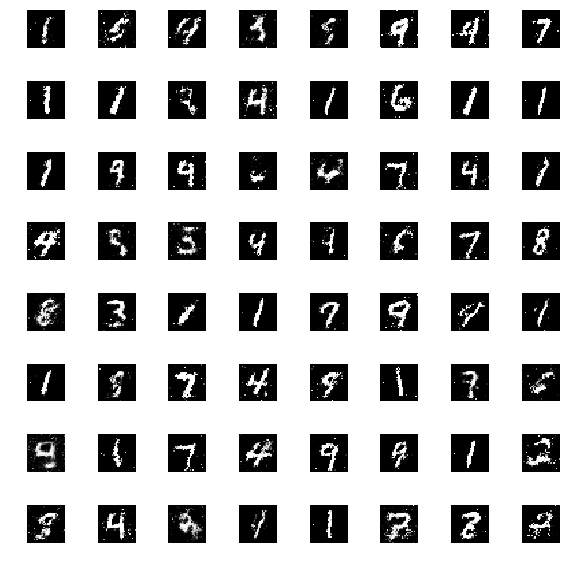

[Epoch 18/25] [Batch 700/938] [D loss: 0.44455695152282715] [G loss: 1.4752496480941772]


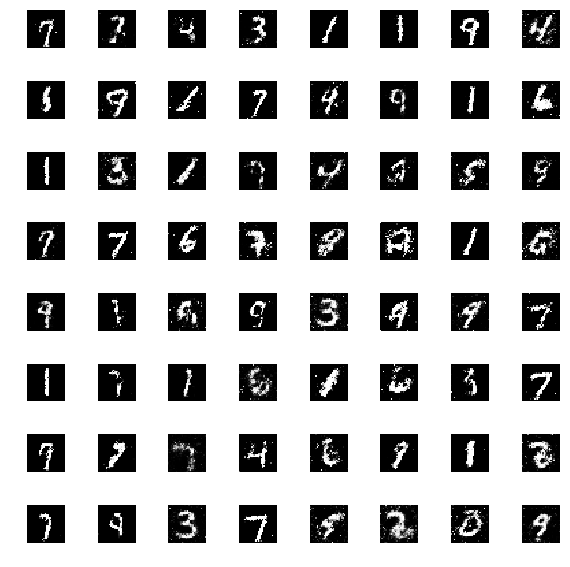

[Epoch 18/25] [Batch 800/938] [D loss: 0.5138052105903625] [G loss: 1.2865946292877197]


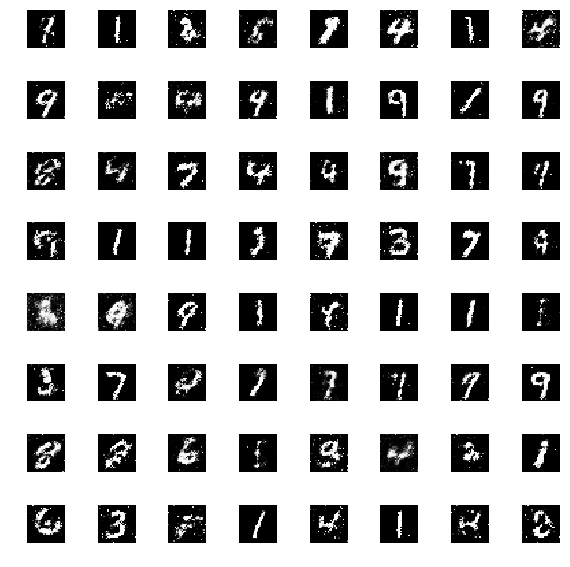

[Epoch 18/25] [Batch 900/938] [D loss: 0.40067973732948303] [G loss: 1.445225715637207]


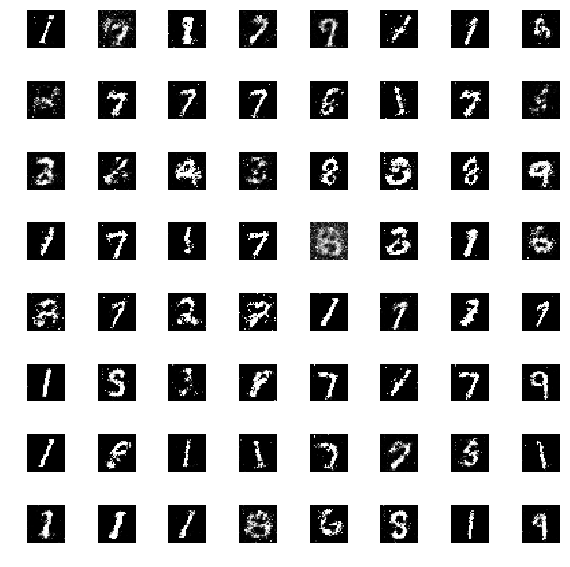

[Epoch 19/25] [Batch 0/938] [D loss: 0.4755473732948303] [G loss: 1.3434356451034546]


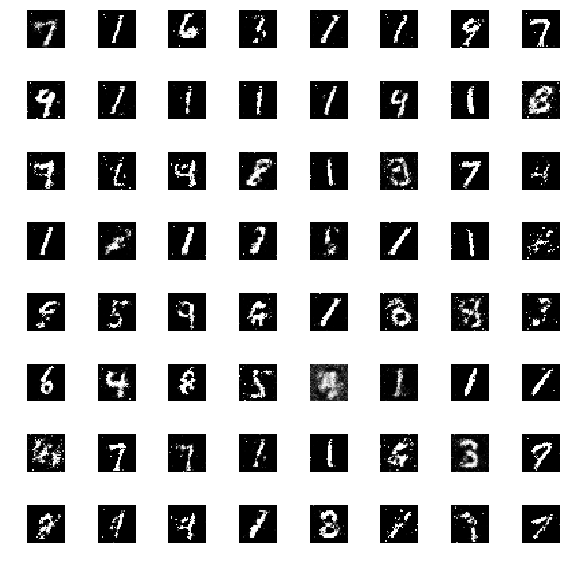

[Epoch 19/25] [Batch 100/938] [D loss: 0.48218896985054016] [G loss: 1.3985340595245361]


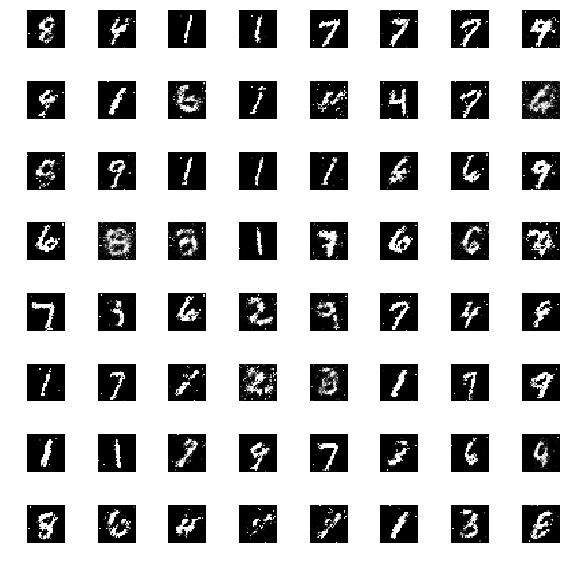

[Epoch 19/25] [Batch 200/938] [D loss: 0.5063461065292358] [G loss: 1.343036413192749]


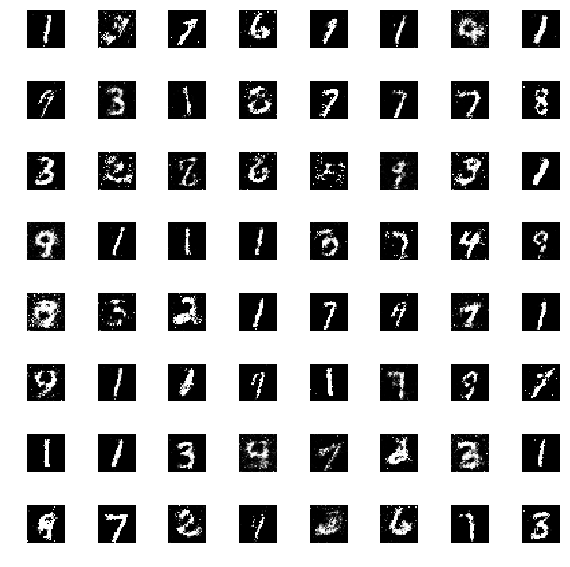

[Epoch 19/25] [Batch 300/938] [D loss: 0.4600643515586853] [G loss: 1.2910432815551758]


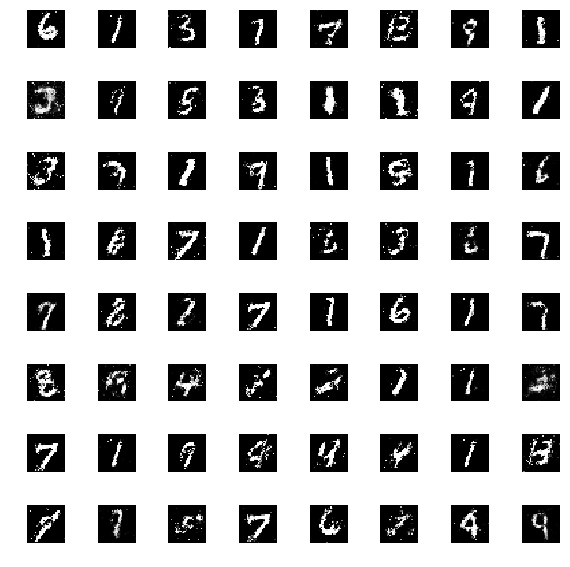

[Epoch 19/25] [Batch 400/938] [D loss: 0.5649527311325073] [G loss: 1.5618484020233154]


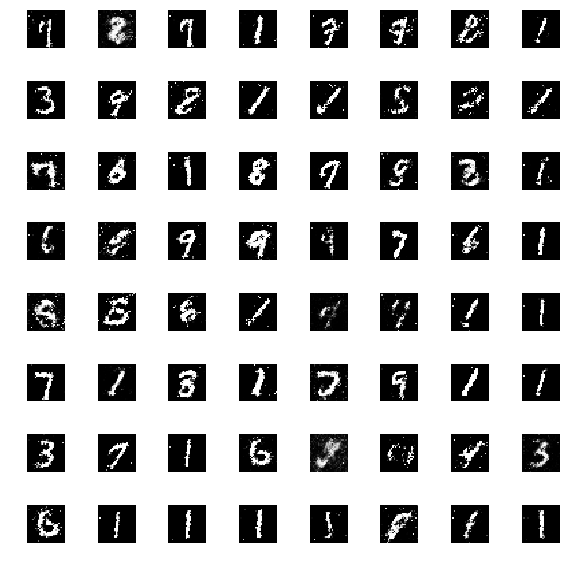

[Epoch 19/25] [Batch 500/938] [D loss: 0.4150674343109131] [G loss: 1.251070261001587]


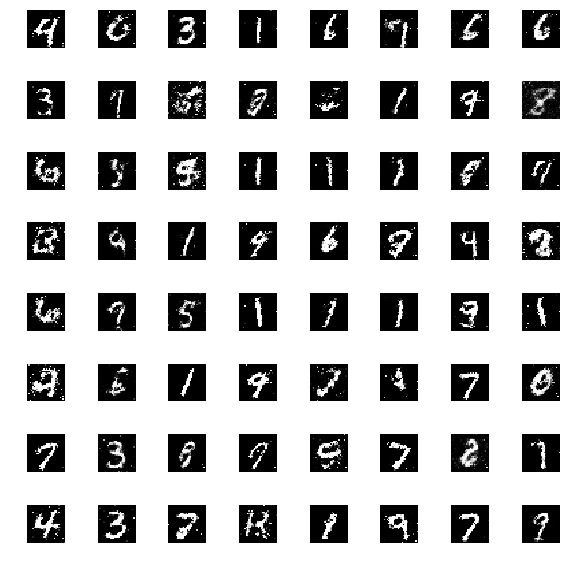

[Epoch 19/25] [Batch 600/938] [D loss: 0.4942396283149719] [G loss: 1.4715516567230225]


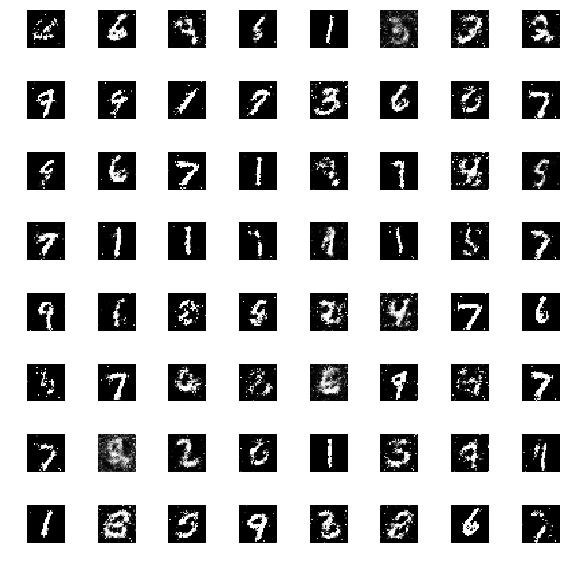

[Epoch 19/25] [Batch 700/938] [D loss: 0.5168051719665527] [G loss: 1.3378942012786865]


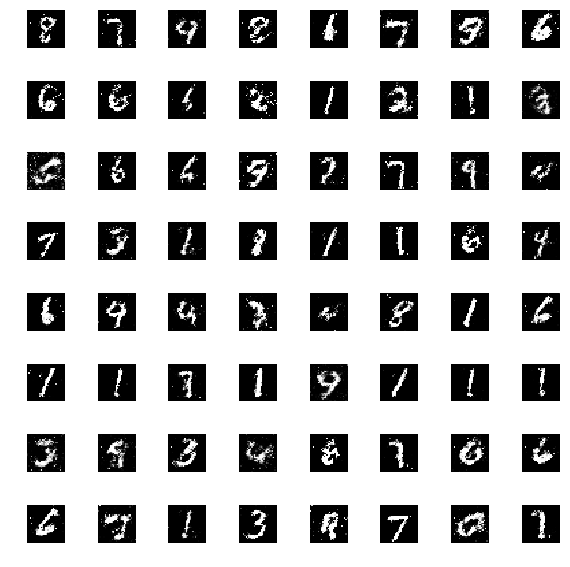

[Epoch 19/25] [Batch 800/938] [D loss: 0.46864527463912964] [G loss: 1.3622021675109863]


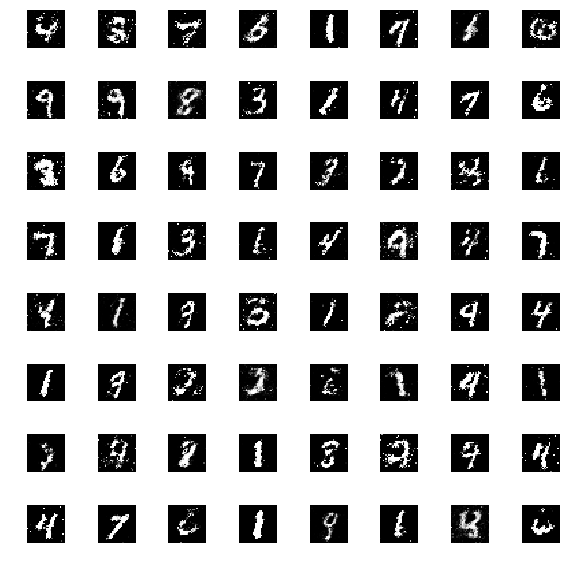

[Epoch 19/25] [Batch 900/938] [D loss: 0.5532031059265137] [G loss: 1.4212431907653809]


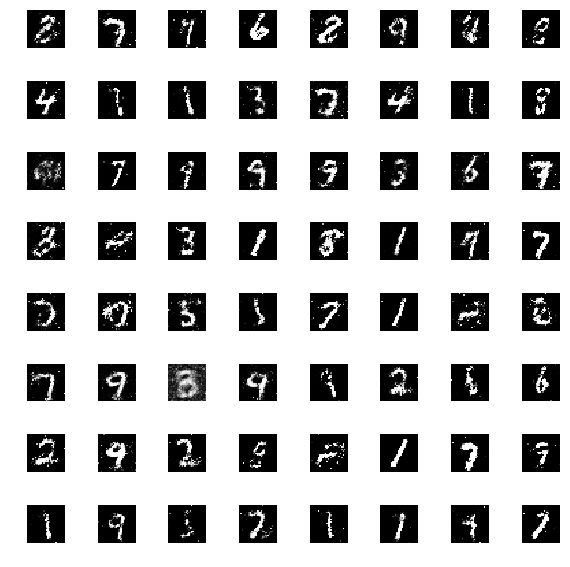

[Epoch 20/25] [Batch 0/938] [D loss: 0.48830124735832214] [G loss: 1.375847339630127]


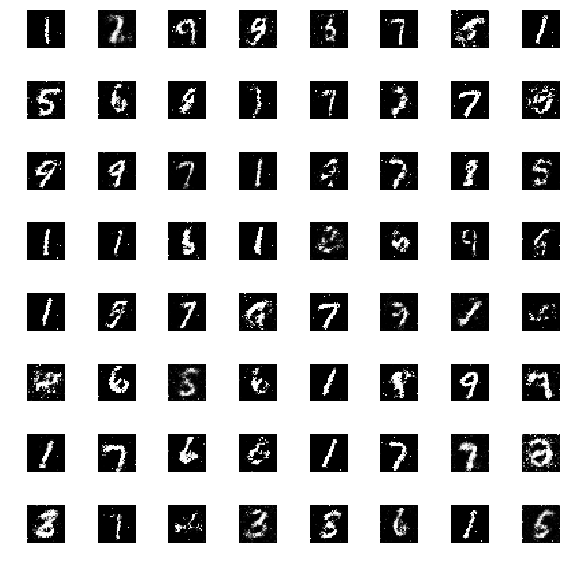

[Epoch 20/25] [Batch 100/938] [D loss: 0.5286825895309448] [G loss: 1.1560611724853516]


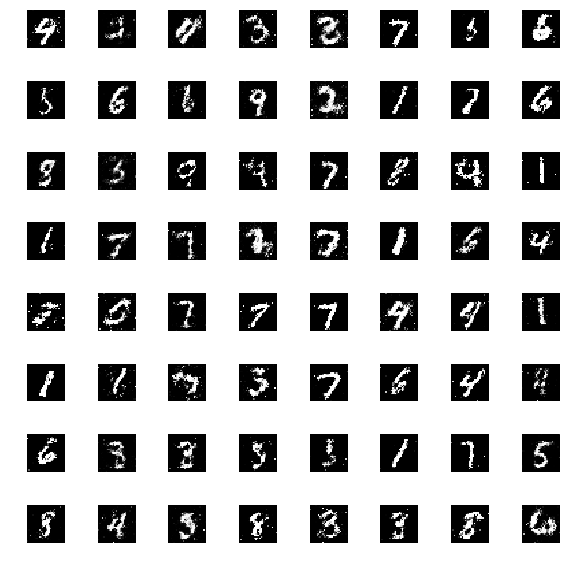

[Epoch 20/25] [Batch 200/938] [D loss: 0.4419849216938019] [G loss: 1.1597586870193481]


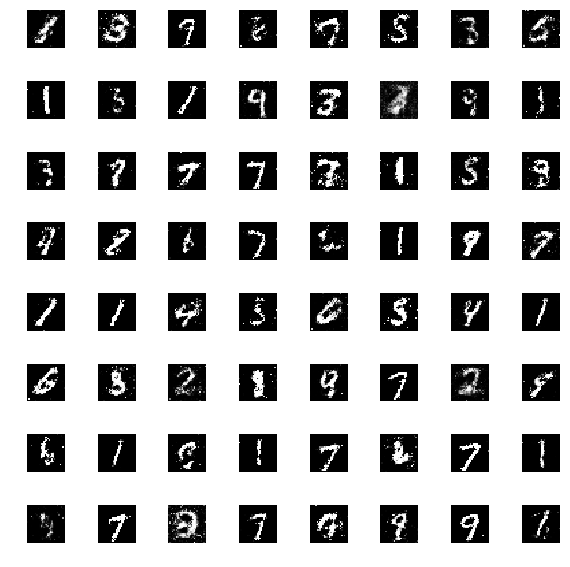

[Epoch 20/25] [Batch 300/938] [D loss: 0.48434850573539734] [G loss: 1.302327036857605]


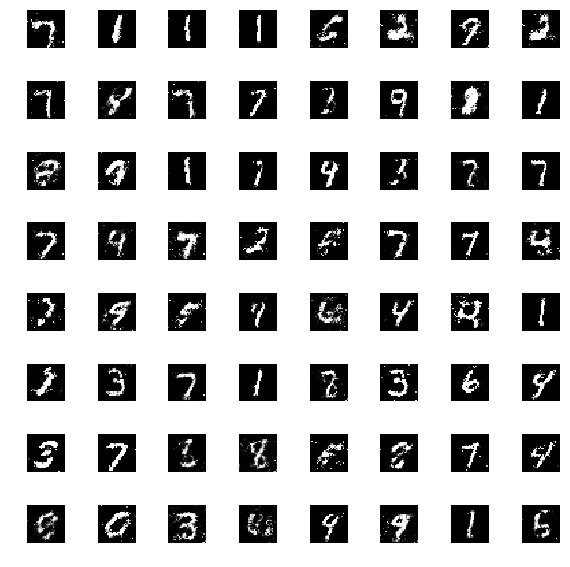

[Epoch 20/25] [Batch 400/938] [D loss: 0.500346302986145] [G loss: 1.2932507991790771]


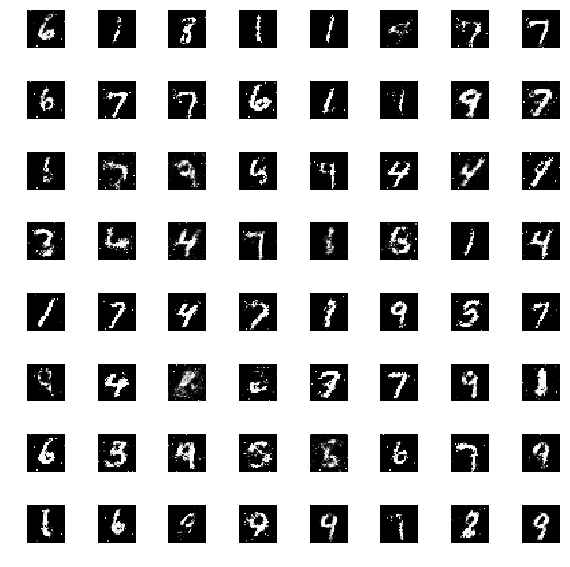

[Epoch 20/25] [Batch 500/938] [D loss: 0.4584035277366638] [G loss: 1.2496870756149292]


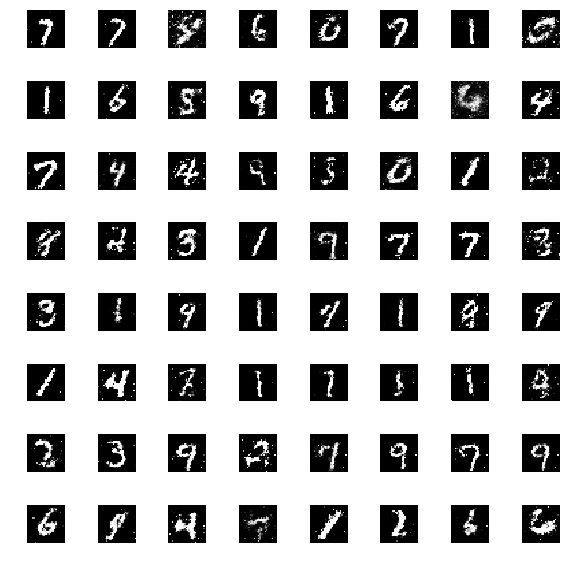

[Epoch 20/25] [Batch 600/938] [D loss: 0.5313917398452759] [G loss: 1.5086450576782227]


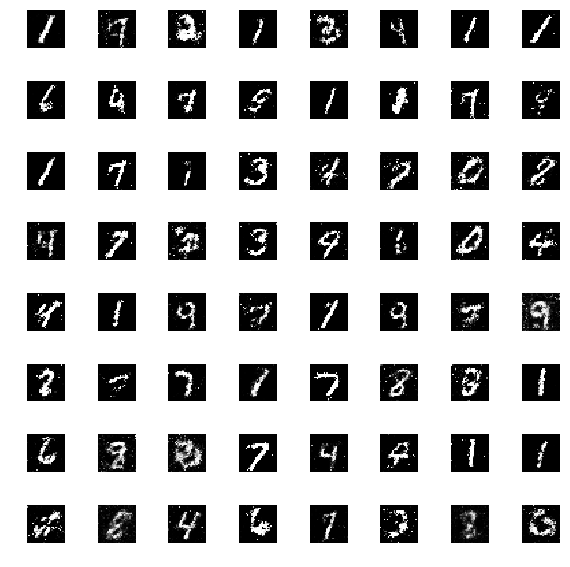

[Epoch 20/25] [Batch 700/938] [D loss: 0.5693515539169312] [G loss: 1.131191372871399]


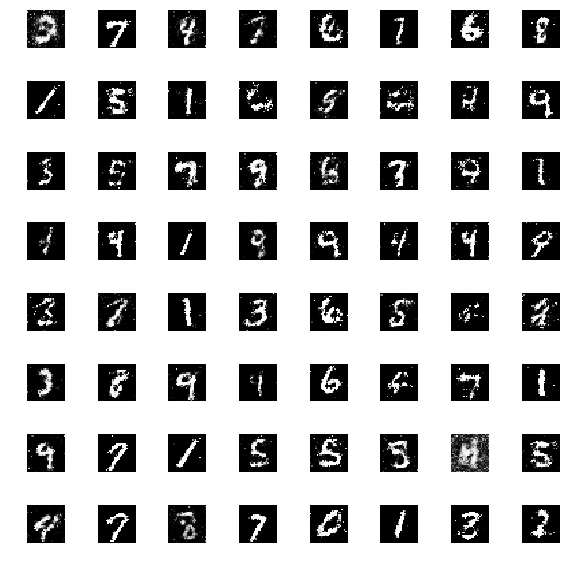

[Epoch 20/25] [Batch 800/938] [D loss: 0.484261691570282] [G loss: 1.2910714149475098]


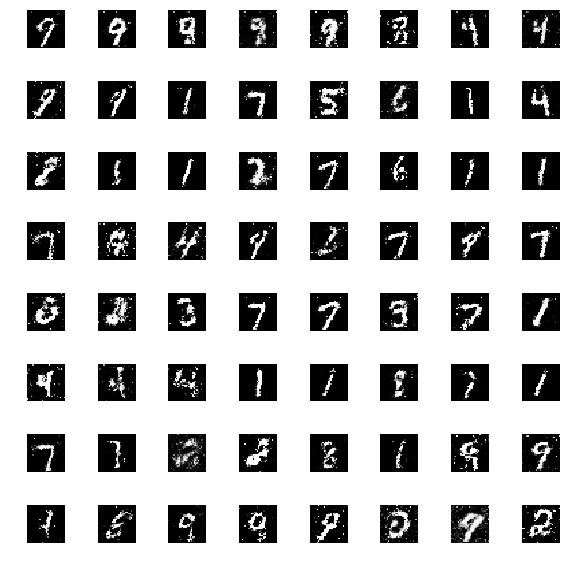

[Epoch 20/25] [Batch 900/938] [D loss: 0.45495444536209106] [G loss: 1.4088263511657715]


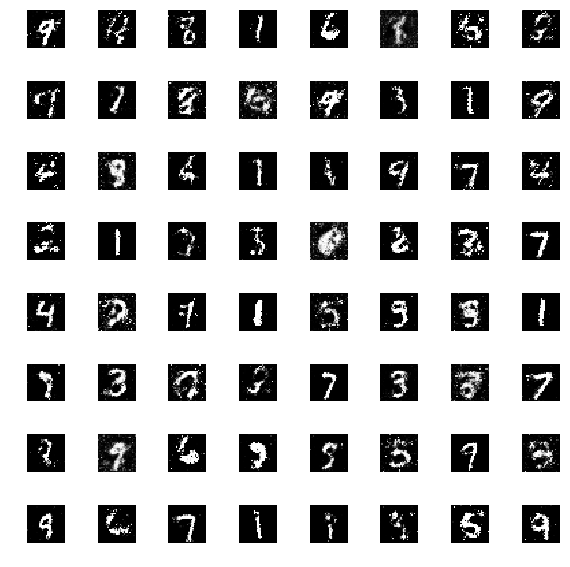

[Epoch 21/25] [Batch 0/938] [D loss: 0.5378847122192383] [G loss: 1.218861699104309]


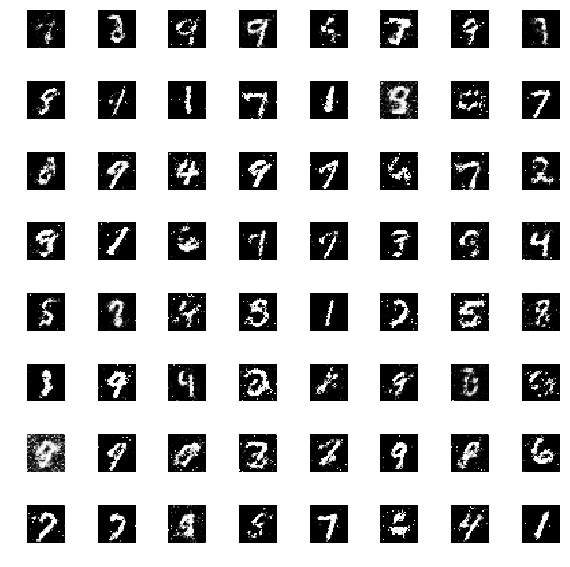

[Epoch 21/25] [Batch 100/938] [D loss: 0.5132049322128296] [G loss: 1.4652198553085327]


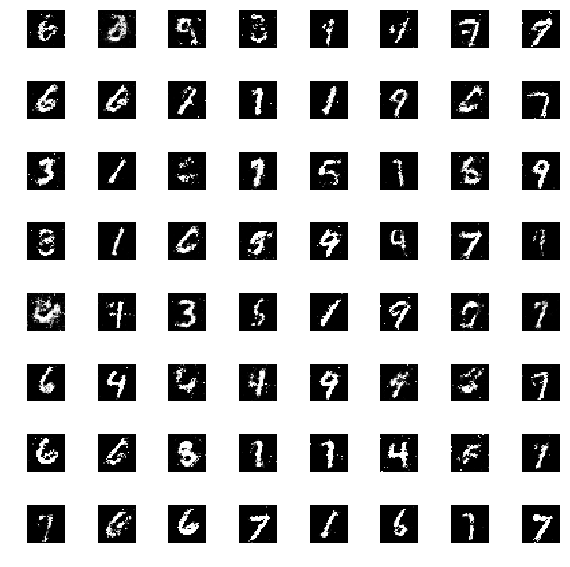

[Epoch 21/25] [Batch 200/938] [D loss: 0.49185284972190857] [G loss: 1.255689024925232]


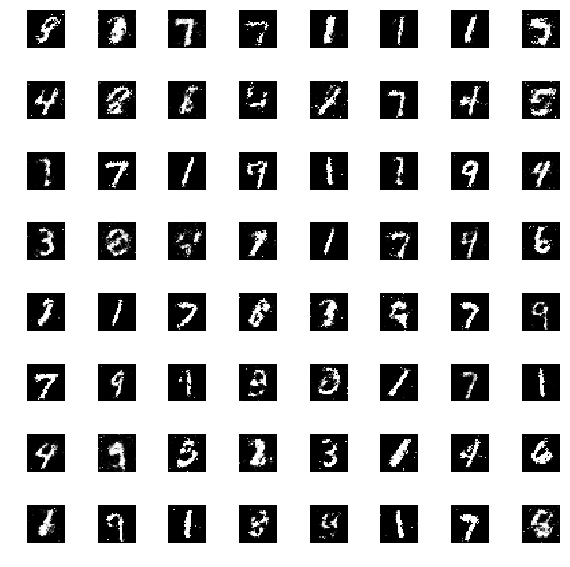

[Epoch 21/25] [Batch 300/938] [D loss: 0.5262671709060669] [G loss: 1.3540877103805542]


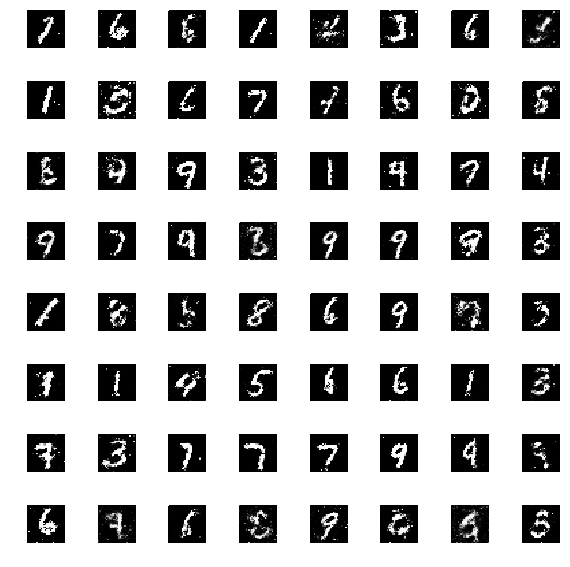

[Epoch 21/25] [Batch 400/938] [D loss: 0.4703340530395508] [G loss: 1.2857288122177124]


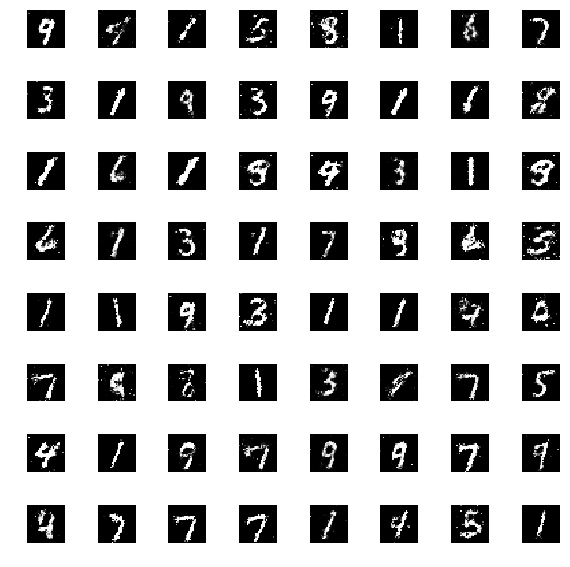

[Epoch 21/25] [Batch 500/938] [D loss: 0.5276119709014893] [G loss: 1.2158955335617065]


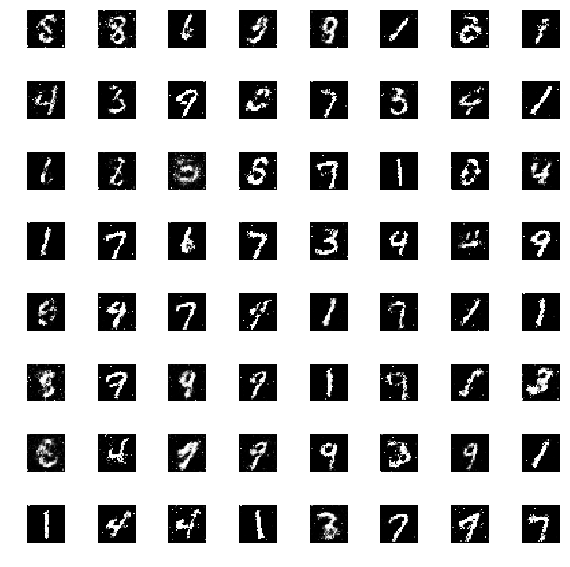

[Epoch 21/25] [Batch 600/938] [D loss: 0.5736460089683533] [G loss: 1.2682527303695679]


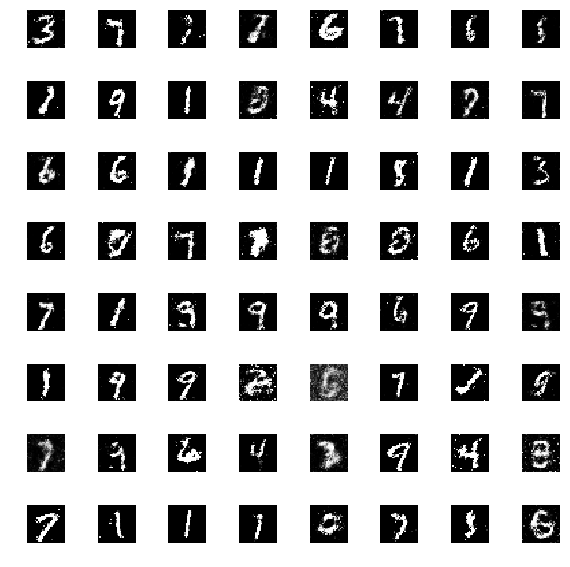

[Epoch 21/25] [Batch 700/938] [D loss: 0.4600970149040222] [G loss: 1.2113418579101562]


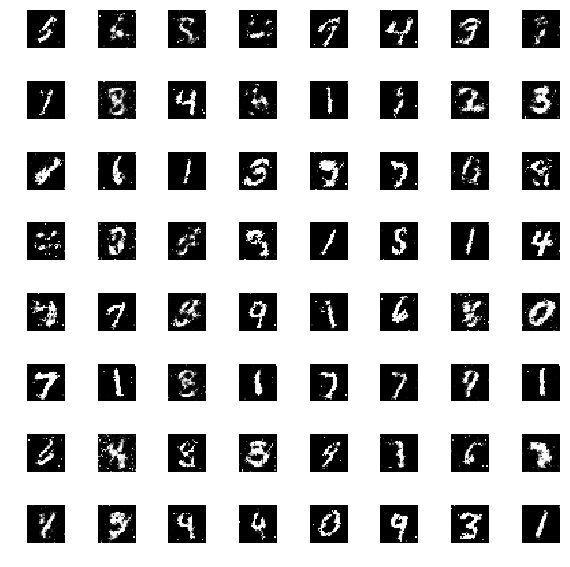

[Epoch 21/25] [Batch 800/938] [D loss: 0.542946457862854] [G loss: 1.1223726272583008]


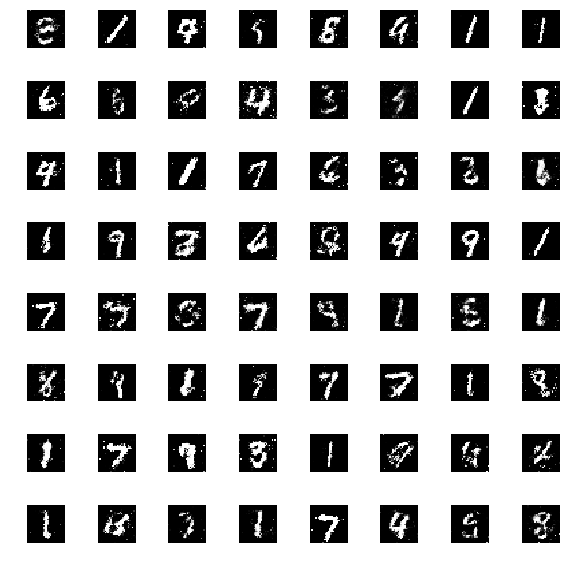

[Epoch 21/25] [Batch 900/938] [D loss: 0.5364061594009399] [G loss: 1.2198898792266846]


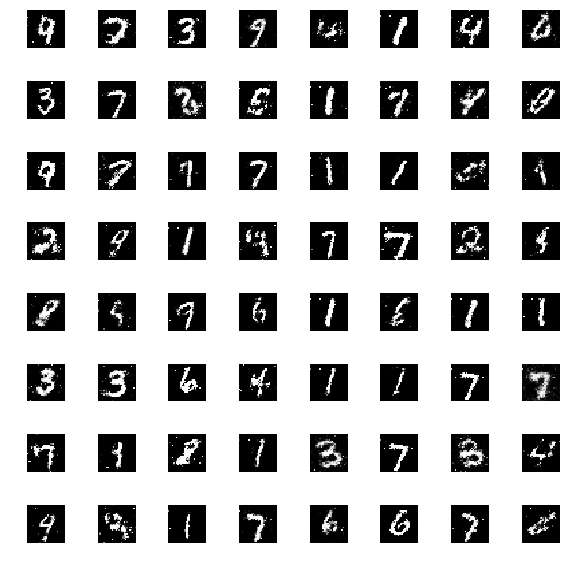

[Epoch 22/25] [Batch 0/938] [D loss: 0.5548707842826843] [G loss: 1.2802252769470215]


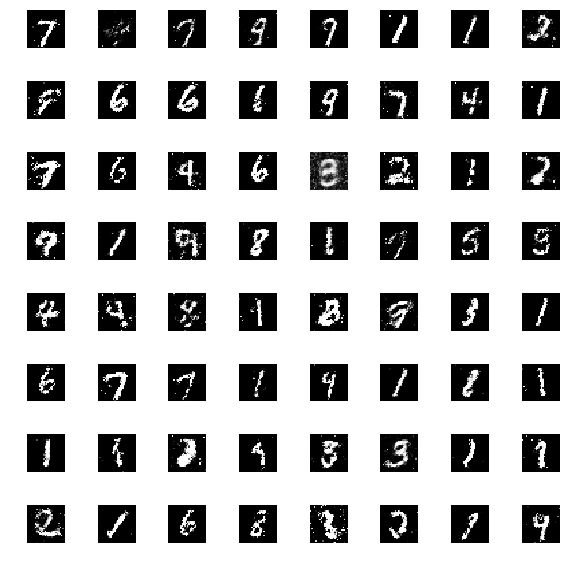

[Epoch 22/25] [Batch 100/938] [D loss: 0.5132778882980347] [G loss: 1.4718903303146362]


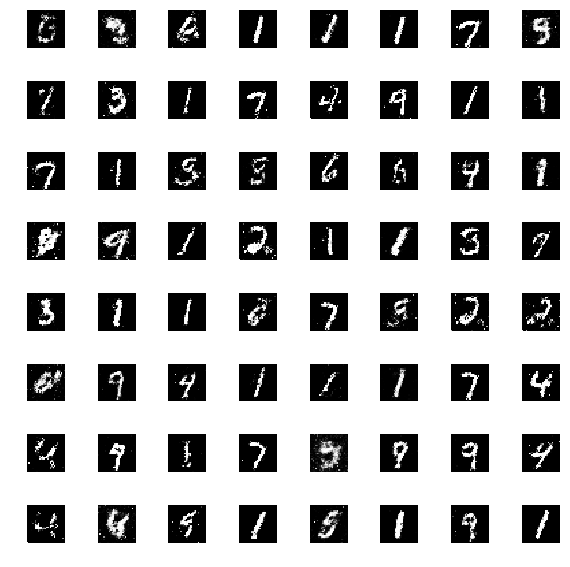

[Epoch 22/25] [Batch 200/938] [D loss: 0.5451886653900146] [G loss: 1.2543553113937378]


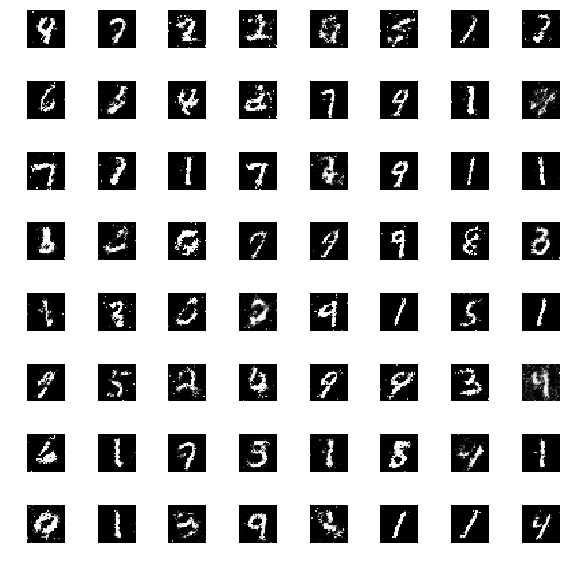

[Epoch 22/25] [Batch 300/938] [D loss: 0.5805482864379883] [G loss: 1.100882649421692]


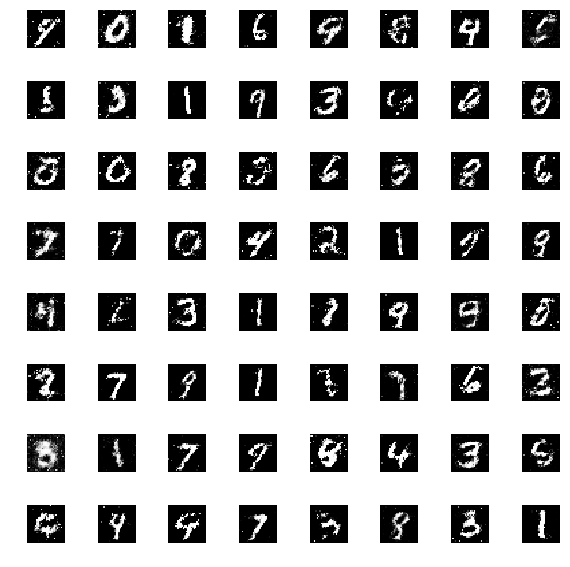

[Epoch 22/25] [Batch 400/938] [D loss: 0.49185606837272644] [G loss: 1.1748601198196411]


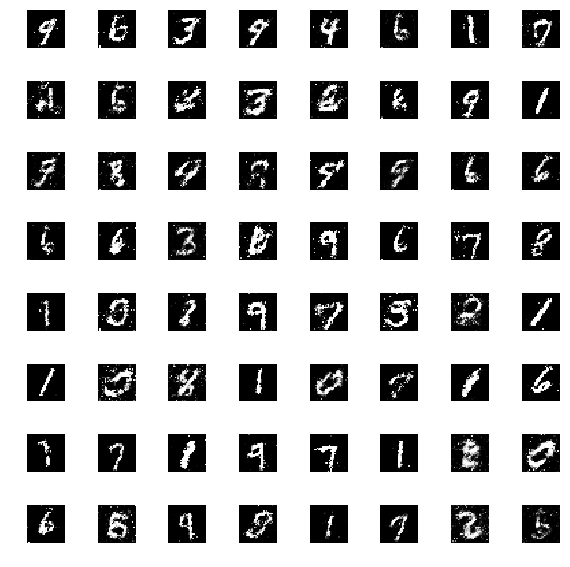

[Epoch 22/25] [Batch 500/938] [D loss: 0.540653645992279] [G loss: 1.2875392436981201]


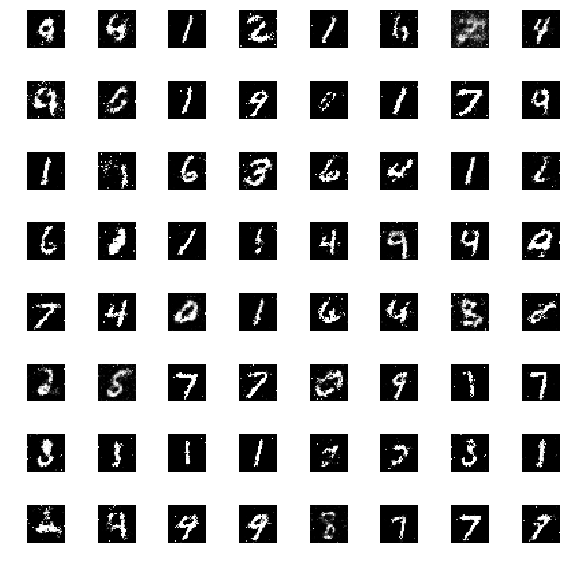

[Epoch 22/25] [Batch 600/938] [D loss: 0.5838752388954163] [G loss: 1.2799785137176514]


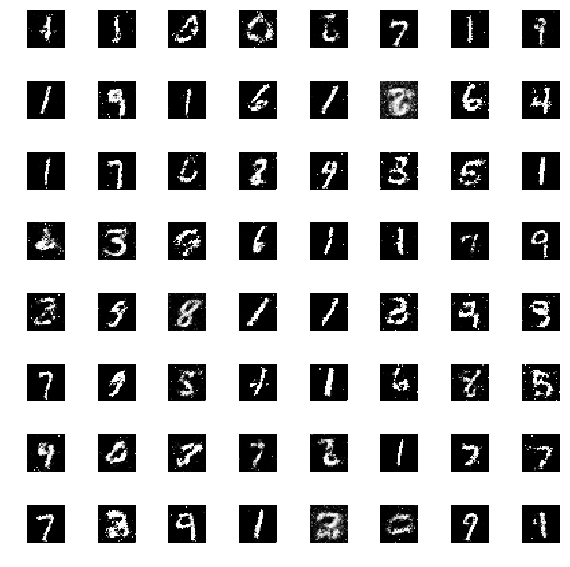

[Epoch 22/25] [Batch 700/938] [D loss: 0.535033106803894] [G loss: 1.0382788181304932]


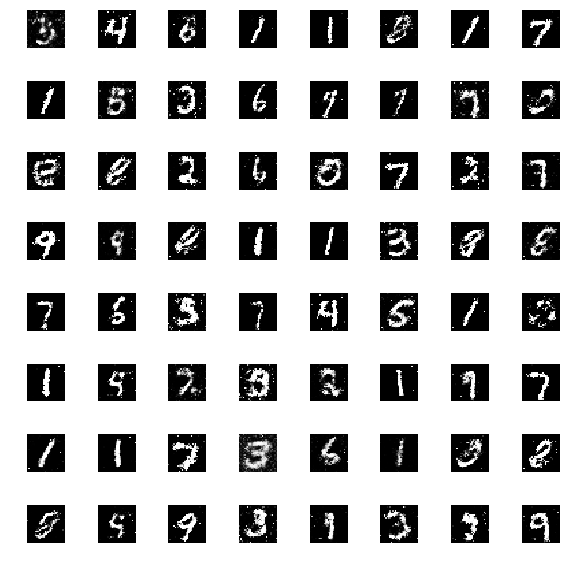

[Epoch 22/25] [Batch 800/938] [D loss: 0.49451690912246704] [G loss: 1.2213605642318726]


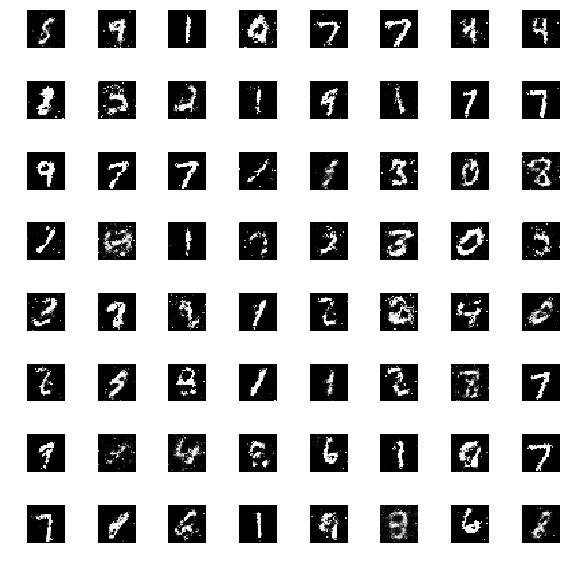

[Epoch 22/25] [Batch 900/938] [D loss: 0.4876179099082947] [G loss: 1.0797514915466309]


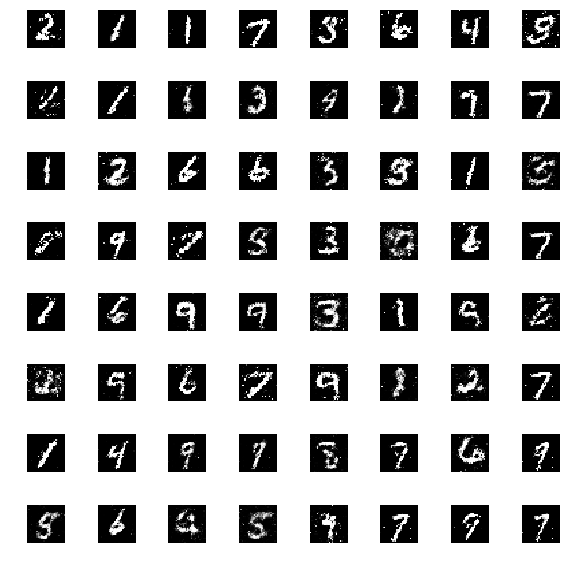

[Epoch 23/25] [Batch 0/938] [D loss: 0.5267816781997681] [G loss: 1.2785863876342773]


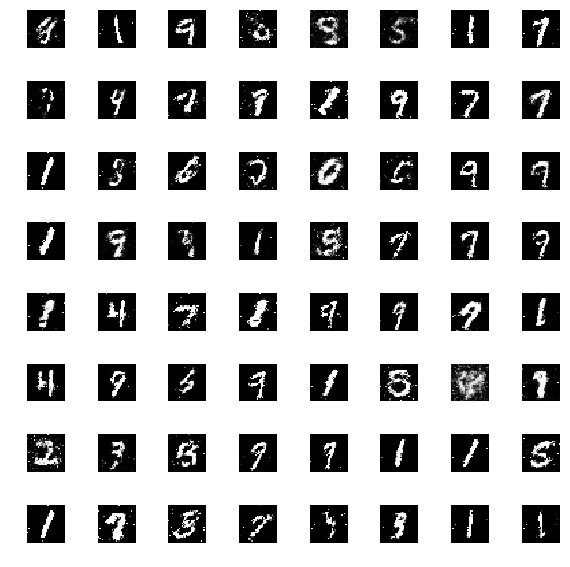

[Epoch 23/25] [Batch 100/938] [D loss: 0.48583024740219116] [G loss: 1.2305148839950562]


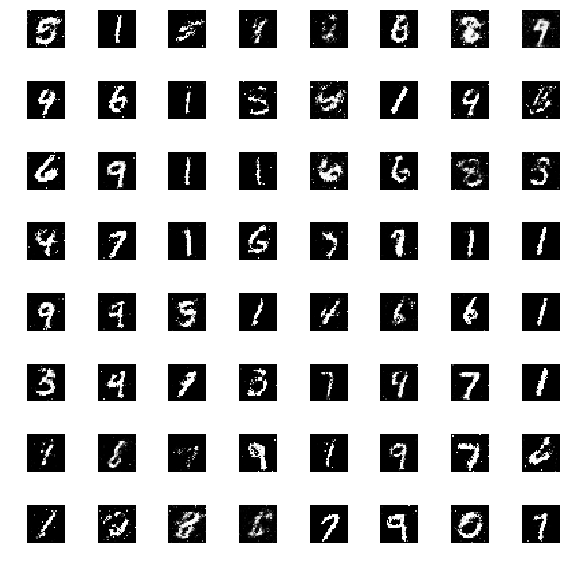

[Epoch 23/25] [Batch 200/938] [D loss: 0.47999730706214905] [G loss: 1.1574559211730957]


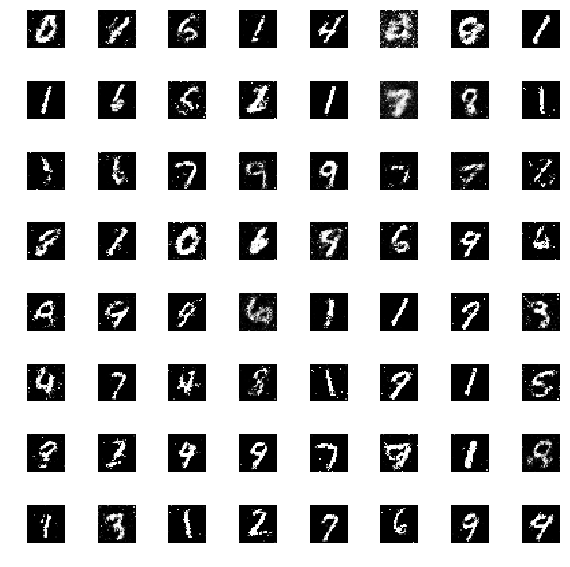

[Epoch 23/25] [Batch 300/938] [D loss: 0.5056303143501282] [G loss: 1.1759254932403564]


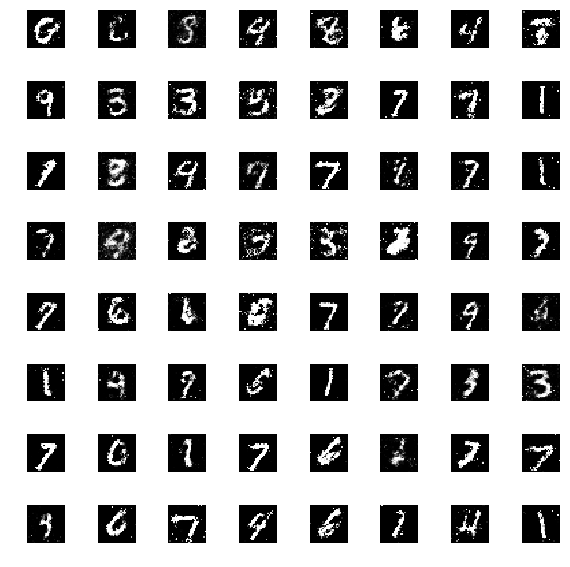

[Epoch 23/25] [Batch 400/938] [D loss: 0.5940947532653809] [G loss: 1.0426733493804932]


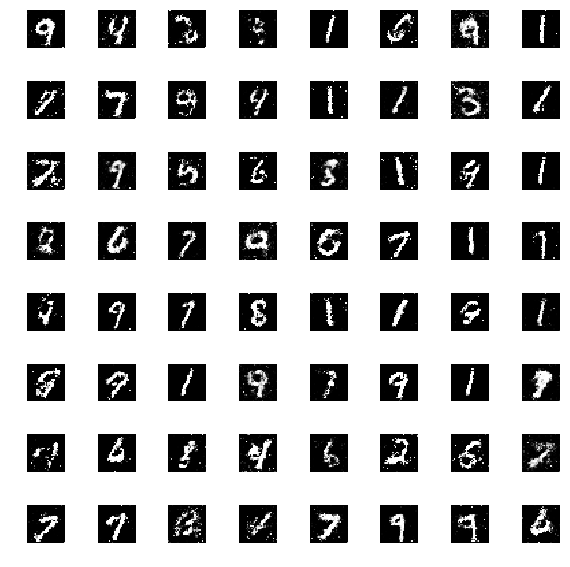

[Epoch 23/25] [Batch 500/938] [D loss: 0.5759004354476929] [G loss: 1.034272313117981]


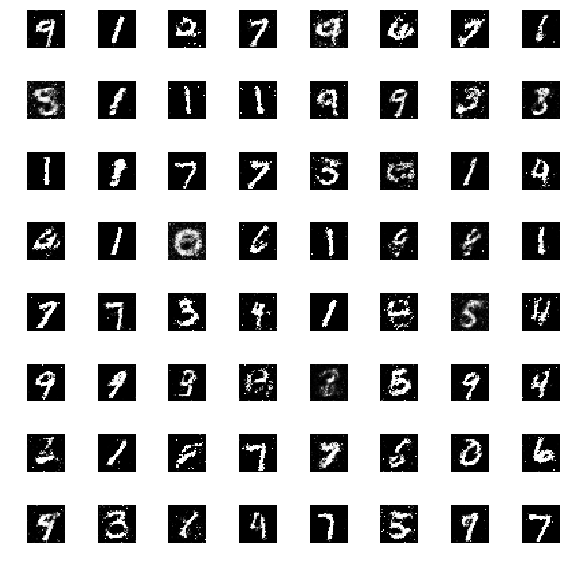

[Epoch 23/25] [Batch 600/938] [D loss: 0.5213860273361206] [G loss: 1.185522437095642]


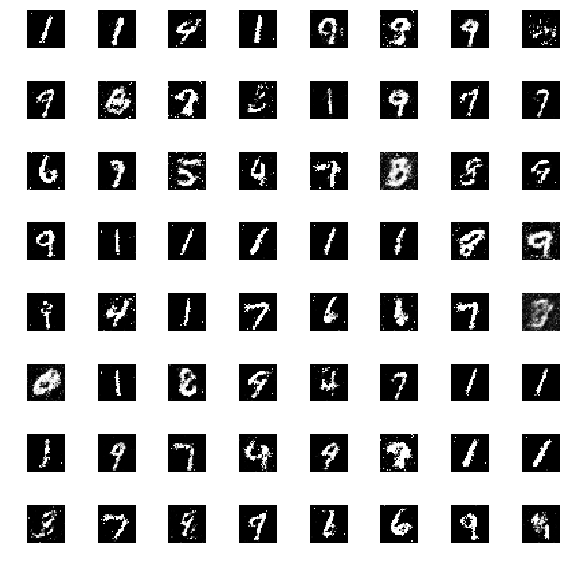

[Epoch 23/25] [Batch 700/938] [D loss: 0.49504315853118896] [G loss: 1.2358731031417847]


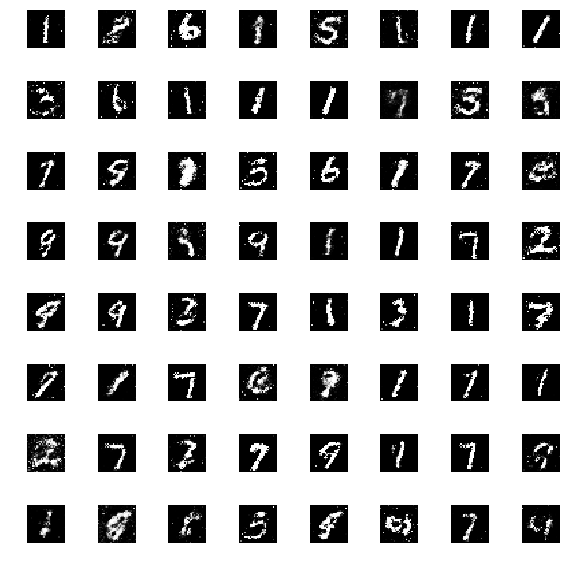

[Epoch 23/25] [Batch 800/938] [D loss: 0.5063433051109314] [G loss: 1.3068568706512451]


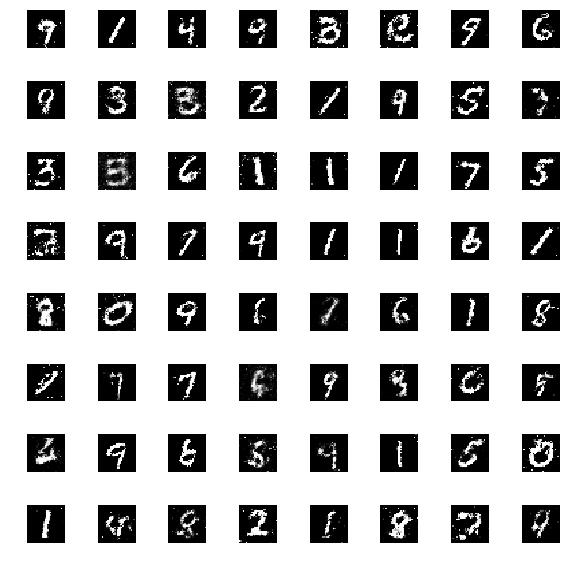

[Epoch 23/25] [Batch 900/938] [D loss: 0.44430017471313477] [G loss: 1.2737195491790771]


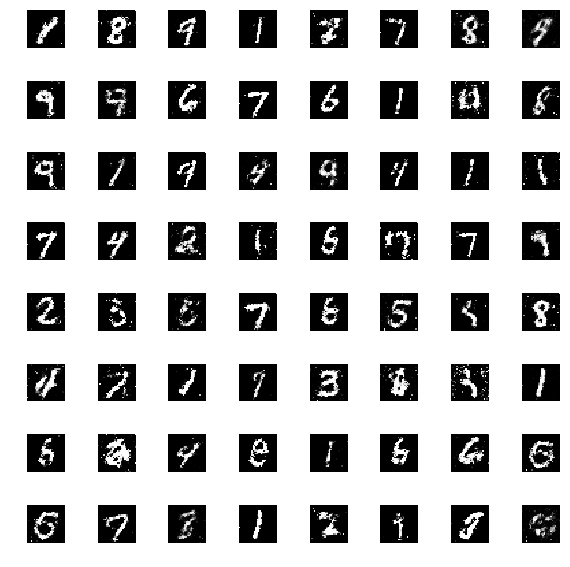

[Epoch 24/25] [Batch 0/938] [D loss: 0.5529566407203674] [G loss: 1.0726618766784668]


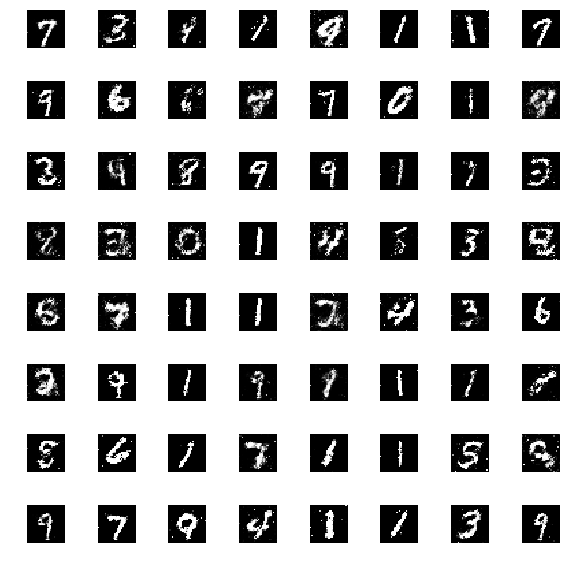

[Epoch 24/25] [Batch 100/938] [D loss: 0.4958988428115845] [G loss: 1.1970667839050293]


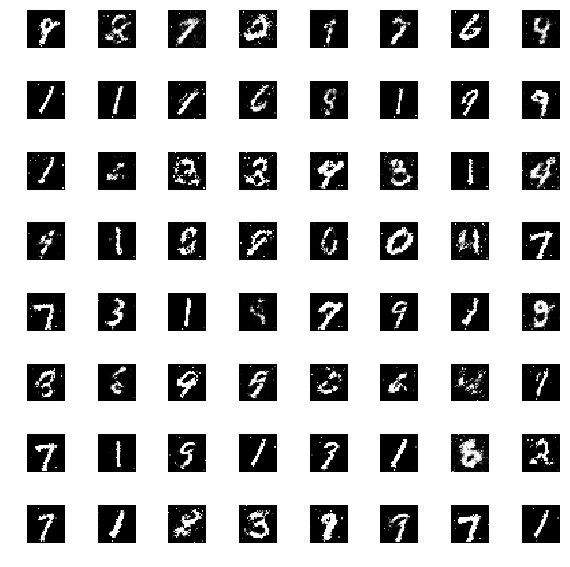

[Epoch 24/25] [Batch 200/938] [D loss: 0.5316987037658691] [G loss: 1.2161976099014282]


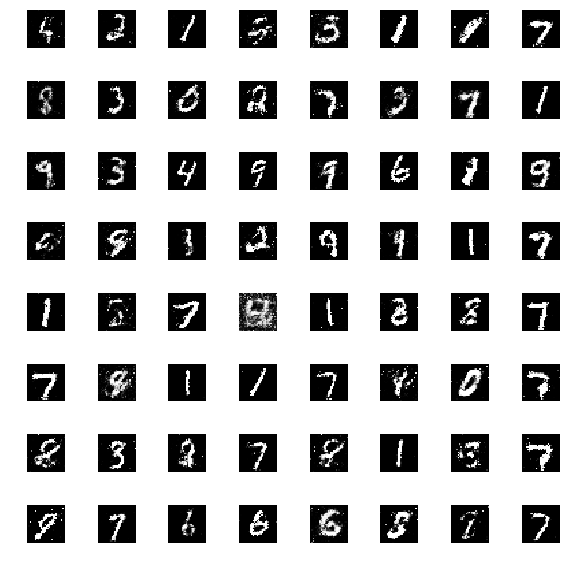

[Epoch 24/25] [Batch 300/938] [D loss: 0.5259621143341064] [G loss: 1.2489975690841675]


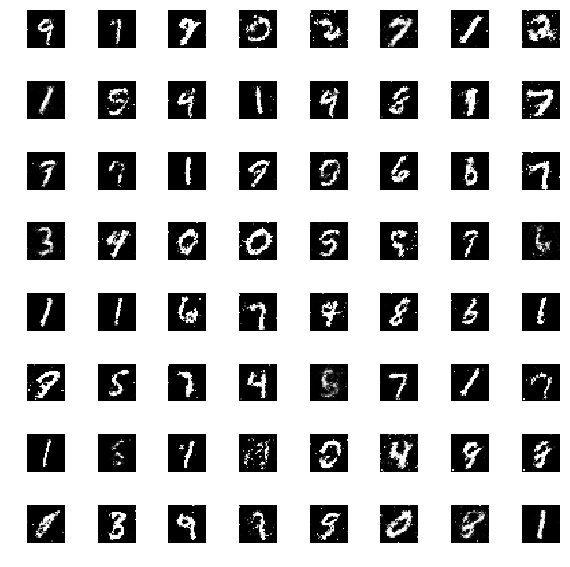

[Epoch 24/25] [Batch 400/938] [D loss: 0.465265154838562] [G loss: 1.052980899810791]


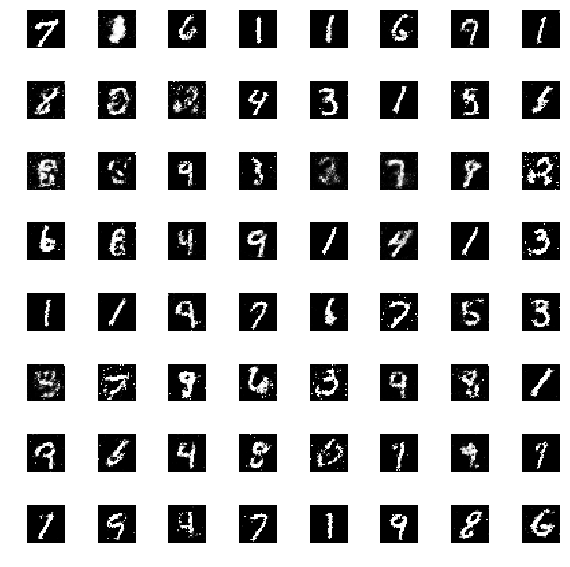

[Epoch 24/25] [Batch 500/938] [D loss: 0.581362247467041] [G loss: 1.1537374258041382]


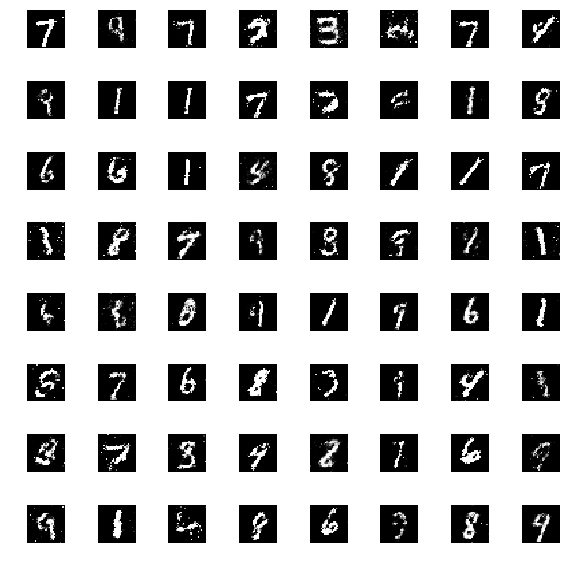

[Epoch 24/25] [Batch 600/938] [D loss: 0.46486419439315796] [G loss: 1.1145212650299072]


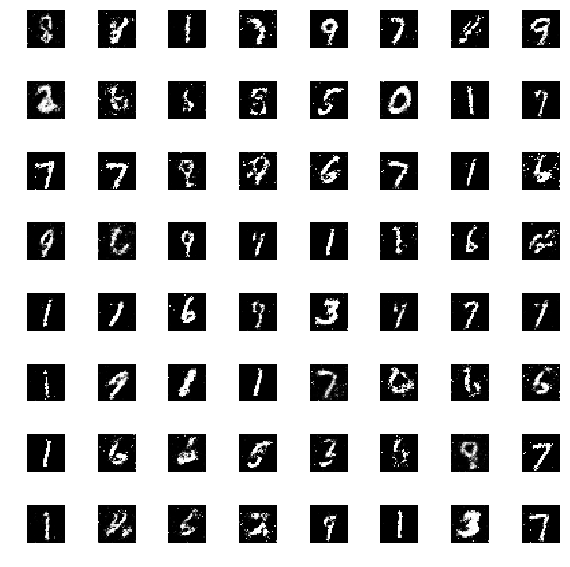

[Epoch 24/25] [Batch 700/938] [D loss: 0.5493254661560059] [G loss: 1.1478512287139893]


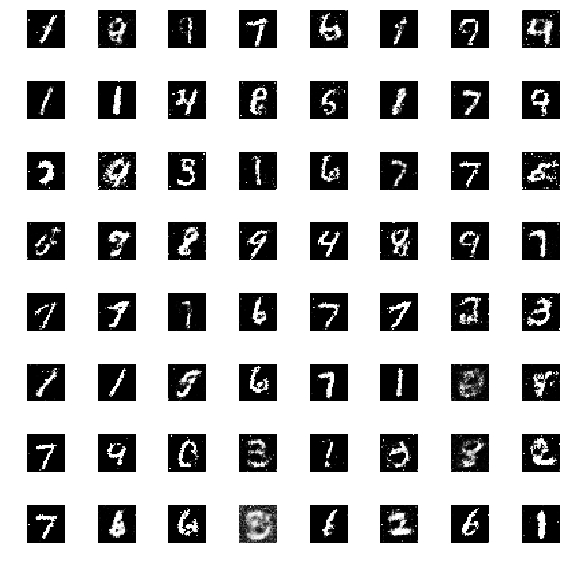

[Epoch 24/25] [Batch 800/938] [D loss: 0.5501539707183838] [G loss: 1.147244930267334]


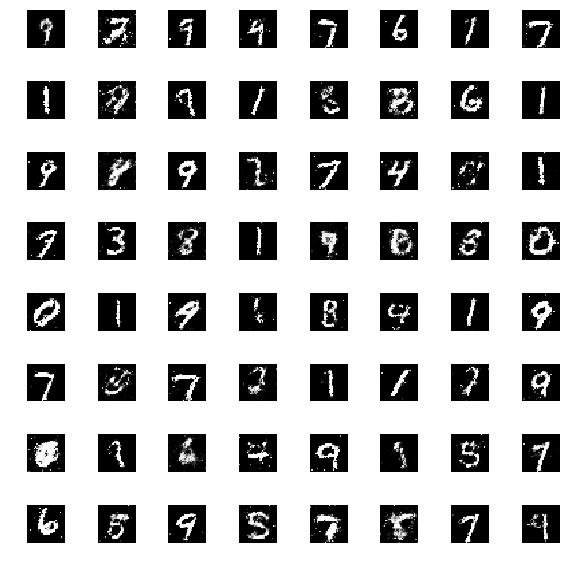

[Epoch 24/25] [Batch 900/938] [D loss: 0.4757727086544037] [G loss: 1.3926126956939697]


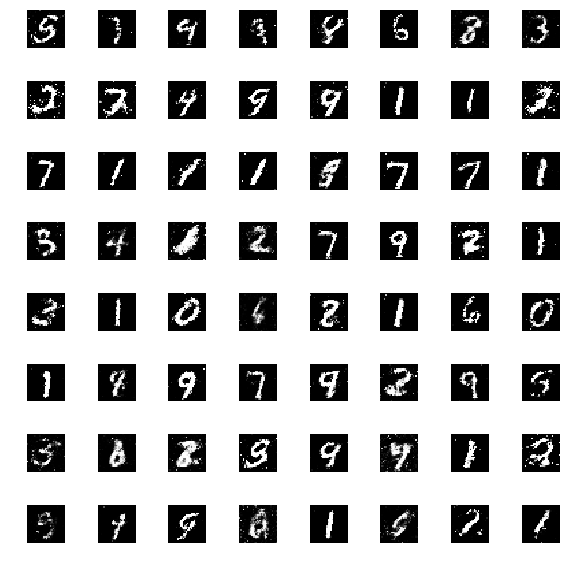

[Epoch 25/25] [Batch 0/938] [D loss: 0.44646793603897095] [G loss: 1.354767084121704]


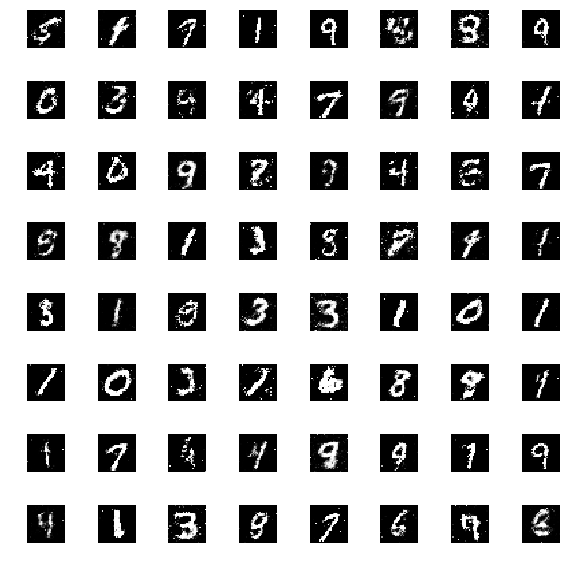

[Epoch 25/25] [Batch 100/938] [D loss: 0.49387648701667786] [G loss: 1.2388992309570312]


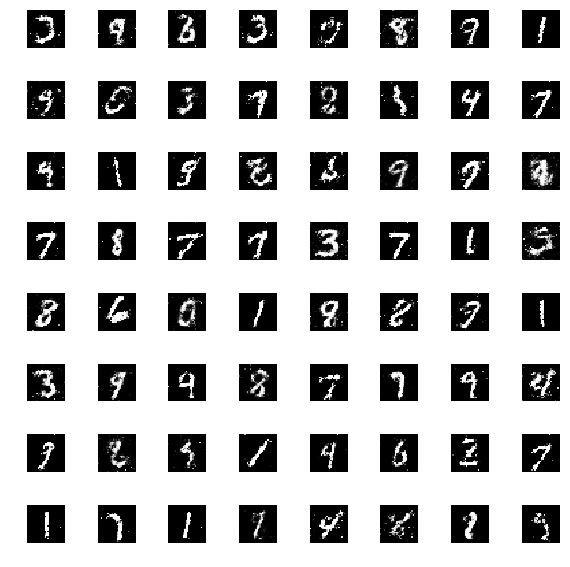

[Epoch 25/25] [Batch 200/938] [D loss: 0.5392866134643555] [G loss: 1.2803826332092285]


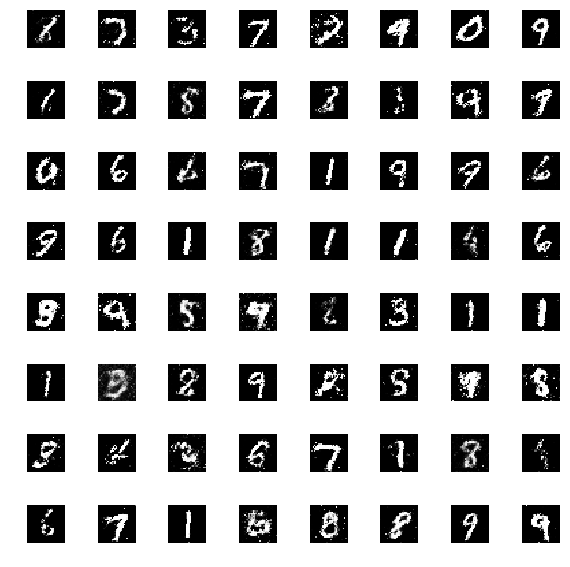

[Epoch 25/25] [Batch 300/938] [D loss: 0.5581990480422974] [G loss: 1.1912015676498413]


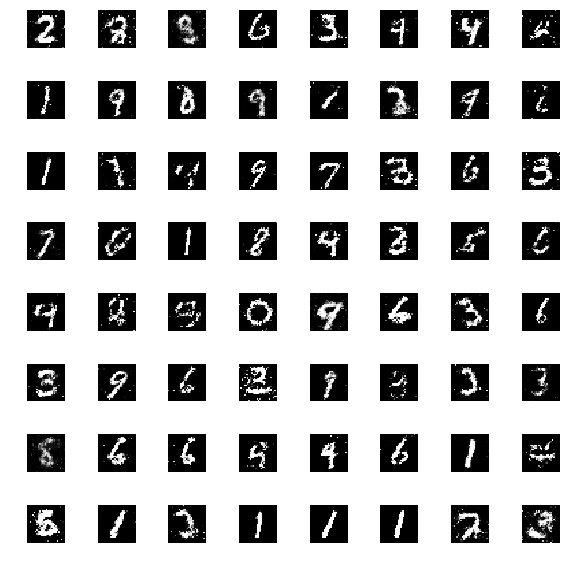

[Epoch 25/25] [Batch 400/938] [D loss: 0.6155992150306702] [G loss: 1.1185734272003174]


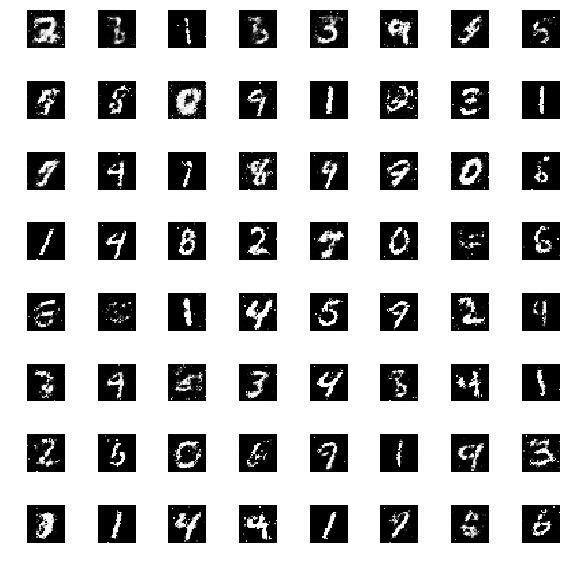

[Epoch 25/25] [Batch 500/938] [D loss: 0.5378735661506653] [G loss: 1.1730093955993652]


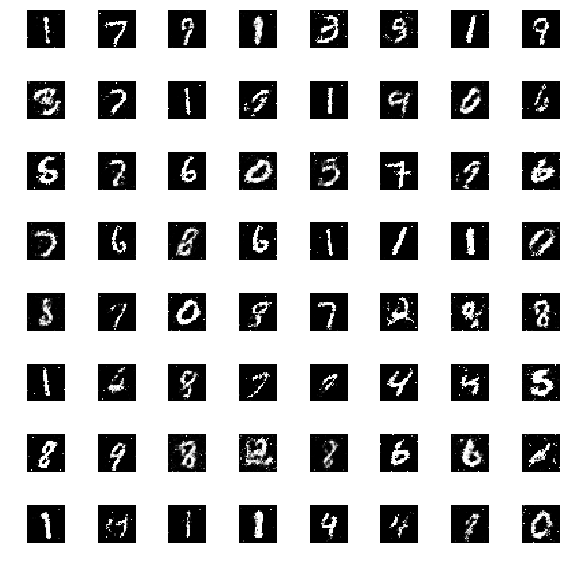

[Epoch 25/25] [Batch 600/938] [D loss: 0.5051890015602112] [G loss: 1.1183592081069946]


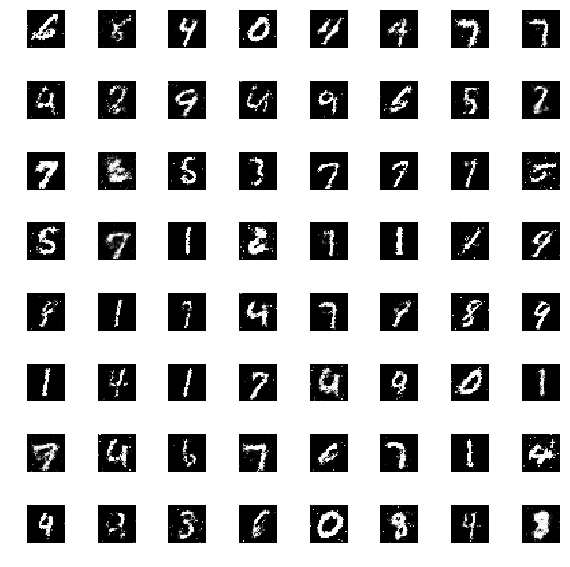

[Epoch 25/25] [Batch 700/938] [D loss: 0.5195253491401672] [G loss: 1.2844841480255127]


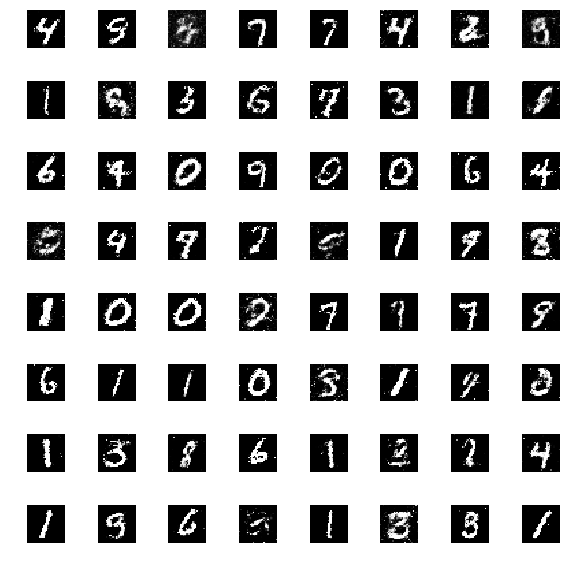

[Epoch 25/25] [Batch 800/938] [D loss: 0.4504292607307434] [G loss: 1.372089147567749]


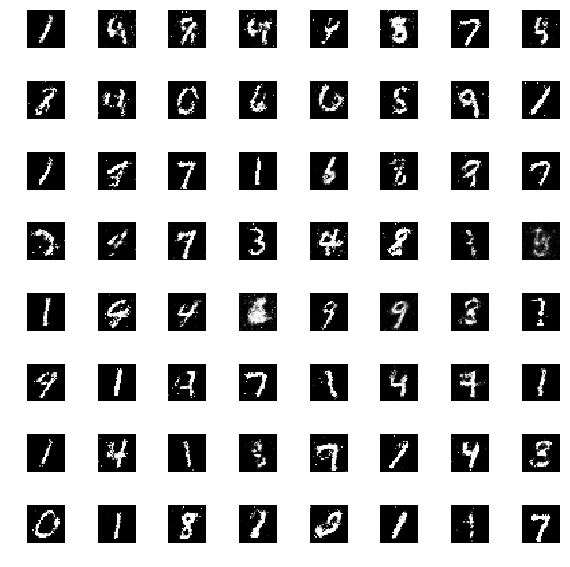

[Epoch 25/25] [Batch 900/938] [D loss: 0.5790640711784363] [G loss: 1.0004467964172363]


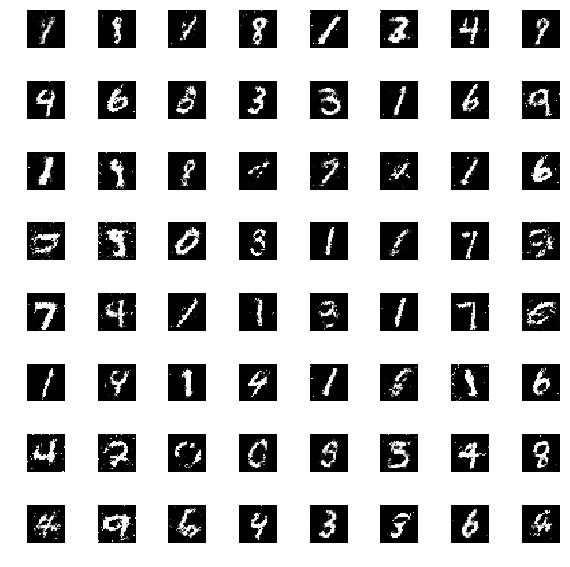

In [5]:
# 创建生成器和鉴别器
netG = Generator()
netD = Discriminator()

# 应用权重初始化
netG.apply(weights_init)
netD.apply(weights_init)

manual_seed = 886
torch.manual_seed(manual_seed)

beta1 = 0.5
lr = 0.0002
# 定义损失函数和优化器
criterion = nn.BCELoss()     # 无法使用？
#criterion = nn.CrossEntropyLoss()
optimizerD = torch.optim.Adam(netD.parameters(), lr=lr)
optimizerG = torch.optim.Adam(netG.parameters(), lr=lr)

DLoss=[]
GLoss=[]
# 模型训练
epochs = 10
for epoch in range(epochs):
    for i, (real_images,_) in enumerate(train_loader):
        train_size = real_images.shape[0]
        real_labels = torch.ones(train_size, 1)
        fake_labels = torch.zeros(train_size, 1)
        # 生成假图
        z = torch.randn(train_size, 100)
        fake_images = netG(z)
        # 更新鉴别器D
        netD.zero_grad()
        d_real = netD(real_images)
        d_real_loss = criterion(d_real, real_labels)

        d_fake = netD(fake_images)
        d_fake_loss = criterion(d_fake, fake_labels)
        d_real_loss.backward()
        d_fake_loss.backward()
        d_loss = (d_real_loss + d_fake_loss) / 2
        optimizerD.step()
        DLoss.append(d_loss)
        
        # 更新生成器G
        netG.zero_grad()
        fake_images = netG(z)
        d_fake = netD(fake_images)
        g_loss = criterion(d_fake, real_labels)
        g_loss.backward()
        optimizerG.step()
        GLoss.append(g_loss)
        
        if i % 100 == 0:
            print(f"[Epoch {epoch+1}/{epochs}] [Batch {i}/{len(train_loader)}] [D loss: {d_loss.item()}] [G loss: {g_loss.item()}]")
            show_images_all(fake_images)

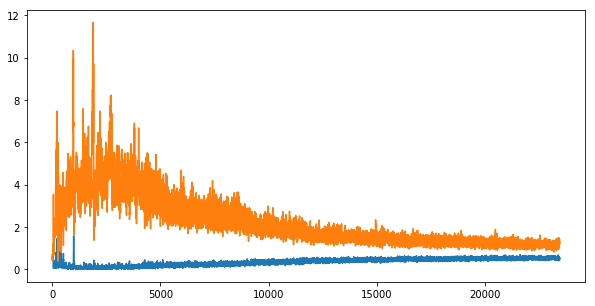

In [6]:
plt.figure(figsize=(10, 5))
plt.plot(DLoss, label='D Loss')
plt.plot(GLoss, label='G Loss')
plt.show()